In [1]:
%matplotlib inline
import httplib2
import oauth2
import urllib3
import types
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from causalinference import CausalModel
import httplib
import base64
import csv
from statsmodels.formula.api import ols
import statsmodels.api as sm
import math
from collections import defaultdict

data_analysis_file_name = './csv_files/jobs_2017_12_12_upwork_analysis_unitedstates_allskills.csv'
        
jobs_data = pd.read_csv(data_analysis_file_name)

job_categories = ['Design & Creative', 'Data Science & Analytics', 'Customer Service', 'Admin Support', 
                 'Accounting & Consulting', 'Writing', 'Web, Mobile & Software Dev', 'Translation', 
                 'Sales & Marketing', 'Legal', 'IT & Networking', 'Engineering & Architecture']

hourly_percentage_list = []

for category in job_categories:
    
    hourly_jobs = jobs_data[(jobs_data['job_type'] == 'hourly') & (jobs_data['job_category'] == category)]
    hourly_total = len(hourly_jobs)
    
    fixed_jobs = jobs_data[(jobs_data['job_type'] == 'fixed') & (jobs_data['job_category'] == category)]
    fixed_total = len(fixed_jobs)
    
    total_in_category = hourly_total + fixed_total
    
    hourly_percentage = float(hourly_total)/float(fixed_total) * 100

    hourly_percentage_list.append(hourly_percentage)
    
percentage_df = pd.DataFrame(hourly_percentage_list, index=job_categories, columns=['Percentage Hourly Assignments'])

percentage_df = percentage_df.sort_values('Percentage Hourly Assignments')


print "This is the number of jobs we obtained: {0}".format(len(jobs_data))


/home/ecf384/.conda/envs/eureka2/lib/python2.7/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


This is the number of jobs we obtained: 264714


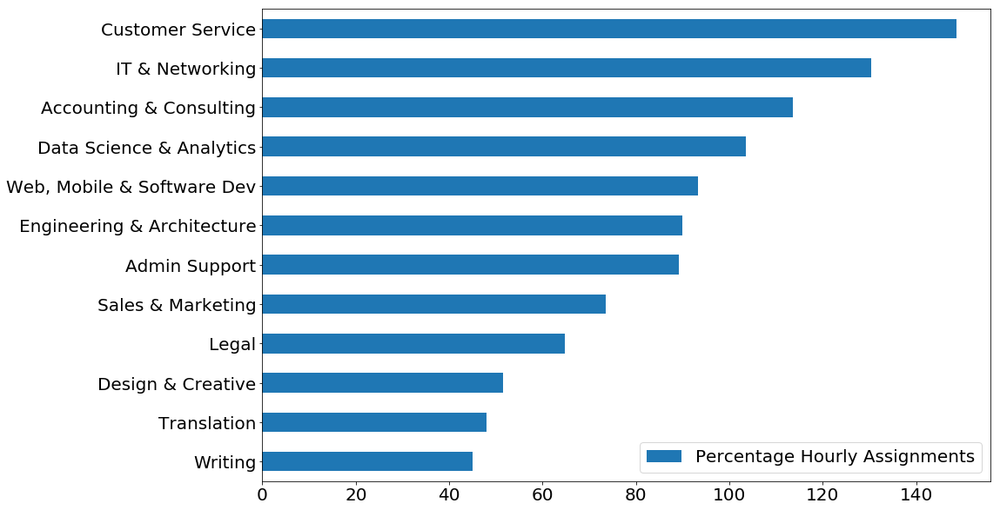

In [2]:
plt.rcParams.update({'font.size': 20})
percentage_df.plot(kind="barh", figsize=(15,10))

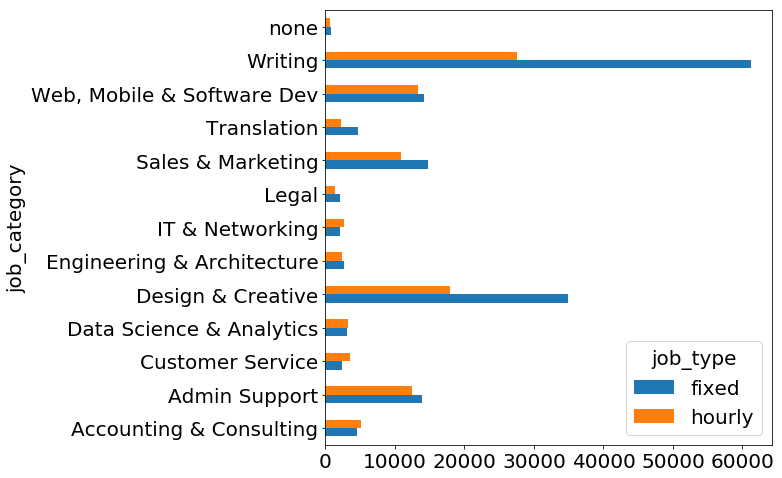

In [3]:

jobs_table = pd.crosstab(jobs_data['job_category'], jobs_data['job_type'])
jobs_table.plot(kind="barh", figsize=(8,8))

## Double checking - does number of jobs completed match up with their job history on Upwork?

In [8]:
for row in jobs_data.iterrows():
    print row[1]

 job_category            Translation
job_type                     hourly
worker_id       ~01293c7646ce6e3690
Name: 0, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01293c7646ce6e3690
Name: 1, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01293c7646ce6e3690
Name: 2, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01293c7646ce6e3690
Name: 3, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01532f4aeb4fca879d
Name: 4, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01532f4aeb4fca879d
Name: 5, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01532f4aeb4fca879d
Name: 6, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id 

Name: 272, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01e158fb059cfa6ff4
Name: 273, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01e158fb059cfa6ff4
Name: 274, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01e158fb059cfa6ff4
Name: 275, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01e158fb059cfa6ff4
Name: 276, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01e158fb059cfa6ff4
Name: 277, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01e158fb059cfa6ff4
Name: 278, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01e158fb059cfa6ff4
Name: 279, dtype: object
job_category                   none
job_type

job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7f1288eaeee0a1a
Name: 653, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7f1288eaeee0a1a
Name: 654, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7f1288eaeee0a1a
Name: 655, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7f1288eaeee0a1a
Name: 656, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7f1288eaeee0a1a
Name: 657, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7f1288eaeee0a1a
Name: 658, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7f1288eaeee0a1a
Name: 659, dtype: object
job_category      Design & Creative
job_type                      fix

job_category      Design & Creative
job_type                      fixed
worker_id       ~01602f39a3aa56f369
Name: 1269, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01602f39a3aa56f369
Name: 1270, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01602f39a3aa56f369
Name: 1271, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01602f39a3aa56f369
Name: 1272, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01602f39a3aa56f369
Name: 1273, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01602f39a3aa56f369
Name: 1274, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01602f39a3aa56f369
Name: 1275, dtype: object
job_category      Design & Creative
job_type                  

Name: 1924, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01065fd514eafd2769
Name: 1925, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01065fd514eafd2769
Name: 1926, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01065fd514eafd2769
Name: 1927, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01065fd514eafd2769
Name: 1928, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01065fd514eafd2769
Name: 1929, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01065fd514eafd2769
Name: 1930, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01065fd514eafd2769
Name: 1931, dtype: object
job_category      Design & Creative


job_category      Design & Creative
job_type                      fixed
worker_id       ~01c4cf1c988bddf412
Name: 2120, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c4cf1c988bddf412
Name: 2121, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c4cf1c988bddf412
Name: 2122, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c4cf1c988bddf412
Name: 2123, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c4cf1c988bddf412
Name: 2124, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c4cf1c988bddf412
Name: 2125, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~019880372e0f90e318
Name: 2126, dtype: object
job_category                Writing
job_type                  

Name: 2188, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e066fee04039128d
Name: 2189, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e066fee04039128d
Name: 2190, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e066fee04039128d
Name: 2191, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e066fee04039128d
Name: 2192, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e066fee04039128d
Name: 2193, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e066fee04039128d
Name: 2194, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e066fee04039128d
Name: 2195, dtype: object
job_category                Writing


Name: 2326, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f09c1f769c419a30
Name: 2327, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f09c1f769c419a30
Name: 2328, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f09c1f769c419a30
Name: 2329, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f09c1f769c419a30
Name: 2330, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f09c1f769c419a30
Name: 2331, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f09c1f769c419a30
Name: 2332, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f09c1f769c419a30
Name: 2333, dtype: object
job_category      Design & Creative


Name: 2779, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018d661150608761f4
Name: 2780, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018d661150608761f4
Name: 2781, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018d661150608761f4
Name: 2782, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018d661150608761f4
Name: 2783, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018d661150608761f4
Name: 2784, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018d661150608761f4
Name: 2785, dtype: object
job_category    Web, Mobile & Software Dev
j

job_category                Writing
job_type                      fixed
worker_id       ~01932a397342d41e4d
Name: 3293, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932a397342d41e4d
Name: 3294, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932a397342d41e4d
Name: 3295, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932a397342d41e4d
Name: 3296, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932a397342d41e4d
Name: 3297, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932a397342d41e4d
Name: 3298, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932a397342d41e4d
Name: 3299, dtype: object
job_category                Writing
job_type                  

Name: 3378, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010b6df46daea602ac
Name: 3379, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010b6df46daea602ac
Name: 3380, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010b6df46daea602ac
Name: 3381, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010b6df46daea602ac
Name: 3382, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010b6df46daea602ac
Name: 3383, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010b6df46daea602ac
Name: 3384, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010b6df46daea602ac
Name: 3385, dtype: object
job_category      Design & Creative


job_category      Design & Creative
job_type                     hourly
worker_id       ~010d8c710ee8660c9c
Name: 3572, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010d8c710ee8660c9c
Name: 3573, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010d8c710ee8660c9c
Name: 3574, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010d8c710ee8660c9c
Name: 3575, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010d8c710ee8660c9c
Name: 3576, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010d8c710ee8660c9c
Name: 3577, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010d8c710ee8660c9c
Name: 3578, dtype: object
job_category      Design & Creative
job_type                  

Name: 3757, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0127bbeeda7ed952fc
Name: 3758, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0127bbeeda7ed952fc
Name: 3759, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0127bbeeda7ed952fc
Name: 3760, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0127bbeeda7ed952fc
Name: 3761, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0127bbeeda7ed952fc
Name: 3762, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0127bbeeda7ed952fc
Name: 3763, dtype: object
job_category    Data Science & Analytics
job_type                           fixe

job_category                Writing
job_type                      fixed
worker_id       ~01aca3ae75f3007ca3
Name: 4072, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aca3ae75f3007ca3
Name: 4073, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aca3ae75f3007ca3
Name: 4074, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aca3ae75f3007ca3
Name: 4075, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aca3ae75f3007ca3
Name: 4076, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aca3ae75f3007ca3
Name: 4077, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aca3ae75f3007ca3
Name: 4078, dtype: object
job_category                Writing
job_type                  

job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01eb6dd65db7b05a27
Name: 4399, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01eb6dd65db7b05a27
Name: 4400, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01eb6dd65db7b05a27
Name: 4401, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01eb6dd65db7b05a27
Name: 4402, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01eb6dd65db7b05a27
Name: 4403, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01eb6dd65db7b05a27
Name: 4404, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01

job_category          Admin Support
job_type                      fixed
worker_id       ~01a85cf5ef136363ad
Name: 4539, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a85cf5ef136363ad
Name: 4540, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a85cf5ef136363ad
Name: 4541, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a85cf5ef136363ad
Name: 4542, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a85cf5ef136363ad
Name: 4543, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a85cf5ef136363ad
Name: 4544, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a85cf5ef136363ad
Name: 4545, dtype: object
job_category          Admin Support
job_type                  

Name: 4600, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0116f60aeda40c7fb8
Name: 4601, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0116f60aeda40c7fb8
Name: 4602, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0116f60aeda40c7fb8
Name: 4603, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0116f60aeda40c7fb8
Name: 4604, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0116f60aeda40c7fb8
Name: 4605, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0116f60aeda40c7fb8
Name: 4606, dtype: object
job_category    Engineering & Architecture
j

job_category                Writing
job_type                      fixed
worker_id       ~01697d0f599c9beb82
Name: 4731, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01697d0f599c9beb82
Name: 4732, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01697d0f599c9beb82
Name: 4733, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01697d0f599c9beb82
Name: 4734, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01697d0f599c9beb82
Name: 4735, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01697d0f599c9beb82
Name: 4736, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb11da79a656427d
Name: 4737, dtype: object
job_category        IT & Networking
job_type                  

job_category                Writing
job_type                      fixed
worker_id       ~010f90d89aa2c70956
Name: 4843, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f90d89aa2c70956
Name: 4844, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f90d89aa2c70956
Name: 4845, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f90d89aa2c70956
Name: 4846, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f90d89aa2c70956
Name: 4847, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f90d89aa2c70956
Name: 4848, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f90d89aa2c70956
Name: 4849, dtype: object
job_category                Writing
job_type                  

Name: 4979, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012a31b03199118937
Name: 4980, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012a31b03199118937
Name: 4981, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012a31b03199118937
Name: 4982, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012a31b03199118937
Name: 4983, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012a31b03199118937
Name: 4984, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012a31b03199118937
Name: 4985, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012a31b03199118937
Name: 4986, dtype: object
job_category                Writing


job_category      Design & Creative
job_type                      fixed
worker_id       ~011add88e13350d529
Name: 5088, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011add88e13350d529
Name: 5089, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011add88e13350d529
Name: 5090, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011add88e13350d529
Name: 5091, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~011e0e9cacf66e946d
Name: 5092, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~011e0e9cacf66e946d
Name: 5093, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~011e0e9cacf66e946d
Name: 5094, dtype: object
job_category    Accounting

job_category                Writing
job_type                      fixed
worker_id       ~0153ecc2d963d7ba59
Name: 5317, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0153ecc2d963d7ba59
Name: 5318, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0153ecc2d963d7ba59
Name: 5319, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0153ecc2d963d7ba59
Name: 5320, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0153ecc2d963d7ba59
Name: 5321, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01007c4cc0a06438f4
Name: 5322, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01007c4cc0a06438f4
Name: 5323, dtype: object
job_category      Design & Creative
job_type                  

Name: 5408, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01a46062abdbfd0f60
Name: 5409, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01a46062abdbfd0f60
Name: 5410, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01a46062abdbfd0f60
Name: 5411, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01a46062abdbfd0f60
Name: 5412, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01a46062abdbfd0f60
Name: 5413, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01a46062abdbfd0f60
Name: 5414, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id         

job_category          Admin Support
job_type                      fixed
worker_id       ~01931da2b73f138a2b
Name: 5709, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01931da2b73f138a2b
Name: 5710, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01931da2b73f138a2b
Name: 5711, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01931da2b73f138a2b
Name: 5712, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01931da2b73f138a2b
Name: 5713, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01931da2b73f138a2b
Name: 5714, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01931da2b73f138a2b
Name: 5715, dtype: object
job_category          Admin Support
job_type                  

Name: 5893, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ccfbbd6370706f4c
Name: 5894, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ccfbbd6370706f4c
Name: 5895, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ccfbbd6370706f4c
Name: 5896, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ccfbbd6370706f4c
Name: 5897, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ccfbbd6370706f4c
Name: 5898, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ccfbbd6370706f4c
Name: 5899, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ccfbbd6370706f4c
Name: 5900, dtype: object
job_category                Writing


Name: 5963, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01470aa373764f9f03
Name: 5964, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01470aa373764f9f03
Name: 5965, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01470aa373764f9f03
Name: 5966, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01470aa373764f9f03
Name: 5967, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01470aa373764f9f03
Name: 5968, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01470aa373764f9f03
Name: 5969, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01470aa373764f9f03
Name: 5970, dtype: object
job_category                Writing


job_category                Writing
job_type                      fixed
worker_id       ~01b38f0e22509b5bcc
Name: 6523, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b38f0e22509b5bcc
Name: 6524, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b38f0e22509b5bcc
Name: 6525, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b38f0e22509b5bcc
Name: 6526, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b38f0e22509b5bcc
Name: 6527, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b38f0e22509b5bcc
Name: 6528, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b38f0e22509b5bcc
Name: 6529, dtype: object
job_category                Writing
job_type                  

Name: 6790, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a36d8e177b49c36f
Name: 6791, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a36d8e177b49c36f
Name: 6792, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a36d8e177b49c36f
Name: 6793, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a36d8e177b49c36f
Name: 6794, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a36d8e177b49c36f
Name: 6795, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a36d8e177b49c36f
Name: 6796, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a36d8e177b49c36f
Name: 6797, dtype: object
job_category    Web, Mobile & Softwa

job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce6262861b2256cf
Name: 6997, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce6262861b2256cf
Name: 6998, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce6262861b2256cf
Name: 6999, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce6262861b2256cf
Name: 7000, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce6262861b2256cf
Name: 7001, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce6262861b2256cf
Name: 7002, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce6262861b2256cf
Name: 7003, dtype: object
job_category      Design & Creative
job_type                  

Name: 7203, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01d8a2ab340c272428
Name: 7204, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01d8a2ab340c272428
Name: 7205, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01d8a2ab340c272428
Name: 7206, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01d8a2ab340c272428
Name: 7207, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01d8a2ab340c272428
Name: 7208, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01d8a2ab340c272428
Name: 7209, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01d8a2ab340c272428
Name: 7210, dtype: object
job_category    Data Science & Analy

Name: 7482, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fed9e14ffb33d64
Name: 7483, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fed9e14ffb33d64
Name: 7484, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fed9e14ffb33d64
Name: 7485, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fed9e14ffb33d64
Name: 7486, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fed9e14ffb33d64
Name: 7487, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fed9e14ffb33d64
Name: 7488, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fed9e14ffb33d64
Name: 7489, dtype: object
job_category      Sales & Marketing


job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5754a9e7321eb96
Name: 7606, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5754a9e7321eb96
Name: 7607, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5754a9e7321eb96
Name: 7608, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5754a9e7321eb96
Name: 7609, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5754a9e7321eb96
Name: 7610, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5754a9e7321eb96
Name: 7611, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5754a9e7321eb96
Name: 7612, dtype: object
job_category    Engineering & Architecture
job_type           

Name: 7705, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb783779577f2bba
Name: 7706, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb783779577f2bba
Name: 7707, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb783779577f2bba
Name: 7708, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb783779577f2bba
Name: 7709, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb783779577f2bba
Name: 7710, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb783779577f2bba
Name: 7711, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01fb783779577f2bba
Name: 7712, dtype: object
job_category        IT & Networking


job_category      Design & Creative
job_type                      fixed
worker_id       ~01a7da762d52d9eb07
Name: 7832, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a7da762d52d9eb07
Name: 7833, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a7da762d52d9eb07
Name: 7834, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a7da762d52d9eb07
Name: 7835, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a7da762d52d9eb07
Name: 7836, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a7da762d52d9eb07
Name: 7837, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a7da762d52d9eb07
Name: 7838, dtype: object
job_category      Design & Creative
job_type                  

Name: 7934, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e50ac6c6f94e7275
Name: 7935, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e50ac6c6f94e7275
Name: 7936, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a5aab16066e99d74
Name: 7937, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a5aab16066e99d74
Name: 7938, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a5aab16066e99d74
Name: 7939, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a5aab16066e99d74
Name: 7940, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a5aab16066e99d74
Name: 7941, dtype: object
job_category                Writing


Name: 8130, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e81a53f2fbe7dd12
Name: 8131, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e81a53f2fbe7dd12
Name: 8132, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e81a53f2fbe7dd12
Name: 8133, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e81a53f2fbe7dd12
Name: 8134, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e81a53f2fbe7dd12
Name: 8135, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e81a53f2fbe7dd12
Name: 8136, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e81a53f2fbe7dd12
Name: 8137, dtype: object
job_category                Writing


Name: 8219, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e81a53f2fbe7dd12
Name: 8220, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e81a53f2fbe7dd12
Name: 8221, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e81a53f2fbe7dd12
Name: 8222, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e81a53f2fbe7dd12
Name: 8223, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e81a53f2fbe7dd12
Name: 8224, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e81a53f2fbe7dd12
Name: 8225, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e81a53f2fbe7dd12
Name: 8226, dtype: object
job_category                Writing


job_category                Writing
job_type                      fixed
worker_id       ~018720f7552ca3c597
Name: 8331, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018720f7552ca3c597
Name: 8332, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018720f7552ca3c597
Name: 8333, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018720f7552ca3c597
Name: 8334, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018720f7552ca3c597
Name: 8335, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018720f7552ca3c597
Name: 8336, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018720f7552ca3c597
Name: 8337, dtype: object
job_category                Writing
job_type                  

Name: 8560, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8561, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8562, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8563, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8564, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8565, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8566, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8567, dtype: object
job_category      Design & Creative


job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8636, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8637, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8638, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8639, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8640, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8641, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f9a7c6c8f7e2aaf0
Name: 8642, dtype: object
job_category      Design & Creative
job_type                  

Name: 8762, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0194ea54bbbb93ed14
Name: 8763, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0194ea54bbbb93ed14
Name: 8764, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0194ea54bbbb93ed14
Name: 8765, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0194ea54bbbb93ed14
Name: 8766, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0194ea54bbbb93ed14
Name: 8767, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0194ea54bbbb93ed14
Name: 8768, dtype: object
job_category    Web, Mobile & Software Dev
j

Name: 8882, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aec0df566058539b
Name: 8883, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aec0df566058539b
Name: 8884, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aec0df566058539b
Name: 8885, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aec0df566058539b
Name: 8886, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01767129f46b994936
Name: 8887, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01767129f46b994936
Name: 8888, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01767129f46b994936
Name: 8889, dtype: object
job_category      Design & Creative


Name: 9135, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5090880473e5e06
Name: 9136, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5090880473e5e06
Name: 9137, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5090880473e5e06
Name: 9138, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5090880473e5e06
Name: 9139, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5090880473e5e06
Name: 9140, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5090880473e5e06
Name: 9141, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a5090880473e5e06
Name: 9142, dtype: object
job_category      Design & Creative


job_category      Design & Creative
job_type                     hourly
worker_id       ~018059eeb6741c7805
Name: 9333, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018059eeb6741c7805
Name: 9334, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018059eeb6741c7805
Name: 9335, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018059eeb6741c7805
Name: 9336, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018059eeb6741c7805
Name: 9337, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018059eeb6741c7805
Name: 9338, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018059eeb6741c7805
Name: 9339, dtype: object
job_category      Design & Creative
job_type                  

job_category                Writing
job_type                      fixed
worker_id       ~01bd05850a92b37190
Name: 9495, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd05850a92b37190
Name: 9496, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd05850a92b37190
Name: 9497, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd05850a92b37190
Name: 9498, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd05850a92b37190
Name: 9499, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd05850a92b37190
Name: 9500, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd05850a92b37190
Name: 9501, dtype: object
job_category                Writing
job_type                  

Name: 10008, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0150d8b2a0a0f9c9f1
Name: 10009, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0150d8b2a0a0f9c9f1
Name: 10010, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0150d8b2a0a0f9c9f1
Name: 10011, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0150d8b2a0a0f9c9f1
Name: 10012, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0150d8b2a0a0f9c9f1
Name: 10013, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0150d8b2a0a0f9c9f1
Name: 10014, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0150d8b2a0a0f9c9f1
Name: 10015, dtype: object
job_category                

Name: 11334, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017857377bd8c6e2a2
Name: 11335, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017857377bd8c6e2a2
Name: 11336, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017857377bd8c6e2a2
Name: 11337, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017857377bd8c6e2a2
Name: 11338, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017857377bd8c6e2a2
Name: 11339, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017857377bd8c6e2a2
Name: 11340, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017857377bd8c6e2a2
Name: 11341, dtype: object
job_category       Customer 

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01a6bac94c1a1f0548
Name: 11802, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0132b0a7fc2cc2e5ee
Name: 11803, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0132b0a7fc2cc2e5ee
Name: 11804, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0132b0a7fc2cc2e5ee
Name: 11805, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0132b0a7fc2cc2e5ee
Name: 11806, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0132b0a7fc2cc2e5ee
Name: 11807, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0132b0a7fc2cc2e5ee
Name: 11808, dtype: object
job_category      Design & Creativ

Name: 12186, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01961bd0939556dc8a
Name: 12187, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01961bd0939556dc8a
Name: 12188, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01961bd0939556dc8a
Name: 12189, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01961bd0939556dc8a
Name: 12190, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01961bd0939556dc8a
Name: 12191, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01961bd0939556dc8a
Name: 12192, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~018302941cf04cec5d
Name: 12193, dtype: object
job_category                

Name: 12352, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01c6b3f9f40e0493a7
Name: 12353, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01c6b3f9f40e0493a7
Name: 12354, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01c6b3f9f40e0493a7
Name: 12355, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01c6b3f9f40e0493a7
Name: 12356, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01c6b3f9f40e0493a7
Name: 12357, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01c6b3f9f40e0493a7
Name: 12358, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01c6b3f9f40e0493a7
Name: 12359, dtype: object
job_category                

Name: 12773, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fdff256a10e85e7c
Name: 12774, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fdff256a10e85e7c
Name: 12775, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fdff256a10e85e7c
Name: 12776, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fdff256a10e85e7c
Name: 12777, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fdff256a10e85e7c
Name: 12778, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fdff256a10e85e7c
Name: 12779, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fdff256a10e85e7c
Name: 12780, dtype: object
job_category                

Name: 13474, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016f70795a131fd673
Name: 13475, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016f70795a131fd673
Name: 13476, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016f70795a131fd673
Name: 13477, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016f70795a131fd673
Name: 13478, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016f70795a131fd673
Name: 13479, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016f70795a131fd673
Name: 13480, dtype: object
job_category    Data Science & Analytics
job_type                        

Name: 13611, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016e3683f125de56fc
Name: 13612, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016e3683f125de56fc
Name: 13613, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016e3683f125de56fc
Name: 13614, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016e3683f125de56fc
Name: 13615, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016e3683f125de56fc
Name: 13616, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016e3683f125de56fc
Name: 13617, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016e3683f125de56fc
Name: 13618, dtype: object
job_category          Admin 

Name: 14592, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fa06d6e5d3344b4d
Name: 14593, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fa06d6e5d3344b4d
Name: 14594, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fa06d6e5d3344b4d
Name: 14595, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fa06d6e5d3344b4d
Name: 14596, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fa06d6e5d3344b4d
Name: 14597, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fa06d6e5d3344b4d
Name: 14598, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0170a3261970891855
Name: 14599, dtype: object
job_category    

Name: 15357, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01e8430e9ceafbb5f6
Name: 15358, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01e8430e9ceafbb5f6
Name: 15359, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01e8430e9ceafbb5f6
Name: 15360, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01e8430e9ceafbb5f6
Name: 15361, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01e8430e9ceafbb5f6
Name: 15362, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01e8430e9ceafbb5f6
Name: 15363, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01e8430e9ceafbb5f6
Name: 15364, dtype: object
job_category            Tran

Name: 15739, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0193240d95fd6bf9d3
Name: 15740, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0193240d95fd6bf9d3
Name: 15741, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0193240d95fd6bf9d3
Name: 15742, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0193240d95fd6bf9d3
Name: 15743, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0193240d95fd6bf9d3
Name: 15744, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0193240d95fd6bf9d3
Name: 15745, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0193240d95fd6bf9d3
Name: 15746, dtype: object
job_category      Sales & Ma

Name: 15837, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01673d9fe468c7c7bf
Name: 15838, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01673d9fe468c7c7bf
Name: 15839, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01673d9fe468c7c7bf
Name: 15840, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01673d9fe468c7c7bf
Name: 15841, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01673d9fe468c7c7bf
Name: 15842, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01673d9fe468c7c7bf
Name: 15843, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01673d9fe468c7c7bf
Name: 15844, dtype: object
job_category      Design & C

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155f16f2fe2c01e32
Name: 16500, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155f16f2fe2c01e32
Name: 16501, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155f16f2fe2c01e32
Name: 16502, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155f16f2fe2c01e32
Name: 16503, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155f16f2fe2c01e32
Name: 16504, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155f16f2fe2c01e32
Name: 16505, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155f16f2fe2c01e32
Name: 16506, dtype: object
job_category      Sales & Marketing
job_type           

Name: 16737, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012fd0053e9c80b1aa
Name: 16738, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012fd0053e9c80b1aa
Name: 16739, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012fd0053e9c80b1aa
Name: 16740, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012fd0053e9c80b1aa
Name: 16741, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012fd0053e9c80b1aa
Name: 16742, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012fd0053e9c80b1aa
Name: 16743, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012fd0053e9c80b1aa
Name: 16744, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~01182f9f9f42693b9a
Name: 17025, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01182f9f9f42693b9a
Name: 17026, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01182f9f9f42693b9a
Name: 17027, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01182f9f9f42693b9a
Name: 17028, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01182f9f9f42693b9a
Name: 17029, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01182f9f9f42693b9a
Name: 17030, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01182f9f9f42693b9a
Name: 17031, dtype: object
job_category                Writing
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~014c59ebd7e252d1e8
Name: 17302, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c59ebd7e252d1e8
Name: 17303, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c59ebd7e252d1e8
Name: 17304, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c59ebd7e252d1e8
Name: 17305, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c59ebd7e252d1e8
Name: 17306, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c59ebd7e252d1e8
Name: 17307, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c59ebd7e252d1e8
Name: 17308, dtype: object
job_category                Writing
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~01b205bdd8bab65fb2
Name: 18003, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b205bdd8bab65fb2
Name: 18004, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b205bdd8bab65fb2
Name: 18005, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b205bdd8bab65fb2
Name: 18006, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b205bdd8bab65fb2
Name: 18007, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b205bdd8bab65fb2
Name: 18008, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b205bdd8bab65fb2
Name: 18009, dtype: object
job_category                Writing
job_type           

Name: 18185, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0116942b59f43d70e0
Name: 18186, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0116942b59f43d70e0
Name: 18187, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0116942b59f43d70e0
Name: 18188, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0116942b59f43d70e0
Name: 18189, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0116942b59f43d70e0
Name: 18190, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0116942b59f43d70e0
Name: 18191, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id  

Name: 18997, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0166060d8c7f18ddd4
Name: 18998, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0166060d8c7f18ddd4
Name: 18999, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0166060d8c7f18ddd4
Name: 19000, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0166060d8c7f18ddd4
Name: 19001, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0166060d8c7f18ddd4
Name: 19002, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0166060d8c7f18ddd4
Name: 19003, dtype: object
job_category    Web, Mobile & Softwar

Name: 19765, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cacc62906603de43
Name: 19766, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cacc62906603de43
Name: 19767, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cacc62906603de43
Name: 19768, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cacc62906603de43
Name: 19769, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cacc62906603de43
Name: 19770, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cacc62906603de43
Name: 19771, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cacc62906603de43
Name: 19772, dtype: object
job_category      Design & C

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01819c2a433c385fcc
Name: 19841, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01819c2a433c385fcc
Name: 19842, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01819c2a433c385fcc
Name: 19843, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01819c2a433c385fcc
Name: 19844, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01819c2a433c385fcc
Name: 19845, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01819c2a433c385fcc
Name: 19846, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01819c2a433c385fcc
Name: 19847, dtype: object
job_category      Sales & Marketing
job_type           

job_category      Design & Creative
job_type                     hourly
worker_id       ~01472454d18d7679c0
Name: 19957, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01472454d18d7679c0
Name: 19958, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01472454d18d7679c0
Name: 19959, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01472454d18d7679c0
Name: 19960, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01472454d18d7679c0
Name: 19961, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01472454d18d7679c0
Name: 19962, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01472454d18d7679c0
Name: 19963, dtype: object
job_category      Design & Creative
job_type           

job_category      Design & Creative
job_type                      fixed
worker_id       ~01472454d18d7679c0
Name: 20117, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01472454d18d7679c0
Name: 20118, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01472454d18d7679c0
Name: 20119, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01472454d18d7679c0
Name: 20120, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01472454d18d7679c0
Name: 20121, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01472454d18d7679c0
Name: 20122, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01472454d18d7679c0
Name: 20123, dtype: object
job_category      Design & Creative
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~01cf02bc28810ec17d
Name: 20246, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cf02bc28810ec17d
Name: 20247, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cf02bc28810ec17d
Name: 20248, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cf02bc28810ec17d
Name: 20249, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cf02bc28810ec17d
Name: 20250, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cf02bc28810ec17d
Name: 20251, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cf02bc28810ec17d
Name: 20252, dtype: object
job_category                Writing
job_type           

Name: 20663, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01806fde3aeee7ec25
Name: 20664, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01806fde3aeee7ec25
Name: 20665, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01806fde3aeee7ec25
Name: 20666, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01806fde3aeee7ec25
Name: 20667, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01806fde3aeee7ec25
Name: 20668, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01806fde3aeee7ec25
Name: 20669, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01806fde3aeee7ec25
Name: 20670, dtype: object
job_category                

Name: 21148, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0162427de41ae98626
Name: 21149, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01759a39fcdf0e7bd2
Name: 21150, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01759a39fcdf0e7bd2
Name: 21151, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01759a39fcdf0e7bd2
Name: 21152, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01759a39fcdf0e7bd2
Name: 21153, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01759a39fcdf0e7bd2
Name: 21154, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01759a39fcdf0e7bd2
Name: 21155, dtype: object
job_category 

Name: 21402, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a73dda6290022799
Name: 21403, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a73dda6290022799
Name: 21404, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a73dda6290022799
Name: 21405, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a73dda6290022799
Name: 21406, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a73dda6290022799
Name: 21407, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a73dda6290022799
Name: 21408, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a73dda6290022799
Name: 21409, dtype: object
job_category                

Name: 21615, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014ee56c8515e2d0ef
Name: 21616, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014ee56c8515e2d0ef
Name: 21617, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014ee56c8515e2d0ef
Name: 21618, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014ee56c8515e2d0ef
Name: 21619, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014ee56c8515e2d0ef
Name: 21620, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014ee56c8515e2d0ef
Name: 21621, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id  

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1a6997fb4be3259
Name: 21691, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1a6997fb4be3259
Name: 21692, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1a6997fb4be3259
Name: 21693, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01edd50b5d599fb88f
Name: 21694, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01edd50b5d599fb88f
Name: 21695, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01edd50b5d599fb88f
Name: 21696, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01edd50b5d599fb88f
Name: 21697, dtype: object
job_category                Writing
job_type           

job_category          Admin Support
job_type                     hourly
worker_id       ~017550dcffadf15c13
Name: 21861, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017550dcffadf15c13
Name: 21862, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017550dcffadf15c13
Name: 21863, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017550dcffadf15c13
Name: 21864, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017550dcffadf15c13
Name: 21865, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017550dcffadf15c13
Name: 21866, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017550dcffadf15c13
Name: 21867, dtype: object
job_category          Admin Support
job_type           

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0104c6879b96de90a1
Name: 22292, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0104c6879b96de90a1
Name: 22293, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0104c6879b96de90a1
Name: 22294, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0104c6879b96de90a1
Name: 22295, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0104c6879b96de90a1
Name: 22296, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0104c6879b96de90a1
Name: 22297, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0104c6879b96de90a1
Name: 22298, dtype: object
job_category      Sales & Marketing
job_type           

Name: 22819, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01677de664d1559fe5
Name: 22820, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01677de664d1559fe5
Name: 22821, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01677de664d1559fe5
Name: 22822, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01677de664d1559fe5
Name: 22823, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01677de664d1559fe5
Name: 22824, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01677de664d1559fe5
Name: 22825, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01677de664d1559fe5
Name: 22826, dtype: object
job_category      Design & C

Name: 23403, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0199b5e0321c30b4a4
Name: 23404, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0199b5e0321c30b4a4
Name: 23405, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0199b5e0321c30b4a4
Name: 23406, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0199b5e0321c30b4a4
Name: 23407, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0199b5e0321c30b4a4
Name: 23408, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0199b5e0321c30b4a4
Name: 23409, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0199b5e0321c30b4a4
Name: 23410, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~0104cdc743805a8f07
Name: 23811, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0104cdc743805a8f07
Name: 23812, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0104cdc743805a8f07
Name: 23813, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0104cdc743805a8f07
Name: 23814, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0104cdc743805a8f07
Name: 23815, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0104cdc743805a8f07
Name: 23816, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0104cdc743805a8f07
Name: 23817, dtype: object
job_category                Writing
job_type           

Name: 24487, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d5af0fabb702b796
Name: 24488, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d5af0fabb702b796
Name: 24489, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d5af0fabb702b796
Name: 24490, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d5af0fabb702b796
Name: 24491, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d5af0fabb702b796
Name: 24492, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d5af0fabb702b796
Name: 24493, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d5af0fabb702b796
Name: 24494, dtype: object
job_category                

job_category      Design & Creative
job_type                     hourly
worker_id       ~010446ea4ac02d2a20
Name: 24584, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~010446ea4ac02d2a20
Name: 24585, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010446ea4ac02d2a20
Name: 24586, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010446ea4ac02d2a20
Name: 24587, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010446ea4ac02d2a20
Name: 24588, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010446ea4ac02d2a20
Name: 24589, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010446ea4ac02d2a20
Name: 24590, dtype: object
job_category      Design & Creative
job_type           

job_category      Design & Creative
job_type                     hourly
worker_id       ~01fe52ddb5a8128039
Name: 24839, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fe52ddb5a8128039
Name: 24840, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fe52ddb5a8128039
Name: 24841, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fe52ddb5a8128039
Name: 24842, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fe52ddb5a8128039
Name: 24843, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fe52ddb5a8128039
Name: 24844, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fe52ddb5a8128039
Name: 24845, dtype: object
job_category      Design & Creative
job_type           

job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba47aea85649b9bc
Name: 25565, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba47aea85649b9bc
Name: 25566, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba47aea85649b9bc
Name: 25567, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba47aea85649b9bc
Name: 25568, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba47aea85649b9bc
Name: 25569, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba47aea85649b9bc
Name: 25570, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba47aea85649b9bc
Name: 25571, dtype: object
job_category      Design & Creative
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~01a9b6bd9e48bf5ae7
Name: 25658, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9b6bd9e48bf5ae7
Name: 25659, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9b6bd9e48bf5ae7
Name: 25660, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9b6bd9e48bf5ae7
Name: 25661, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9b6bd9e48bf5ae7
Name: 25662, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9b6bd9e48bf5ae7
Name: 25663, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9b6bd9e48bf5ae7
Name: 25664, dtype: object
job_category                Writing
job_type           

Name: 26489, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012d05f1df0a97a37d
Name: 26490, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012d05f1df0a97a37d
Name: 26491, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012d05f1df0a97a37d
Name: 26492, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012d05f1df0a97a37d
Name: 26493, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012d05f1df0a97a37d
Name: 26494, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012d05f1df0a97a37d
Name: 26495, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012d05f1df0a97a37d
Name: 26496, dtype: object
job_category                

Name: 26620, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019d8fa6892adccb82
Name: 26621, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019d8fa6892adccb82
Name: 26622, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019d8fa6892adccb82
Name: 26623, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019d8fa6892adccb82
Name: 26624, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019d8fa6892adccb82
Name: 26625, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019d8fa6892adccb82
Name: 26626, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019d8fa6892adccb82
Name: 26627, dtype: object
job_category      Sales & Ma

job_category      Design & Creative
job_type                      fixed
worker_id       ~018afa5d4add5b430a
Name: 27001, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018afa5d4add5b430a
Name: 27002, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018afa5d4add5b430a
Name: 27003, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c77923fb09180ad3
Name: 27004, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c77923fb09180ad3
Name: 27005, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c77923fb09180ad3
Name: 27006, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c77923fb09180ad3
Name: 27007, dtype: object
job_category                Writing
job_type           

Name: 27124, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013ff65c51111cece6
Name: 27125, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013ff65c51111cece6
Name: 27126, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013ff65c51111cece6
Name: 27127, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013ff65c51111cece6
Name: 27128, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013ff65c51111cece6
Name: 27129, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013ff65c51111cece6
Name: 27130, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013ff65c51111cece6
Name: 27131, dtype: object
job_category                

Name: 27411, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fce57dfd23c4aba
Name: 27412, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fce57dfd23c4aba
Name: 27413, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fce57dfd23c4aba
Name: 27414, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fce57dfd23c4aba
Name: 27415, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fce57dfd23c4aba
Name: 27416, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fce57dfd23c4aba
Name: 27417, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fce57dfd23c4aba
Name: 27418, dtype: object
job_category                

job_category                Writing
job_type                      fixed
worker_id       ~01bf3364057df97bfa
Name: 27653, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf3364057df97bfa
Name: 27654, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf3364057df97bfa
Name: 27655, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf3364057df97bfa
Name: 27656, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf3364057df97bfa
Name: 27657, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf3364057df97bfa
Name: 27658, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~012ba2b2314ca7e3bc
Name: 27659, dtype: object
job_category    Data Science & Analytics

job_category                   none
job_type                     hourly
worker_id       ~01f37956201c6c03bf
Name: 27765, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~01f37956201c6c03bf
Name: 27766, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01f37956201c6c03bf
Name: 27767, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01f37956201c6c03bf
Name: 27768, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01f37956201c6c03bf
Name: 27769, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01f37956201c6c03bf
Name: 27770, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~01f37956201c6c03bf
Name: 27771, dtype: object
job_category                   none
job_type           

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016bab4077cb085f6e
Name: 28049, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016bab4077cb085f6e
Name: 28050, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016bab4077cb085f6e
Name: 28051, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016bab4077cb085f6e
Name: 28052, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016bab4077cb085f6e
Name: 28053, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016bab4077cb085f6e
Name: 28054, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~014651c3748a973e53
Name: 28312, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~014651c3748a973e53
Name: 28313, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~014651c3748a973e53
Name: 28314, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~014651c3748a973e53
Name: 28315, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~014651c3748a973e53
Name: 28316, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~014651c3748a973e53
Name: 28317, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~014651c3748a973e53
Name: 28318, dtype: object
job_category      Sales & Marketing
job_type           

Name: 28439, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01a9472ee059192193
Name: 28440, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01a9472ee059192193
Name: 28441, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01a9472ee059192193
Name: 28442, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c58107c2fd32ed1d
Name: 28443, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c58107c2fd32ed1d
Name: 28444, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c58107c2fd32ed1d
Name: 28445, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c58107c2fd32ed1d
Name: 28446, dtype: object
job_category                

Name: 29183, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013d2a19c739e91053
Name: 29184, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013d2a19c739e91053
Name: 29185, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013d2a19c739e91053
Name: 29186, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013d2a19c739e91053
Name: 29187, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013d2a19c739e91053
Name: 29188, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013d2a19c739e91053
Name: 29189, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~013d2a19c739e91053
Name: 29190, dtype: object
job_category                

Name: 29693, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a081759db364a6f
Name: 29694, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a081759db364a6f
Name: 29695, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a081759db364a6f
Name: 29696, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01bbc141e6c8a0f9d8
Name: 29697, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01bbc141e6c8a0f9d8
Name: 29698, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01bbc141e6c8a0f9d8
Name: 29699, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id     

job_category                Writing
job_type                     hourly
worker_id       ~014ccac20411847d5e
Name: 30213, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014ccac20411847d5e
Name: 30214, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014ccac20411847d5e
Name: 30215, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014ccac20411847d5e
Name: 30216, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014ccac20411847d5e
Name: 30217, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014ccac20411847d5e
Name: 30218, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014ccac20411847d5e
Name: 30219, dtype: object
job_category                Writing
job_type           

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012162ba28da133a7d
Name: 31045, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012162ba28da133a7d
Name: 31046, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012162ba28da133a7d
Name: 31047, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012162ba28da133a7d
Name: 31048, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012162ba28da133a7d
Name: 31049, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012162ba28da133a7d
Name: 31050, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

Name: 31982, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01e8b3bea89bece337
Name: 31983, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01e8b3bea89bece337
Name: 31984, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01e8b3bea89bece337
Name: 31985, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01e8b3bea89bece337
Name: 31986, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01e8b3bea89bece337
Name: 31987, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01e8b3bea89bece337
Name: 31988, dtype: object
job_category    Data Science & Analytics
job_type                        

Name: 32197, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01001f8ec4b109e0ec
Name: 32198, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01001f8ec4b109e0ec
Name: 32199, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01001f8ec4b109e0ec
Name: 32200, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01001f8ec4b109e0ec
Name: 32201, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01001f8ec4b109e0ec
Name: 32202, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01001f8ec4b109e0ec
Name: 32203, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01001f8ec4b109e0ec
Name: 32204, dtype: object
job_category                

Name: 32756, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0133f4ab788602e90d
Name: 32757, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0133f4ab788602e90d
Name: 32758, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0133f4ab788602e90d
Name: 32759, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0133f4ab788602e90d
Name: 32760, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0165dd91c591b35de2
Name: 32761, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0165dd91c591b35de2
Name: 32762, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0165dd91c591b35de2
Name: 32763, dtype: object
job_category          Admin 

Name: 33030, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d50ca5b111de3dc8
Name: 33031, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d50ca5b111de3dc8
Name: 33032, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d50ca5b111de3dc8
Name: 33033, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d50ca5b111de3dc8
Name: 33034, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d50ca5b111de3dc8
Name: 33035, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d50ca5b111de3dc8
Name: 33036, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d50ca5b111de3dc8
Name: 33037, dtype: object
job_category                

Name: 33993, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01be6cc040f0f88f26
Name: 33994, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01be6cc040f0f88f26
Name: 33995, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01be6cc040f0f88f26
Name: 33996, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01be6cc040f0f88f26
Name: 33997, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01be6cc040f0f88f26
Name: 33998, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f638d7522c4fe2cb
Name: 33999, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f638d7522c4fe2cb
Name: 34000, dtype: object
job_category                

job_category                Writing
job_type                      fixed
worker_id       ~0126ae387e34671ba1
Name: 34301, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0126ae387e34671ba1
Name: 34302, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0126ae387e34671ba1
Name: 34303, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0126ae387e34671ba1
Name: 34304, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0126ae387e34671ba1
Name: 34305, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0126ae387e34671ba1
Name: 34306, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0126ae387e34671ba1
Name: 34307, dtype: object
job_category                Writing
job_type           

job_category      Design & Creative
job_type                      fixed
worker_id       ~01665565978176e8ce
Name: 34472, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01665565978176e8ce
Name: 34473, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01665565978176e8ce
Name: 34474, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01665565978176e8ce
Name: 34475, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01665565978176e8ce
Name: 34476, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01665565978176e8ce
Name: 34477, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01665565978176e8ce
Name: 34478, dtype: object
job_category      Design & Creative
job_type           

Name: 34607, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cad57b7e14514954
Name: 34608, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cad57b7e14514954
Name: 34609, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cad57b7e14514954
Name: 34610, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cad57b7e14514954
Name: 34611, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cad57b7e14514954
Name: 34612, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cad57b7e14514954
Name: 34613, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cad57b7e14514954
Name: 34614, dtype: object
job_category      Design & C

Name: 35094, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f1541fe674e35f11
Name: 35095, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f1541fe674e35f11
Name: 35096, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f1541fe674e35f11
Name: 35097, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f1541fe674e35f11
Name: 35098, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f1541fe674e35f11
Name: 35099, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f1541fe674e35f11
Name: 35100, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01447ddad020a10265
Name: 35101, dtype: object
job_category                

Name: 35971, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014f5b980258b2e2a8
Name: 35972, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014f5b980258b2e2a8
Name: 35973, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014f5b980258b2e2a8
Name: 35974, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0110e48afcb9808045
Name: 35975, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0110e48afcb9808045
Name: 35976, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0110e48afcb9808045
Name: 35977, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0110e48afcb9808045
Name: 35978, dtype: object
job_category                

job_category       Customer Service
job_type                      fixed
worker_id       ~01f431c789feb1c5cb
Name: 36322, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01f431c789feb1c5cb
Name: 36323, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01f431c789feb1c5cb
Name: 36324, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01f431c789feb1c5cb
Name: 36325, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01f431c789feb1c5cb
Name: 36326, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01f431c789feb1c5cb
Name: 36327, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01f431c789feb1c5cb
Name: 36328, dtype: object
job_category       Customer Service
job_type           

Name: 36737, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190f604413c351e7d
Name: 36738, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190f604413c351e7d
Name: 36739, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190f604413c351e7d
Name: 36740, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190f604413c351e7d
Name: 36741, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190f604413c351e7d
Name: 36742, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190f604413c351e7d
Name: 36743, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c494f53b72557c65
Name: 36744, dtype: object
job_category          Admin 

job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~0174c700a2d5509991
Name: 36879, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~0174c700a2d5509991
Name: 36880, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~0174c700a2d5509991
Name: 36881, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~0174c700a2d5509991
Name: 36882, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~0174c700a2d5509991
Name: 36883, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~0174c700a2d5509991
Name: 36884, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0121f68c08ff699458
Name: 37156, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0121f68c08ff699458
Name: 37157, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0121f68c08ff699458
Name: 37158, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0121f68c08ff699458
Name: 37159, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0121f68c08ff699458
Name: 37160, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0121f68c08ff699458
Name: 37161, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category                Writing
job_type                      fixed
worker_id       ~016b932f85d3af5c94
Name: 37349, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b932f85d3af5c94
Name: 37350, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b932f85d3af5c94
Name: 37351, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b932f85d3af5c94
Name: 37352, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b932f85d3af5c94
Name: 37353, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b932f85d3af5c94
Name: 37354, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b932f85d3af5c94
Name: 37355, dtype: object
job_category                Writing
job_type           

Name: 37684, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~0116c9f9cc23ca108b
Name: 37685, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~0116c9f9cc23ca108b
Name: 37686, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~0116c9f9cc23ca108b
Name: 37687, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~0116c9f9cc23ca108b
Name: 37688, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0116c9f9cc23ca108b
Name: 37689, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0116c9f9cc23ca108b
Name: 37690, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0116c9f9cc23ca108b
Name: 37691, dtype: object
job_category            Tran

job_category                  Legal
job_type                      fixed
worker_id       ~01fe34ebf28fc0c055
Name: 37751, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01fe34ebf28fc0c055
Name: 37752, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01fe34ebf28fc0c055
Name: 37753, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01fe34ebf28fc0c055
Name: 37754, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01fe34ebf28fc0c055
Name: 37755, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01fe34ebf28fc0c055
Name: 37756, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01fe34ebf28fc0c055
Name: 37757, dtype: object
job_category                  Legal
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~0166b29b598cba2146
Name: 38003, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0166b29b598cba2146
Name: 38004, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0166b29b598cba2146
Name: 38005, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0166b29b598cba2146
Name: 38006, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0166b29b598cba2146
Name: 38007, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0166b29b598cba2146
Name: 38008, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0166b29b598cba2146
Name: 38009, dtype: object
job_category                Writing
job_type           

Name: 38250, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0153c6e73bd37a2cd0
Name: 38251, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0153c6e73bd37a2cd0
Name: 38252, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0153c6e73bd37a2cd0
Name: 38253, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0153c6e73bd37a2cd0
Name: 38254, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0153c6e73bd37a2cd0
Name: 38255, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0153c6e73bd37a2cd0
Name: 38256, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0153c6e73bd37a2cd0
Name: 38257, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~01d17d1624bbb37957
Name: 38718, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01a3f76e6260237055
Name: 38719, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01a3f76e6260237055
Name: 38720, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01a3f76e6260237055
Name: 38721, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01a3f76e6260237055
Name: 38722, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01a3f76e6260237055
Name: 38723, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01a3f76e6260237055
Name: 38724, dtype: object
job_category      Sales & Marketing
job_type           

Name: 39551, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0114645363c3f16c32
Name: 39552, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0114645363c3f16c32
Name: 39553, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0114645363c3f16c32
Name: 39554, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0114645363c3f16c32
Name: 39555, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0114645363c3f16c32
Name: 39556, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0114645363c3f16c32
Name: 39557, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0114645363c3f16c32
Name: 39558, dtype: object
job_category                

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bddb117812c478b6
Name: 40219, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bddb117812c478b6
Name: 40220, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bddb117812c478b6
Name: 40221, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bddb117812c478b6
Name: 40222, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bddb117812c478b6
Name: 40223, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bddb117812c478b6
Name: 40224, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bddb117812c478b6
Name: 40225, dtype: object
job_category      Sales & Marketing
job_type           

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01add86d00b7270424
Name: 40772, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01add86d00b7270424
Name: 40773, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01add86d00b7270424
Name: 40774, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01add86d00b7270424
Name: 40775, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01add86d00b7270424
Name: 40776, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01add86d00b7270424
Name: 40777, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f16d7953c357
Name: 40778, dtype: object
job_category      Design & Creative
job_type           

Name: 41002, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136e1bbd2bb7b93b5
Name: 41003, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136e1bbd2bb7b93b5
Name: 41004, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136e1bbd2bb7b93b5
Name: 41005, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136e1bbd2bb7b93b5
Name: 41006, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136e1bbd2bb7b93b5
Name: 41007, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136e1bbd2bb7b93b5
Name: 41008, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136e1bbd2bb7b93b5
Name: 41009, dtype: object
job_category                

Name: 41293, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0102ccd0968b6e17e7
Name: 41294, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0102ccd0968b6e17e7
Name: 41295, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0102ccd0968b6e17e7
Name: 41296, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0102ccd0968b6e17e7
Name: 41297, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0102ccd0968b6e17e7
Name: 41298, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0102ccd0968b6e17e7
Name: 41299, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id  

Name: 42087, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129b2f36f2bc3178a
Name: 42088, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129b2f36f2bc3178a
Name: 42089, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129b2f36f2bc3178a
Name: 42090, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129b2f36f2bc3178a
Name: 42091, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129b2f36f2bc3178a
Name: 42092, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129b2f36f2bc3178a
Name: 42093, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129b2f36f2bc3178a
Name: 42094, dtype: object
job_category      Design & C

Name: 42602, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019fc75f7dbe0c896b
Name: 42603, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019fc75f7dbe0c896b
Name: 42604, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019fc75f7dbe0c896b
Name: 42605, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019fc75f7dbe0c896b
Name: 42606, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019fc75f7dbe0c896b
Name: 42607, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019fc75f7dbe0c896b
Name: 42608, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019fc75f7dbe0c896b
Name: 42609, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~014c2ac822565a60df
Name: 42713, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c2ac822565a60df
Name: 42714, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c2ac822565a60df
Name: 42715, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c2ac822565a60df
Name: 42716, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c2ac822565a60df
Name: 42717, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c2ac822565a60df
Name: 42718, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014c2ac822565a60df
Name: 42719, dtype: object
job_category                Writing
job_type           

Name: 42793, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f08458ae63608415
Name: 42794, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f08458ae63608415
Name: 42795, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f08458ae63608415
Name: 42796, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f08458ae63608415
Name: 42797, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f08458ae63608415
Name: 42798, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f08458ae63608415
Name: 42799, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f08458ae63608415
Name: 42800, dtype: object
job_category          Admin 

Name: 42865, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014818c70f2755327b
Name: 42866, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014818c70f2755327b
Name: 42867, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014818c70f2755327b
Name: 42868, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014818c70f2755327b
Name: 42869, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01618d24a7fcbb7bc9
Name: 42870, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01618d24a7fcbb7bc9
Name: 42871, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01618d24a7fcbb7bc9
Name: 42872, dtype: object
job_category      Design & C

Name: 42933, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01618d24a7fcbb7bc9
Name: 42934, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01618d24a7fcbb7bc9
Name: 42935, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01618d24a7fcbb7bc9
Name: 42936, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01618d24a7fcbb7bc9
Name: 42937, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01618d24a7fcbb7bc9
Name: 42938, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01618d24a7fcbb7bc9
Name: 42939, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01618d24a7fcbb7bc9
Name: 42940, dtype: object
job_category      Design & C

job_category      Design & Creative
job_type                     hourly
worker_id       ~01e7f1ea6a4e87a731
Name: 43064, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e7f1ea6a4e87a731
Name: 43065, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e7f1ea6a4e87a731
Name: 43066, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e7f1ea6a4e87a731
Name: 43067, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e7f1ea6a4e87a731
Name: 43068, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e7f1ea6a4e87a731
Name: 43069, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e7f1ea6a4e87a731
Name: 43070, dtype: object
job_category      Design & Creative
job_type           

job_category      Design & Creative
job_type                      fixed
worker_id       ~0129382165160d033f
Name: 43177, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129382165160d033f
Name: 43178, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129382165160d033f
Name: 43179, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129382165160d033f
Name: 43180, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129382165160d033f
Name: 43181, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129382165160d033f
Name: 43182, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0129382165160d033f
Name: 43183, dtype: object
job_category      Design & Creative
job_type           

job_category                  Legal
job_type                      fixed
worker_id       ~015a3384a7fc5cec9e
Name: 43258, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~015a3384a7fc5cec9e
Name: 43259, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~015a3384a7fc5cec9e
Name: 43260, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~015a3384a7fc5cec9e
Name: 43261, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01cb61604fa76f486a
Name: 43262, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01cb61604fa76f486a
Name: 43263, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01cb61604fa76f486a
Name: 43264, dtype:

Name: 43380, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cafb14121cec5d45
Name: 43381, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cafb14121cec5d45
Name: 43382, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cafb14121cec5d45
Name: 43383, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cafb14121cec5d45
Name: 43384, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cafb14121cec5d45
Name: 43385, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cafb14121cec5d45
Name: 43386, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cafb14121cec5d45
Name: 43387, dtype: object
job_category                

job_category      Design & Creative
job_type                     hourly
worker_id       ~01a32d4886000b5819
Name: 43741, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a32d4886000b5819
Name: 43742, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a32d4886000b5819
Name: 43743, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a32d4886000b5819
Name: 43744, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a32d4886000b5819
Name: 43745, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a32d4886000b5819
Name: 43746, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a32d4886000b5819
Name: 43747, dtype: object
job_category      Design & Creative
job_type           

Name: 44209, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e1a90a390b4ac368
Name: 44210, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e1a90a390b4ac368
Name: 44211, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e1a90a390b4ac368
Name: 44212, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e1a90a390b4ac368
Name: 44213, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e1a90a390b4ac368
Name: 44214, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e1a90a390b4ac368
Name: 44215, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e1a90a390b4ac368
Name: 44216, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~01b152f09a88fd2ac3
Name: 44682, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b152f09a88fd2ac3
Name: 44683, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b152f09a88fd2ac3
Name: 44684, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b152f09a88fd2ac3
Name: 44685, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b152f09a88fd2ac3
Name: 44686, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b152f09a88fd2ac3
Name: 44687, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b152f09a88fd2ac3
Name: 44688, dtype: object
job_category                Writing
job_type           

Name: 44881, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01467ba6ed2d4736c2
Name: 44882, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01467ba6ed2d4736c2
Name: 44883, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01467ba6ed2d4736c2
Name: 44884, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01467ba6ed2d4736c2
Name: 44885, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01467ba6ed2d4736c2
Name: 44886, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01467ba6ed2d4736c2
Name: 44887, dtype: object
job_category    Web, Mobile & Softwar

Name: 45131, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014af317c033b94e79
Name: 45132, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014af317c033b94e79
Name: 45133, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014af317c033b94e79
Name: 45134, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014af317c033b94e79
Name: 45135, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014af317c033b94e79
Name: 45136, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014af317c033b94e79
Name: 45137, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id  

Name: 45241, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01765754d2e562e0d6
Name: 45242, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01765754d2e562e0d6
Name: 45243, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01765754d2e562e0d6
Name: 45244, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01765754d2e562e0d6
Name: 45245, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01765754d2e562e0d6
Name: 45246, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~014cea03c9bd4bfd75
Name: 45247, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~014cea03c9bd4bfd75
Name: 45248, dtype: object
job_category      Design & C

Name: 45456, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c5d9528e1e11a2b9
Name: 45457, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c5d9528e1e11a2b9
Name: 45458, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c5d9528e1e11a2b9
Name: 45459, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c5d9528e1e11a2b9
Name: 45460, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c5d9528e1e11a2b9
Name: 45461, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c5d9528e1e11a2b9
Name: 45462, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c5d9528e1e11a2b9
Name: 45463, dtype: object
job_category                

Name: 46132, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01dd87e63545fea647
Name: 46133, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b6b0a1f2110f9f60
Name: 46134, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b6b0a1f2110f9f60
Name: 46135, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b6b0a1f2110f9f60
Name: 46136, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b6b0a1f2110f9f60
Name: 46137, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b6b0a1f2110f9f60
Name: 46138, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b6b0a1f2110f9f60
Name: 46139, dtype: object
job_cat

Name: 46356, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0133f27931959555ed
Name: 46357, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0133f27931959555ed
Name: 46358, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0133f27931959555ed
Name: 46359, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0133f27931959555ed
Name: 46360, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0133f27931959555ed
Name: 46361, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0133f27931959555ed
Name: 46362, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id  

Name: 46810, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193c8e1d9381f9ab4
Name: 46811, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193c8e1d9381f9ab4
Name: 46812, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193c8e1d9381f9ab4
Name: 46813, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193c8e1d9381f9ab4
Name: 46814, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193c8e1d9381f9ab4
Name: 46815, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193c8e1d9381f9ab4
Name: 46816, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193c8e1d9381f9ab4
Name: 46817, dtype: object
job_category                

Name: 47455, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01059020c7f38039b8
Name: 47456, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01059020c7f38039b8
Name: 47457, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01059020c7f38039b8
Name: 47458, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01059020c7f38039b8
Name: 47459, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01059020c7f38039b8
Name: 47460, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01059020c7f38039b8
Name: 47461, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01059020c7f38039b8
Name: 47462, dtype: object
job_category                

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010baa9abb16735dbc
Name: 48309, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010baa9abb16735dbc
Name: 48310, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010baa9abb16735dbc
Name: 48311, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01093747fa3eae01df
Name: 48312, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01093747fa3eae01df
Name: 48313, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01093747fa3eae01df
Name: 48314, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01093747fa3eae01df
Name: 48315, dtype: object
job_category          Admin Support
job_type           

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc78e9ab91b812f7
Name: 49303, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc78e9ab91b812f7
Name: 49304, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc78e9ab91b812f7
Name: 49305, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc78e9ab91b812f7
Name: 49306, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc78e9ab91b812f7
Name: 49307, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc78e9ab91b812f7
Name: 49308, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc78e9ab91b812f7
Name: 49309, dtype: object
job_category      Sales & Marketing
job_type           

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014381fc5f644d405a
Name: 49377, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014381fc5f644d405a
Name: 49378, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014381fc5f644d405a
Name: 49379, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014381fc5f644d405a
Name: 49380, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014381fc5f644d405a
Name: 49381, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016bbcec56302c61e4
Name: 49382, dtype: object
job_category                Writing
job_type                     hourly
worker_id    

Name: 49982, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0153f83d46f638abb3
Name: 49983, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0153f83d46f638abb3
Name: 49984, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0153f83d46f638abb3
Name: 49985, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0153f83d46f638abb3
Name: 49986, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0128c04a953b0b76e5
Name: 49987, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0128c04a953b0b76e5
Name: 49988, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0128c04a953b0b76e5
Name: 49989, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~01ecd7e6f2868bd1e8
Name: 50949, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ecd7e6f2868bd1e8
Name: 50950, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ecd7e6f2868bd1e8
Name: 50951, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ecd7e6f2868bd1e8
Name: 50952, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ecd7e6f2868bd1e8
Name: 50953, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ecd7e6f2868bd1e8
Name: 50954, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ecd7e6f2868bd1e8
Name: 50955, dtype: object
job_category      Design & Creative
job_type           

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0150d5867e29926ac2
Name: 51090, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0150d5867e29926ac2
Name: 51091, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0150d5867e29926ac2
Name: 51092, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0150d5867e29926ac2
Name: 51093, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0150d5867e29926ac2
Name: 51094, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0150d5867e29926ac2
Name: 51095, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

Name: 51394, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01346e983150d71218
Name: 51395, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01346e983150d71218
Name: 51396, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01346e983150d71218
Name: 51397, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01346e983150d71218
Name: 51398, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01346e983150d71218
Name: 51399, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01346e983150d71218
Name: 51400, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01346e983150d71218
Name: 51401, dtype: object
job_category                

Name: 51778, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0161ee6e773ff976e0
Name: 51779, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0161ee6e773ff976e0
Name: 51780, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0161ee6e773ff976e0
Name: 51781, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0161ee6e773ff976e0
Name: 51782, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0161ee6e773ff976e0
Name: 51783, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0161ee6e773ff976e0
Name: 51784, dtype: object
job_category    Web, Mobile & Softwar

Name: 52187, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0190047085a37201dc
Name: 52188, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0190047085a37201dc
Name: 52189, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0190047085a37201dc
Name: 52190, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0190047085a37201dc
Name: 52191, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0190047085a37201dc
Name: 52192, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0190047085a37201dc
Name: 52193, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0190047085a37201dc
Name: 52194, dtype: object
job_category      Design & C

Name: 52807, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01115fc80a401976a3
Name: 52808, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01115fc80a401976a3
Name: 52809, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01115fc80a401976a3
Name: 52810, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01115fc80a401976a3
Name: 52811, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01115fc80a401976a3
Name: 52812, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01115fc80a401976a3
Name: 52813, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01115fc80a401976a3
Name: 52814, dtype: object
job_category                

job_category                Writing
job_type                     hourly
worker_id       ~01eba314ad17c6c5b9
Name: 53025, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eba314ad17c6c5b9
Name: 53026, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eba314ad17c6c5b9
Name: 53027, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eba314ad17c6c5b9
Name: 53028, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eba314ad17c6c5b9
Name: 53029, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eba314ad17c6c5b9
Name: 53030, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eba314ad17c6c5b9
Name: 53031, dtype: object
job_category                Writing
job_type           

Name: 53192, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01632b367b54e43de0
Name: 53193, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01632b367b54e43de0
Name: 53194, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01632b367b54e43de0
Name: 53195, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01632b367b54e43de0
Name: 53196, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01632b367b54e43de0
Name: 53197, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01632b367b54e43de0
Name: 53198, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01632b367b54e43de0
Name: 53199, dtype: object
job_category                

Name: 53510, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012b5daf45c318ce70
Name: 53511, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012b5daf45c318ce70
Name: 53512, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012b5daf45c318ce70
Name: 53513, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012b5daf45c318ce70
Name: 53514, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012b5daf45c318ce70
Name: 53515, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012b5daf45c318ce70
Name: 53516, dtype: object
job_category    Web, Mobile & Softwar

job_category      Design & Creative
job_type                      fixed
worker_id       ~019c867316cc98164a
Name: 53580, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019c867316cc98164a
Name: 53581, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019c867316cc98164a
Name: 53582, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019c867316cc98164a
Name: 53583, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019c867316cc98164a
Name: 53584, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019c867316cc98164a
Name: 53585, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~011bae8092a0be3de1
Name: 53586, dtype: object
job_category    Data Science & Analytics

job_category                Writing
job_type                      fixed
worker_id       ~01118be5c89d48aebb
Name: 53725, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01118be5c89d48aebb
Name: 53726, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01118be5c89d48aebb
Name: 53727, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01118be5c89d48aebb
Name: 53728, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01118be5c89d48aebb
Name: 53729, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01118be5c89d48aebb
Name: 53730, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01118be5c89d48aebb
Name: 53731, dtype: object
job_category                Writing
job_type           

Name: 53840, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f48836b0e828f3a2
Name: 53841, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f48836b0e828f3a2
Name: 53842, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f48836b0e828f3a2
Name: 53843, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f48836b0e828f3a2
Name: 53844, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f48836b0e828f3a2
Name: 53845, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f48836b0e828f3a2
Name: 53846, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a5bf9f72b2ddb824
Name: 53847, dtype: object
job_category                

job_category                  Legal
job_type                      fixed
worker_id       ~01893bd31361579184
Name: 53977, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01893bd31361579184
Name: 53978, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01893bd31361579184
Name: 53979, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01893bd31361579184
Name: 53980, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01893bd31361579184
Name: 53981, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01893bd31361579184
Name: 53982, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01893bd31361579184
Name: 53983, dtype: object
job_category                  Legal
job_type           

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01873066f9b49cbec9
Name: 54087, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01873066f9b49cbec9
Name: 54088, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01873066f9b49cbec9
Name: 54089, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01873066f9b49cbec9
Name: 54090, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01873066f9b49cbec9
Name: 54091, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01873066f9b49cbec9
Name: 54092, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019765b00579a901f5
Name: 54153, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019765b00579a901f5
Name: 54154, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019765b00579a901f5
Name: 54155, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019765b00579a901f5
Name: 54156, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019765b00579a901f5
Name: 54157, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019765b00579a901f5
Name: 54158, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f5c116d3b782
Name: 54514, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f5c116d3b782
Name: 54515, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f5c116d3b782
Name: 54516, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f5c116d3b782
Name: 54517, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f5c116d3b782
Name: 54518, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f5c116d3b782
Name: 54519, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c083f5c116d3b782
Name: 54520, dtype: object
job_category      Design & Creative
job_type           

job_category                Writing
job_type                     hourly
worker_id       ~0171e2a07c40ffd4ab
Name: 55008, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0171e2a07c40ffd4ab
Name: 55009, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0171e2a07c40ffd4ab
Name: 55010, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0171e2a07c40ffd4ab
Name: 55011, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0171e2a07c40ffd4ab
Name: 55012, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0171e2a07c40ffd4ab
Name: 55013, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0171e2a07c40ffd4ab
Name: 55014, dtype: object
job_category                Writing
job_type           

Name: 56122, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019eb6ffc78fb472b5
Name: 56123, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019eb6ffc78fb472b5
Name: 56124, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019eb6ffc78fb472b5
Name: 56125, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019eb6ffc78fb472b5
Name: 56126, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019eb6ffc78fb472b5
Name: 56127, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019eb6ffc78fb472b5
Name: 56128, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019eb6ffc78fb472b5
Name: 56129, dtype: object
job_category                

job_category          Admin Support
job_type                     hourly
worker_id       ~0124afb63c49fc17c0
Name: 56607, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0124afb63c49fc17c0
Name: 56608, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0124afb63c49fc17c0
Name: 56609, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0124afb63c49fc17c0
Name: 56610, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0124afb63c49fc17c0
Name: 56611, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0124afb63c49fc17c0
Name: 56612, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0124afb63c49fc17c0
Name: 56613, dtype: object
job_category          Admin Support
job_type           

Name: 56726, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56727, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56728, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56729, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56730, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56731, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56732, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56733, dtype: object
job_category                

Name: 56828, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56829, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56830, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56831, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56832, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56833, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56834, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56835, dtype: object
job_category                

Name: 56922, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56923, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56924, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56925, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56926, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56927, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56928, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c6342437d5fc88f7
Name: 56929, dtype: object
job_category                

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0140fd0ae157b27de5
Name: 57057, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0140fd0ae157b27de5
Name: 57058, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0140fd0ae157b27de5
Name: 57059, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0140fd0ae157b27de5
Name: 57060, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0140fd0ae157b27de5
Name: 57061, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0140fd0ae157b27de5
Name: 57062, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017bc29eb60acf782c
Name: 57063, dtype: object
job_category      Design & Creative
job_type           

job_category      Design & Creative
job_type                      fixed
worker_id       ~01dbbb4314349355f7
Name: 57154, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dbbb4314349355f7
Name: 57155, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01bbc09e5b77ff8c90
Name: 57156, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01bbc09e5b77ff8c90
Name: 57157, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015710f7f63e9f4684
Name: 57158, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015710f7f63e9f4684
Name: 57159, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015710f7f63e9f4684
Name: 57160, dtype: object
job_category 

Name: 57250, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0176dacac39ee77d85
Name: 57251, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0176dacac39ee77d85
Name: 57252, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0176dacac39ee77d85
Name: 57253, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0176dacac39ee77d85
Name: 57254, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0176dacac39ee77d85
Name: 57255, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0176dacac39ee77d85
Name: 57256, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0176dacac39ee77d85
Name: 57257, dtype: object
job_category                

Name: 57338, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0157e1c29dd575a42d
Name: 57339, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0157e1c29dd575a42d
Name: 57340, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0157e1c29dd575a42d
Name: 57341, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0157e1c29dd575a42d
Name: 57342, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0157e1c29dd575a42d
Name: 57343, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0157e1c29dd575a42d
Name: 57344, dtype: object
job_category    Web, Mobile & Softwar

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0143d50b1d05691382
Name: 57402, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0143d50b1d05691382
Name: 57403, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0143d50b1d05691382
Name: 57404, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0143d50b1d05691382
Name: 57405, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016890027c3508fd5f
Name: 57406, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016890027c3508fd5f
Name: 57407, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016890027c3508fd5f
Name: 57408, dtype:

job_category      Design & Creative
job_type                      fixed
worker_id       ~01af5f9250b01a12d2
Name: 57612, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af5f9250b01a12d2
Name: 57613, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af5f9250b01a12d2
Name: 57614, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af5f9250b01a12d2
Name: 57615, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af5f9250b01a12d2
Name: 57616, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af5f9250b01a12d2
Name: 57617, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af5f9250b01a12d2
Name: 57618, dtype: object
job_category      Design & Creative
job_type           

Name: 58406, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0140aeeac143fb1dd2
Name: 58407, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0140aeeac143fb1dd2
Name: 58408, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0140aeeac143fb1dd2
Name: 58409, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0140aeeac143fb1dd2
Name: 58410, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0140aeeac143fb1dd2
Name: 58411, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0140aeeac143fb1dd2
Name: 58412, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0140aeeac143fb1dd2
Name: 58413, dtype: object
job_category                

job_category                Writing
job_type                     hourly
worker_id       ~017beb9e15e5f55108
Name: 59067, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017beb9e15e5f55108
Name: 59068, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017beb9e15e5f55108
Name: 59069, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017beb9e15e5f55108
Name: 59070, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017beb9e15e5f55108
Name: 59071, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017beb9e15e5f55108
Name: 59072, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017beb9e15e5f55108
Name: 59073, dtype: object
job_category                Writing
job_type           

Name: 59249, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5ce8dda18956791
Name: 59250, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5ce8dda18956791
Name: 59251, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5ce8dda18956791
Name: 59252, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5ce8dda18956791
Name: 59253, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5ce8dda18956791
Name: 59254, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0169c61fa086a4b78e
Name: 59255, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0169c61fa086a4b78e
Name: 59256, dtype: object
job_

Name: 59372, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0183e9f29e37de798d
Name: 59373, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0183e9f29e37de798d
Name: 59374, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0183e9f29e37de798d
Name: 59375, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0183e9f29e37de798d
Name: 59376, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0183e9f29e37de798d
Name: 59377, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0183e9f29e37de798d
Name: 59378, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019c2b1426ccb97c14
Name: 59597, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019c2b1426ccb97c14
Name: 59598, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019c2b1426ccb97c14
Name: 59599, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019c2b1426ccb97c14
Name: 59600, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019c2b1426ccb97c14
Name: 59601, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019c2b1426ccb97c14
Name: 59602, dtype: object
job_category    Data Science & Analytics
job_type               

Name: 59825, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005da50de3ffa690
Name: 59826, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0109d9878a507ec36e
Name: 59827, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0109d9878a507ec36e
Name: 59828, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0109d9878a507ec36e
Name: 59829, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0109d9878a507ec36e
Name: 59830, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0109d9878a507ec36e
Name: 59831, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0109d9878a507ec36e
Name: 59832, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~017646db9a94c7f8b1
Name: 60181, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017646db9a94c7f8b1
Name: 60182, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017646db9a94c7f8b1
Name: 60183, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017646db9a94c7f8b1
Name: 60184, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017646db9a94c7f8b1
Name: 60185, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017646db9a94c7f8b1
Name: 60186, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017646db9a94c7f8b1
Name: 60187, dtype: object
job_category    Data Science & Analytics
job_type      

Name: 60268, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dd7f2f2eeee4efa5
Name: 60269, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dd7f2f2eeee4efa5
Name: 60270, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dd7f2f2eeee4efa5
Name: 60271, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dd7f2f2eeee4efa5
Name: 60272, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b010b57fd481ff9c
Name: 60273, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b010b57fd481ff9c
Name: 60274, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b010b57fd481ff9c
Name: 60275, dtype: object
job_category      Design & C

Name: 60517, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~018b29d81feab3dd0e
Name: 60518, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~018b29d81feab3dd0e
Name: 60519, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~018b29d81feab3dd0e
Name: 60520, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~018b29d81feab3dd0e
Name: 60521, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~018b29d81feab3dd0e
Name: 60522, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~018b29d81feab3dd0e
Name: 60523, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~018b29d81feab3dd0e
Name: 60524, dtype: object
job_category      Sales & Ma

Name: 60672, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01da87d6cc062b3a84
Name: 60673, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01da87d6cc062b3a84
Name: 60674, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01da87d6cc062b3a84
Name: 60675, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01da87d6cc062b3a84
Name: 60676, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01da87d6cc062b3a84
Name: 60677, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01da87d6cc062b3a84
Name: 60678, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01da87d6cc062b3a84
Name: 60679, dtype: object
job_category      Design & C

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01da9c8d0399987e3b
Name: 60825, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01da9c8d0399987e3b
Name: 60826, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01da9c8d0399987e3b
Name: 60827, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01da9c8d0399987e3b
Name: 60828, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01da9c8d0399987e3b
Name: 60829, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01da9c8d0399987e3b
Name: 60830, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01da9c8d0399987e3b
Name: 60831, dtype: object
job_category      Sales & Marketing
job_type           

Name: 60927, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019285bf714d56ec43
Name: 60928, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019285bf714d56ec43
Name: 60929, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019285bf714d56ec43
Name: 60930, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019285bf714d56ec43
Name: 60931, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019285bf714d56ec43
Name: 60932, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019285bf714d56ec43
Name: 60933, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019285bf714d56ec43
Name: 60934, dtype: object
job_category                

Name: 61048, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01920dc4402f702322
Name: 61049, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01920dc4402f702322
Name: 61050, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01920dc4402f702322
Name: 61051, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01920dc4402f702322
Name: 61052, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01920dc4402f702322
Name: 61053, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01920dc4402f702322
Name: 61054, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01920dc4402f702322
Name: 61055, dtype: object
job_category                

Name: 61179, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0100dfe0a3c647de83
Name: 61180, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01cdf72ed26dd56d93
Name: 61181, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01cdf72ed26dd56d93
Name: 61182, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01cdf72ed26dd56d93
Name: 61183, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01cdf72ed26dd56d93
Name: 61184, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01cdf72ed26dd56d93
Name: 61185, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker

job_category                Writing
job_type                      fixed
worker_id       ~01140e7d60042f24d0
Name: 61360, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01140e7d60042f24d0
Name: 61361, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01140e7d60042f24d0
Name: 61362, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01140e7d60042f24d0
Name: 61363, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01140e7d60042f24d0
Name: 61364, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01140e7d60042f24d0
Name: 61365, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01140e7d60042f24d0
Name: 61366, dtype: object
job_category                Writing
job_type           

Name: 61483, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fe86f263af9d73e
Name: 61484, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fe86f263af9d73e
Name: 61485, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fe86f263af9d73e
Name: 61486, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fe86f263af9d73e
Name: 61487, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e69e48dfd4415c4f
Name: 61488, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e69e48dfd4415c4f
Name: 61489, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e69e48dfd

Name: 61626, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0193e4552a9735fea2
Name: 61627, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0193e4552a9735fea2
Name: 61628, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0193e4552a9735fea2
Name: 61629, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0193e4552a9735fea2
Name: 61630, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0193e4552a9735fea2
Name: 61631, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0193e4552a9735fea2
Name: 61632, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0193e4552a9735fea2
Name: 61633, dtype: object
job_category      Sales & Ma

Name: 61754, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0ea39301d867ef1
Name: 61755, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0ea39301d867ef1
Name: 61756, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0ea39301d867ef1
Name: 61757, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0ea39301d867ef1
Name: 61758, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0ea39301d867ef1
Name: 61759, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0ea39301d867ef1
Name: 61760, dtype: object
job_category    Web, Mobile & Softwar

Name: 61975, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011a713eade74a0a1c
Name: 61976, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011a713eade74a0a1c
Name: 61977, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011a713eade74a0a1c
Name: 61978, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011a713eade74a0a1c
Name: 61979, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011a713eade74a0a1c
Name: 61980, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011a713eade74a0a1c
Name: 61981, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011a713eade74a0a1c
Name: 61982, dtype: object
job_category                

job_category      Design & Creative
job_type                      fixed
worker_id       ~01d5fa121d8d9c6921
Name: 62210, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d5fa121d8d9c6921
Name: 62211, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d5fa121d8d9c6921
Name: 62212, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d5fa121d8d9c6921
Name: 62213, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d5fa121d8d9c6921
Name: 62214, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d5fa121d8d9c6921
Name: 62215, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d5fa121d8d9c6921
Name: 62216, dtype: object
job_category      Design & Creative
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~0111caa6a5f13b56f1
Name: 62663, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0111caa6a5f13b56f1
Name: 62664, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0111caa6a5f13b56f1
Name: 62665, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0111caa6a5f13b56f1
Name: 62666, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0111caa6a5f13b56f1
Name: 62667, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0111caa6a5f13b56f1
Name: 62668, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0111caa6a5f13b56f1
Name: 62669, dtype: object
job_category                Writing
job_type           

Name: 62731, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01477ff70a126ad3a0
Name: 62732, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01477ff70a126ad3a0
Name: 62733, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01477ff70a126ad3a0
Name: 62734, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01477ff70a126ad3a0
Name: 62735, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01477ff70a126ad3a0
Name: 62736, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01477ff70a126ad3a0
Name: 62737, dtype: object
job_category    Web, Mobile & Softwar

job_category                Writing
job_type                      fixed
worker_id       ~01142acedf317a92f4
Name: 63444, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01142acedf317a92f4
Name: 63445, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01142acedf317a92f4
Name: 63446, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01142acedf317a92f4
Name: 63447, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01142acedf317a92f4
Name: 63448, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01142acedf317a92f4
Name: 63449, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01142acedf317a92f4
Name: 63450, dtype: object
job_category                Writing
job_type           

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01401922dcccda3328
Name: 63560, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01401922dcccda3328
Name: 63561, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01401922dcccda3328
Name: 63562, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01401922dcccda3328
Name: 63563, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01401922dcccda3328
Name: 63564, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01401922dcccda3328
Name: 63565, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category                Writing
job_type                      fixed
worker_id       ~0195fcc8fa461fcf4c
Name: 64426, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0195fcc8fa461fcf4c
Name: 64427, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0195fcc8fa461fcf4c
Name: 64428, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0195fcc8fa461fcf4c
Name: 64429, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0195fcc8fa461fcf4c
Name: 64430, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0195fcc8fa461fcf4c
Name: 64431, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0195fcc8fa461fcf4c
Name: 64432, dtype: object
job_category                Writing
job_type           

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012aac26c283a0a4bc
Name: 65129, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012aac26c283a0a4bc
Name: 65130, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012aac26c283a0a4bc
Name: 65131, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012aac26c283a0a4bc
Name: 65132, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012aac26c283a0a4bc
Name: 65133, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012aac26c283a0a4bc
Name: 65134, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category      Design & Creative
job_type                      fixed
worker_id       ~01f8308003a3b95af1
Name: 65696, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f8308003a3b95af1
Name: 65697, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f8308003a3b95af1
Name: 65698, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f8308003a3b95af1
Name: 65699, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f8308003a3b95af1
Name: 65700, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f8308003a3b95af1
Name: 65701, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f8308003a3b95af1
Name: 65702, dtype: object
job_category      Design & Creative
job_type           

job_category          Admin Support
job_type                      fixed
worker_id       ~01662172a83f527792
Name: 65999, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01662172a83f527792
Name: 66000, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01662172a83f527792
Name: 66001, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01662172a83f527792
Name: 66002, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01662172a83f527792
Name: 66003, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01662172a83f527792
Name: 66004, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01662172a83f527792
Name: 66005, dtype: object
job_category          Admin Support
job_type           

Name: 66439, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011398dc8dbc497d66
Name: 66440, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011398dc8dbc497d66
Name: 66441, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011398dc8dbc497d66
Name: 66442, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011398dc8dbc497d66
Name: 66443, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011398dc8dbc497d66
Name: 66444, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011398dc8dbc497d66
Name: 66445, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011398dc8dbc497d66
Name: 66446, dtype: object
job_category                

Name: 66862, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01842e9fb2472cf118
Name: 66863, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01842e9fb2472cf118
Name: 66864, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01842e9fb2472cf118
Name: 66865, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01842e9fb2472cf118
Name: 66866, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01842e9fb2472cf118
Name: 66867, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01842e9fb2472cf118
Name: 66868, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01842e9fb2472cf118
Name: 66869, dtype: object
job_category      Design & C

Name: 67438, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ef3e4a532112df69
Name: 67439, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ef3e4a532112df69
Name: 67440, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ef3e4a532112df69
Name: 67441, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ef3e4a532112df69
Name: 67442, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0147d735c85800ed5f
Name: 67443, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0147d735c85800ed5f
Name: 67444, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0147d735c85800ed5f
Name: 67445, dtype: object
job_category      Design & C

Name: 67653, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e02ade53b474ced3
Name: 67654, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e02ade53b474ced3
Name: 67655, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e02ade53b474ced3
Name: 67656, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e02ade53b474ced3
Name: 67657, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba446a4eef5b68e1
Name: 67658, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba446a4eef5b68e1
Name: 67659, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba446a4eef5b68e1
Name: 67660, dtype: object
job_category                

Name: 68088, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011b506cf3108c9d06
Name: 68089, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01daf16c3bb725020d
Name: 68090, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01daf16c3bb725020d
Name: 68091, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01daf16c3bb725020d
Name: 68092, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01daf16c3bb725020d
Name: 68093, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01daf16c3bb725020d
Name: 68094, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01daf16c3bb725020d
Name: 68095, dtype: object
job_category      Sales & Ma

job_category      Design & Creative
job_type                      fixed
worker_id       ~01627b6457639bf003
Name: 68704, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01627b6457639bf003
Name: 68705, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01627b6457639bf003
Name: 68706, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01627b6457639bf003
Name: 68707, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01627b6457639bf003
Name: 68708, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01627b6457639bf003
Name: 68709, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01627b6457639bf003
Name: 68710, dtype: object
job_category      Design & Creative
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~01e22bd2890083ab66
Name: 69035, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e22bd2890083ab66
Name: 69036, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e22bd2890083ab66
Name: 69037, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e22bd2890083ab66
Name: 69038, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e22bd2890083ab66
Name: 69039, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e22bd2890083ab66
Name: 69040, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e22bd2890083ab66
Name: 69041, dtype: object
job_category                Writing
job_type           

Name: 69316, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a04127d51779f5b5
Name: 69317, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a04127d51779f5b5
Name: 69318, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a04127d51779f5b5
Name: 69319, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a04127d51779f5b5
Name: 69320, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a04127d51779f5b5
Name: 69321, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a04127d51779f5b5
Name: 69322, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a04127d51779f5b5
Name: 69323, dtype: object
job_category                

job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0136c824bad93e8361
Name: 69667, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0136c824bad93e8361
Name: 69668, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0136c824bad93e8361
Name: 69669, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0136c824bad93e8361
Name: 69670, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0136c824bad93e8361
Name: 69671, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0136c824bad93e8361
Name: 69672, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~019e6bfaa8f

Name: 69776, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e21eec7d3193d3f8
Name: 69777, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e21eec7d3193d3f8
Name: 69778, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e21eec7d3193d3f8
Name: 69779, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e21eec7d3193d3f8
Name: 69780, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e21eec7d3193d3f8
Name: 69781, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01a37a269525d1beb2
Name: 69782, dtype: object
job_category    Web, Mobile & Softwar

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01fcdd6721894d6059
Name: 69914, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01c973cfb39e95da7b
Name: 69915, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01c973cfb39e95da7b
Name: 69916, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01c973cfb39e95da7b
Name: 69917, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01c973cfb39e95da7b
Name: 69918, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01c973cfb39e95da7b
Name: 69919, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01c973cfb39e95da7b
Name: 69920, dtype: object
job_category        IT & Networking
job_type           

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01dc32881a0ddb5163
Name: 70112, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01dc32881a0ddb5163
Name: 70113, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dc32881a0ddb5163
Name: 70114, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dc32881a0ddb5163
Name: 70115, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015977c02206e8238c
Name: 70116, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015977c02206e8238c
Name: 70117, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015977c02206e8238c
Name: 70118, dtype:

Name: 70268, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c0b1c51c4e4cdbe4
Name: 70269, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c0b1c51c4e4cdbe4
Name: 70270, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c0b1c51c4e4cdbe4
Name: 70271, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c0b1c51c4e4cdbe4
Name: 70272, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c0b1c51c4e4cdbe4
Name: 70273, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c0b1c51c4e4cdbe4
Name: 70274, dtype: object
job_category    Engineering & Archite

Name: 70432, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~012a95dde56c365c23
Name: 70433, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~012a95dde56c365c23
Name: 70434, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~012a95dde56c365c23
Name: 70435, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~012a95dde56c365c23
Name: 70436, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~012a95dde56c365c23
Name: 70437, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~012a95dde56c365c23
Name: 70438, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~012a95dde56c365c23
Name: 70439, dtype: object
job_category            Tran

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016333433677c9e9c7
Name: 70520, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016333433677c9e9c7
Name: 70521, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016333433677c9e9c7
Name: 70522, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016333433677c9e9c7
Name: 70523, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0138a298fc8c6b72a0
Name: 70524, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0138a298fc8c6b72a0
Name: 70525, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0138a298fc8c6b72a0
Name: 70526, dtype: object
job_cat

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b8ce7f9ed1787b9c
Name: 71133, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01605dcc79351bed27
Name: 71134, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01605dcc79351bed27
Name: 71135, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~018dba3b2492af4cc9
Name: 71136, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~018dba3b2492af4cc9
Name: 71137, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~018dba3b2492af4cc9
Name: 71138, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~018dba3b2492af4cc9
Name: 71139, dtype: object
job_category                Writin

Name: 71199, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010797bd80b807d274
Name: 71200, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0158eef430010b55f7
Name: 71201, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0158eef430010b55f7
Name: 71202, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0158eef430010b55f7
Name: 71203, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0158eef430010b55f7
Name: 71204, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0158eef430010b55f7
Name: 71205, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0158eef430010b55f7
Name: 71206, dtype: object
job_category      Sales & Ma

Name: 71911, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b68c133e4363943
Name: 71912, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b68c133e4363943
Name: 71913, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b68c133e4363943
Name: 71914, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b68c133e4363943
Name: 71915, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b68c133e4363943
Name: 71916, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b68c133e4363943
Name: 71917, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b68c133e4363943
Name: 71918, dtype: object
job_category                

job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~016e2fce68c679e426
Name: 72103, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016e2fce68c679e426
Name: 72104, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016e2fce68c679e426
Name: 72105, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016e2fce68c679e426
Name: 72106, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016e2fce68c679e426
Name: 72107, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016e2fce68c679e426
Name: 72108, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id         

Name: 72300, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a4d6025248f2a241
Name: 72301, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a4d6025248f2a241
Name: 72302, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a4d6025248f2a241
Name: 72303, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a4d6025248f2a241
Name: 72304, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a4d6025248f2a241
Name: 72305, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~013e04ceb724fc92a2
Name: 72306, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~013e04ceb724fc92a2
Name: 72307, dtype: object
job_category      Design & C

Name: 72440, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e2d847081a8d889c
Name: 72441, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e2d847081a8d889c
Name: 72442, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e2d847081a8d889c
Name: 72443, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e2d847081a8d889c
Name: 72444, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e2d847081a8d889c
Name: 72445, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e2d847081a8d889c
Name: 72446, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e2d847081a8d889c
Name: 72447, dtype: object
job_category                

Name: 72643, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~019287959ea7ffbd62
Name: 72644, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~019287959ea7ffbd62
Name: 72645, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~019287959ea7ffbd62
Name: 72646, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~019287959ea7ffbd62
Name: 72647, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~019287959ea7ffbd62
Name: 72648, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~019287959ea7ffbd62
Name: 72649, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~019287959ea7ffbd62
Name: 72650, dtype: object
job_category            Tran

job_category                Writing
job_type                      fixed
worker_id       ~010003dff6bbc44d7e
Name: 72965, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010003dff6bbc44d7e
Name: 72966, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010003dff6bbc44d7e
Name: 72967, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010003dff6bbc44d7e
Name: 72968, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010003dff6bbc44d7e
Name: 72969, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010003dff6bbc44d7e
Name: 72970, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0145f1643a9be56b90
Name: 72971, dtype: object
job_category    Web, Mobile & Soft

Name: 73244, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0115a9d42a4a03b90b
Name: 73245, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0115a9d42a4a03b90b
Name: 73246, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0115a9d42a4a03b90b
Name: 73247, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0115a9d42a4a03b90b
Name: 73248, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0115a9d42a4a03b90b
Name: 73249, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0115a9d42a4a03b90b
Name: 73250, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0115a9d42a4a03b90b
Name: 73251, dtype: object
job_category                

Name: 73342, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193e8416ffd1748db
Name: 73343, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0193e8416ffd1748db
Name: 73344, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193e8416ffd1748db
Name: 73345, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193e8416ffd1748db
Name: 73346, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193e8416ffd1748db
Name: 73347, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193e8416ffd1748db
Name: 73348, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193e8416ffd1748db
Name: 73349, dtype: object
job_category                

job_category                Writing
job_type                      fixed
worker_id       ~01054e90b67163aaa5
Name: 73711, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01054e90b67163aaa5
Name: 73712, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01054e90b67163aaa5
Name: 73713, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01054e90b67163aaa5
Name: 73714, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01054e90b67163aaa5
Name: 73715, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01054e90b67163aaa5
Name: 73716, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01054e90b67163aaa5
Name: 73717, dtype: object
job_category                Writing
job_type           

Name: 74301, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012965ce89129b2595
Name: 74302, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012965ce89129b2595
Name: 74303, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012965ce89129b2595
Name: 74304, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012965ce89129b2595
Name: 74305, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012965ce89129b2595
Name: 74306, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012965ce89129b2595
Name: 74307, dtype: object
job_category    Web, Mobile & Softwar

job_category                Writing
job_type                      fixed
worker_id       ~01d42961fde45b802c
Name: 74469, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d42961fde45b802c
Name: 74470, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d42961fde45b802c
Name: 74471, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d42961fde45b802c
Name: 74472, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d42961fde45b802c
Name: 74473, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d42961fde45b802c
Name: 74474, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d42961fde45b802c
Name: 74475, dtype: object
job_category                Writing
job_type           

job_category        IT & Networking
job_type                     hourly
worker_id       ~014014c5c38d23a211
Name: 74610, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~014014c5c38d23a211
Name: 74611, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~014014c5c38d23a211
Name: 74612, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~014014c5c38d23a211
Name: 74613, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~014014c5c38d23a211
Name: 74614, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~014014c5c38d23a211
Name: 74615, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~014014c5c38d23a211
Name: 74616, dtype: object
job_category        IT & Networking
job_type           

job_category                Writing
job_type                     hourly
worker_id       ~016a604091d5d8276d
Name: 74673, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016a604091d5d8276d
Name: 74674, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016a604091d5d8276d
Name: 74675, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016a604091d5d8276d
Name: 74676, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016a604091d5d8276d
Name: 74677, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016a604091d5d8276d
Name: 74678, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016a604091d5d8276d
Name: 74679, dtype: object
job_category                Writing
job_type           

Name: 74941, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f04398f7fcda1ad
Name: 74942, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f04398f7fcda1ad
Name: 74943, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f04398f7fcda1ad
Name: 74944, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f04398f7fcda1ad
Name: 74945, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f04398f7fcda1ad
Name: 74946, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f04398f7fcda1ad
Name: 74947, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f04398f7fcda1ad
Name: 74948, dtype: object
job_category      Design & C

Name: 75116, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017057ed3e4c6300aa
Name: 75117, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017057ed3e4c6300aa
Name: 75118, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017057ed3e4c6300aa
Name: 75119, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017057ed3e4c6300aa
Name: 75120, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017057ed3e4c6300aa
Name: 75121, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017057ed3e4c6300aa
Name: 75122, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017057ed3e4c6300aa
Name: 75123, dtype: object
job_category                

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01488e4d3ebf6c9518
Name: 75352, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01488e4d3ebf6c9518
Name: 75353, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01488e4d3ebf6c9518
Name: 75354, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01488e4d3ebf6c9518
Name: 75355, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017ca54c257aa78dd9
Name: 75356, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017ca54c257aa78dd9
Name: 75357, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017ca54c257aa78dd

Name: 75775, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f6a4cc0d5100e71c
Name: 75776, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f6a4cc0d5100e71c
Name: 75777, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f6a4cc0d5100e71c
Name: 75778, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f6a4cc0d5100e71c
Name: 75779, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f6a4cc0d5100e71c
Name: 75780, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f6a4cc0d5100e71c
Name: 75781, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f6a4cc0d5100e71c
Name: 75782, dtype: object
job_category      Design & C

Name: 75943, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~010caaaf9e64dcd0fe
Name: 75944, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~010caaaf9e64dcd0fe
Name: 75945, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~010caaaf9e64dcd0fe
Name: 75946, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~010caaaf9e64dcd0fe
Name: 75947, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~010caaaf9e64dcd0fe
Name: 75948, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~010caaaf9e64dcd0fe
Name: 75949, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~010caaaf9e64dcd0fe
Name: 75950, dtype: object
job_category            Tran

job_category                Writing
job_type                     hourly
worker_id       ~01cc26078830e97a04
Name: 76604, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01cc26078830e97a04
Name: 76605, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01cc26078830e97a04
Name: 76606, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01cc26078830e97a04
Name: 76607, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01cc26078830e97a04
Name: 76608, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01cc26078830e97a04
Name: 76609, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01cc26078830e97a04
Name: 76610, dtype: object
job_category                Writing
job_type           

Name: 76918, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e34739236f443e6b
Name: 76919, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e34739236f443e6b
Name: 76920, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01e34739236f443e6b
Name: 76921, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01e34739236f443e6b
Name: 76922, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01e34739236f443e6b
Name: 76923, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d8e2bbffabdfedd8
Name: 76924, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d8e2bbffabdfedd8
Name: 76925, dtype: object
job_category      Design & C

Name: 77069, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01b902b938a023e842
Name: 77070, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01b902b938a023e842
Name: 77071, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01b902b938a023e842
Name: 77072, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01b902b938a023e842
Name: 77073, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01b902b938a023e842
Name: 77074, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01b902b938a023e842
Name: 77075, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01b902b938a023e842
Name: 77076, dtype: object
job_category      Sales & Ma

job_category      Design & Creative
job_type                      fixed
worker_id       ~0184d57e91d616916d
Name: 78073, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0184d57e91d616916d
Name: 78074, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0184d57e91d616916d
Name: 78075, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0184d57e91d616916d
Name: 78076, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0184d57e91d616916d
Name: 78077, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0184d57e91d616916d
Name: 78078, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0184d57e91d616916d
Name: 78079, dtype: object
job_category      Design & Creative
job_type           

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bbd6dd45741182e1
Name: 78202, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bbd6dd45741182e1
Name: 78203, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bbd6dd45741182e1
Name: 78204, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bbd6dd45741182e1
Name: 78205, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bbd6dd45741182e1
Name: 78206, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bbd6dd45741182e1
Name: 78207, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01bbd6dd45741182e1
Name: 78208, dtype: object
job_category      Sales & Marketing
job_type           

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fda269f9df1c8ae2
Name: 78423, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fda269f9df1c8ae2
Name: 78424, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fda269f9df1c8ae2
Name: 78425, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fda269f9df1c8ae2
Name: 78426, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fda269f9df1c8ae2
Name: 78427, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fda269f9df1c8ae2
Name: 78428, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fda269f9df1c8ae2
Name: 78429, dtype: object
job_category      Sales & Marketing
job_type           

Name: 78499, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f6f8fd353a6d178
Name: 78500, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f6f8fd353a6d178
Name: 78501, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f6f8fd353a6d178
Name: 78502, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f6f8fd353a6d178
Name: 78503, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f6f8fd353a6d178
Name: 78504, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f6f8fd353a6d178
Name: 78505, dtype: object
job_category    Web, Mobile & Softwar

job_category          Admin Support
job_type                     hourly
worker_id       ~018e4bdc57b56f88fc
Name: 78586, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018e4bdc57b56f88fc
Name: 78587, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018e4bdc57b56f88fc
Name: 78588, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018e4bdc57b56f88fc
Name: 78589, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018e4bdc57b56f88fc
Name: 78590, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018e4bdc57b56f88fc
Name: 78591, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018e4bdc57b56f88fc
Name: 78592, dtype: object
job_category          Admin Support
job_type           

Name: 78846, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fa1f51acf8bf8682
Name: 78847, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fa1f51acf8bf8682
Name: 78848, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fa1f51acf8bf8682
Name: 78849, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fa1f51acf8bf8682
Name: 78850, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fa1f51acf8bf8682
Name: 78851, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fa1f51acf8bf8682
Name: 78852, dtype: object
job_category    Web, Mobile & Softwar

Name: 78955, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01373a87c73ac3cc39
Name: 78956, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01373a87c73ac3cc39
Name: 78957, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01373a87c73ac3cc39
Name: 78958, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01373a87c73ac3cc39
Name: 78959, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01373a87c73ac3cc39
Name: 78960, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01373a87c73ac3cc39
Name: 78961, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01373a87c73ac3cc39
Name: 78962, dtype: object
job_category       Customer 

job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79100, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79101, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79102, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79103, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79104, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79105, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79106, dtype: object
job_category                Writing
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79278, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb0ca2c00daf0499
Name: 79279, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d3b5cc472be85de8
Name: 79280, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d3b5cc472be85de8
Name: 79281, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d3b5cc472be85de8
Name: 79282, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d3b5cc472be85de8
Name: 79283, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id           

Name: 79388, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01db177722c16b4235
Name: 79389, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01db177722c16b4235
Name: 79390, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01db177722c16b4235
Name: 79391, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01db177722c16b4235
Name: 79392, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01db177722c16b4235
Name: 79393, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01db177722c16b4235
Name: 79394, dtype: object
job_category                Writing
j

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017b1ed2f70d8433dd
Name: 79650, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017b1ed2f70d8433dd
Name: 79651, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017b1ed2f70d8433dd
Name: 79652, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017b1ed2f70d8433dd
Name: 79653, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017b1ed2f70d8433dd
Name: 79654, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017b1ed2f70d8433dd
Name: 79655, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017b1ed2f70d8433dd
Name: 79656, dtype: object
job_category      Sales & Marketing
job_type           

Name: 80477, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a83de0033fa636c6
Name: 80478, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a83de0033fa636c6
Name: 80479, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a83de0033fa636c6
Name: 80480, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a83de0033fa636c6
Name: 80481, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a83de0033fa636c6
Name: 80482, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a83de0033fa636c6
Name: 80483, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a83de0033fa636c6
Name: 80484, dtype: object
job_category                

Name: 80767, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~011b084099c0d06dec
Name: 80768, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~011b084099c0d06dec
Name: 80769, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~011b084099c0d06dec
Name: 80770, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~011b084099c0d06dec
Name: 80771, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~011b084099c0d06dec
Name: 80772, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~011b084099c0d06dec
Name: 80773, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~011b084099c0d06dec
Name: 80774, dtype: object
job_category            Tran

Name: 80900, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011b084099c0d06dec
Name: 80901, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011b084099c0d06dec
Name: 80902, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011b084099c0d06dec
Name: 80903, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011b084099c0d06dec
Name: 80904, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011b084099c0d06dec
Name: 80905, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011b084099c0d06dec
Name: 80906, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011b084099c0d06dec
Name: 80907, dtype: object
job_category            Tran

Name: 81517, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0126de926dcc62b0d7
Name: 81518, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0126de926dcc62b0d7
Name: 81519, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0126de926dcc62b0d7
Name: 81520, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0126de926dcc62b0d7
Name: 81521, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0126de926dcc62b0d7
Name: 81522, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0126de926dcc62b0d7
Name: 81523, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0126de926dcc62b0d7
Name: 81524, dtype: object
job_category      Design & C

Name: 82859, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0140256fc3c08f4921
Name: 82860, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0140256fc3c08f4921
Name: 82861, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0140256fc3c08f4921
Name: 82862, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0140256fc3c08f4921
Name: 82863, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0140256fc3c08f4921
Name: 82864, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0140256fc3c08f4921
Name: 82865, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id  

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0186509425385f3e9a
Name: 83045, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0186509425385f3e9a
Name: 83046, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0186509425385f3e9a
Name: 83047, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0186509425385f3e9a
Name: 83048, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0186509425385f3e9a
Name: 83049, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0186509425385f3e9a
Name: 83050, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

Name: 83215, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011c009cbcbd7e9005
Name: 83216, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011c009cbcbd7e9005
Name: 83217, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011c009cbcbd7e9005
Name: 83218, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011c009cbcbd7e9005
Name: 83219, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011c009cbcbd7e9005
Name: 83220, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011c009cbcbd7e9005
Name: 83221, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011c009cbcbd7e9005
Name: 83222, dtype: object
job_category      Design & C

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ab4cc9cc81907ed5
Name: 83731, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ab4cc9cc81907ed5
Name: 83732, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ab4cc9cc81907ed5
Name: 83733, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ab4cc9cc81907ed5
Name: 83734, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ab4cc9cc81907ed5
Name: 83735, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ab4cc9cc81907ed5
Name: 83736, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

job_category      Design & Creative
job_type                      fixed
worker_id       ~015f5ffaabda855ff0
Name: 84028, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f5ffaabda855ff0
Name: 84029, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f5ffaabda855ff0
Name: 84030, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f5ffaabda855ff0
Name: 84031, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f5ffaabda855ff0
Name: 84032, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f5ffaabda855ff0
Name: 84033, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f5ffaabda855ff0
Name: 84034, dtype: object
job_category      Design & Creative
job_type           

Name: 84480, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018920a3f7059c309f
Name: 84481, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018920a3f7059c309f
Name: 84482, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018920a3f7059c309f
Name: 84483, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018920a3f7059c309f
Name: 84484, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018920a3f7059c309f
Name: 84485, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018920a3f7059c309f
Name: 84486, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018920a3f7059c309f
Name: 84487, dtype: object
job_category      Design & C

Name: 84928, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01386c0e9737008d8a
Name: 84929, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01386c0e9737008d8a
Name: 84930, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01386c0e9737008d8a
Name: 84931, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01386c0e9737008d8a
Name: 84932, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01386c0e9737008d8a
Name: 84933, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01386c0e9737008d8a
Name: 84934, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01386c0e9737008d8a
Name: 84935, dtype: object
job_category      Design & C

job_category      Design & Creative
job_type                     hourly
worker_id       ~016b954be5a7abad37
Name: 85000, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~016b954be5a7abad37
Name: 85001, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~016b954be5a7abad37
Name: 85002, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~016b954be5a7abad37
Name: 85003, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~016b954be5a7abad37
Name: 85004, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~016b954be5a7abad37
Name: 85005, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~016b954be5a7abad37
Name: 85006, dtype: object
job_category      Design & Creative
job_type           

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012af5cfcaf78851e8
Name: 85073, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~012af5cfcaf78851e8
Name: 85074, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~012af5cfcaf78851e8
Name: 85075, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~012af5cfcaf78851e8
Name: 85076, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~012af5cfcaf78851e8
Name: 85077, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~012af5cfcaf78851e8
Name: 85078, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~012af5cfcaf78851e8
Name: 85079, dtype: object
job_category      Sales & Marketing
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~01d812bafaac5d3910
Name: 85360, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d812bafaac5d3910
Name: 85361, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d812bafaac5d3910
Name: 85362, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d812bafaac5d3910
Name: 85363, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d812bafaac5d3910
Name: 85364, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d812bafaac5d3910
Name: 85365, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d812bafaac5d3910
Name: 85366, dtype: object
job_category                Writing
job_type           

Name: 85453, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01e4f13b516d44ce02
Name: 85454, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01023732e6e97dc98b
Name: 85455, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01023732e6e97dc98b
Name: 85456, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01023732e6e97dc98b
Name: 85457, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01023732e6e97dc98b
Name: 85458, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01023732e6e97dc98b
Name: 85459, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01023732e6e97dc98b
Name: 85460, dtype: object
job_category                

Name: 85840, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01884dcf449129206d
Name: 85841, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01884dcf449129206d
Name: 85842, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01884dcf449129206d
Name: 85843, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01884dcf449129206d
Name: 85844, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01884dcf449129206d
Name: 85845, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01884dcf449129206d
Name: 85846, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01884dcf449129206d
Name: 85847, dtype: object
job_category      Sales & Ma

job_category                Writing
job_type                      fixed
worker_id       ~01831ac23f9369b8d3
Name: 85947, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01831ac23f9369b8d3
Name: 85948, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01831ac23f9369b8d3
Name: 85949, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0163ad3677890d4a02
Name: 85950, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0163ad3677890d4a02
Name: 85951, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0163ad3677890d4a02
Name: 85952, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0163ad3677890d4a02
Name: 85953, dtype: object
job_category      Design & Creative
job_type           

Name: 86264, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01f0e757432d61cabb
Name: 86265, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01f0e757432d61cabb
Name: 86266, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01f0e757432d61cabb
Name: 86267, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01f0e757432d61cabb
Name: 86268, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01f0e757432d61cabb
Name: 86269, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01f0e757432d61cabb
Name: 86270, dtype: object
job_category                Writing
j

Name: 86867, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d83397a31c9d172d
Name: 86868, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d83397a31c9d172d
Name: 86869, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d83397a31c9d172d
Name: 86870, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d83397a31c9d172d
Name: 86871, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0106302888daaea84c
Name: 86872, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0106302888daaea84c
Name: 86873, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0106302888daaea84c
Name: 86874, dtype: object
job_category      Design & C

Name: 87963, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fd4f5985c92c6b69
Name: 87964, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fd4f5985c92c6b69
Name: 87965, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fd4f5985c92c6b69
Name: 87966, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fd4f5985c92c6b69
Name: 87967, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fd4f5985c92c6b69
Name: 87968, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fd4f5985c92c6b69
Name: 87969, dtype: object
job_category    Web, Mobile & Softwar

Name: 88056, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01db437c6e9c56946a
Name: 88057, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01db437c6e9c56946a
Name: 88058, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01db437c6e9c56946a
Name: 88059, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01db437c6e9c56946a
Name: 88060, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01db437c6e9c56946a
Name: 88061, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01db437c6e9c56946a
Name: 88062, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01db437c6e9c56946a
Name: 88063, dtype: object
job_category      Design & C

Name: 88535, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df20ef9eec50ef6a
Name: 88536, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df20ef9eec50ef6a
Name: 88537, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df20ef9eec50ef6a
Name: 88538, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df20ef9eec50ef6a
Name: 88539, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df20ef9eec50ef6a
Name: 88540, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df20ef9eec50ef6a
Name: 88541, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df20ef9eec50ef6a
Name: 88542, dtype: object
job_category                

Name: 88690, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010db2076c37620670
Name: 88691, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010db2076c37620670
Name: 88692, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010db2076c37620670
Name: 88693, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010db2076c37620670
Name: 88694, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010db2076c37620670
Name: 88695, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010db2076c37620670
Name: 88696, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010db2076c37620670
Name: 88697, dtype: object
job_category                

Name: 89419, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d0216e5e66b000af
Name: 89420, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d0216e5e66b000af
Name: 89421, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d0216e5e66b000af
Name: 89422, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d0216e5e66b000af
Name: 89423, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d0216e5e66b000af
Name: 89424, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d0216e5e66b000af
Name: 89425, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d0216e5e66b000af
Name: 89426, dtype: object
job_category          Admin 

Name: 89510, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017103f1940969128f
Name: 89511, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017103f1940969128f
Name: 89512, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017103f1940969128f
Name: 89513, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017103f1940969128f
Name: 89514, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017103f1940969128f
Name: 89515, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017103f1940969128f
Name: 89516, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017103f1940969128f
Name: 89517, dtype: object
job_category      Design & C

Name: 90457, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01472eec3523aafb86
Name: 90458, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01472eec3523aafb86
Name: 90459, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01472eec3523aafb86
Name: 90460, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01472eec3523aafb86
Name: 90461, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01472eec3523aafb86
Name: 90462, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01472eec3523aafb86
Name: 90463, dtype: object
job_category    Data Science & Analytics
job_type                        

Name: 90655, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fcf72354baf5ee21
Name: 90656, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fcf72354baf5ee21
Name: 90657, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fcf72354baf5ee21
Name: 90658, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01db94cd3e4c6ae826
Name: 90659, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01db94cd3e4c6ae826
Name: 90660, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01db94cd3e4c6ae826
Name: 90661, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id     

Name: 91026, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0135e42df0caa64832
Name: 91027, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0135e42df0caa64832
Name: 91028, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0135e42df0caa64832
Name: 91029, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0135e42df0caa64832
Name: 91030, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0135e42df0caa64832
Name: 91031, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0135e42df0caa64832
Name: 91032, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0135e42df0caa64832
Name: 91033, dtype: object
job_category                

Name: 91881, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0155050ad6dd3f1758
Name: 91882, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0155050ad6dd3f1758
Name: 91883, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0155050ad6dd3f1758
Name: 91884, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0155050ad6dd3f1758
Name: 91885, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0155050ad6dd3f1758
Name: 91886, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0155050ad6dd3f1758
Name: 91887, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0155050ad6dd3f1758
Name: 91888, dtype: object
job_category      Design & C

Name: 92908, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0159f14ad4df3549ff
Name: 92909, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0159f14ad4df3549ff
Name: 92910, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0159f14ad4df3549ff
Name: 92911, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0159f14ad4df3549ff
Name: 92912, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0159f14ad4df3549ff
Name: 92913, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0159f14ad4df3549ff
Name: 92914, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0159f14ad4df3549ff
Name: 92915, dtype: object
job_category      Sales & Ma

Name: 93285, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b77e5a9ecd65be94
Name: 93286, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b77e5a9ecd65be94
Name: 93287, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b77e5a9ecd65be94
Name: 93288, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b77e5a9ecd65be94
Name: 93289, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b77e5a9ecd65be94
Name: 93290, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b77e5a9ecd65be94
Name: 93291, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b77e5a9ecd65be94
Name: 93292, dtype: object
job_category      Sales & Ma

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4f809c6355781e5
Name: 93561, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4f809c6355781e5
Name: 93562, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4f809c6355781e5
Name: 93563, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4f809c6355781e5
Name: 93564, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4f809c6355781e5
Name: 93565, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017e5a5980f7afe568
Name: 93566, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017e5a5980f7afe568
Name: 93567, dtype: object
job_category      Design & Creative
job_type           

Name: 93869, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~018f9f267785434de1
Name: 93870, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018f9f267785434de1
Name: 93871, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018f9f267785434de1
Name: 93872, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018f9f267785434de1
Name: 93873, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018f9f267785434de1
Name: 93874, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018f9f267785434de1
Name: 93875, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018f9f267785434de1
Name: 93876, dtype: object
job_category                

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b5c9fa0cf312b19f
Name: 93980, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b5c9fa0cf312b19f
Name: 93981, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b5c9fa0cf312b19f
Name: 93982, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b5c9fa0cf312b19f
Name: 93983, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b5c9fa0cf312b19f
Name: 93984, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b5c9fa0cf312b19f
Name: 93985, dtype: object
job_category    Web, Mobile & Software Dev
job_type             

Name: 94554, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b73f96f00564df3c
Name: 94555, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011329968b34390daf
Name: 94556, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011329968b34390daf
Name: 94557, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011329968b34390daf
Name: 94558, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011329968b34390daf
Name: 94559, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011329968b34390daf
Name: 94560, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011329968b34390daf
Name: 94561, dtype: object
job_category                

Name: 95457, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01633b18fc0513f914
Name: 95458, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01633b18fc0513f914
Name: 95459, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01633b18fc0513f914
Name: 95460, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01633b18fc0513f914
Name: 95461, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01633b18fc0513f914
Name: 95462, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01633b18fc0513f914
Name: 95463, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01633b18fc0513f914
Name: 95464, dtype: object
job_category      Design & C

Name: 95563, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017073a01138013e23
Name: 95564, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017073a01138013e23
Name: 95565, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017073a01138013e23
Name: 95566, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017073a01138013e23
Name: 95567, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017073a01138013e23
Name: 95568, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017073a01138013e23
Name: 95569, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017073a01138013e23
Name: 95570, dtype: object
job_category      Design & C

Name: 95720, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dada3c77df15a896
Name: 95721, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dada3c77df15a896
Name: 95722, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dada3c77df15a896
Name: 95723, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dada3c77df15a896
Name: 95724, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dada3c77df15a896
Name: 95725, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dada3c77df15a896
Name: 95726, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dada3c77df15a896
Name: 95727, dtype: object
job_category      Design & C

Name: 95893, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0187f85068bbfb5e39
Name: 95894, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0187f85068bbfb5e39
Name: 95895, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0187f85068bbfb5e39
Name: 95896, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0187f85068bbfb5e39
Name: 95897, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0187f85068bbfb5e39
Name: 95898, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0187f85068bbfb5e39
Name: 95899, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0187f85068bbfb5e39
Name: 95900, dtype: object
job_category          Admin 

job_category                Writing
job_type                      fixed
worker_id       ~0113c37b6153f4881f
Name: 96072, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a01d872955ac92f
Name: 96073, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a01d872955ac92f
Name: 96074, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a01d872955ac92f
Name: 96075, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a01d872955ac92f
Name: 96076, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a01d872955ac92f
Name: 96077, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed

Name: 96259, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01c8b8344efce5113b
Name: 96260, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01c8b8344efce5113b
Name: 96261, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01c8b8344efce5113b
Name: 96262, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0168fb2664a59132ce
Name: 96263, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0168fb2664a59132ce
Name: 96264, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0168fb2664a59132ce
Name: 96265, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0168fb2664a59132ce
Name: 96266, dtype: object
job_category      Sales & Ma

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a37ceb788ff0ff5a
Name: 96405, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a37ceb788ff0ff5a
Name: 96406, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a37ceb788ff0ff5a
Name: 96407, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a37ceb788ff0ff5a
Name: 96408, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a37ceb788ff0ff5a
Name: 96409, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a37ceb788ff0ff5a
Name: 96410, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a37ceb788ff0ff5a
Name: 96411, dtype: object
job_category      Sales & Marketing
job_type           

job_category                Writing
job_type                     hourly
worker_id       ~0101b319c3d843579e
Name: 96841, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0101b319c3d843579e
Name: 96842, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0101b319c3d843579e
Name: 96843, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0101b319c3d843579e
Name: 96844, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0101b319c3d843579e
Name: 96845, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0101b319c3d843579e
Name: 96846, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0101b319c3d843579e
Name: 96847, dtype: object
job_category                Writing
job_type           

Name: 97220, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019dcc370d511ebf2f
Name: 97221, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019dcc370d511ebf2f
Name: 97222, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016df11fbd4141fb89
Name: 97223, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016df11fbd4141fb89
Name: 97224, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016df11fbd4141fb89
Name: 97225, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016df11fbd4141fb89
Name: 97226, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016df11fbd4141fb89
Name: 97227, dtype: object
job_category                

Name: 97343, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01ecad76df32e9e4ab
Name: 97344, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01ecad76df32e9e4ab
Name: 97345, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01ecad76df32e9e4ab
Name: 97346, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01ecad76df32e9e4ab
Name: 97347, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01ecad76df32e9e4ab
Name: 97348, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01ecad76df32e9e4ab
Name: 97349, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01ecad76df32e9e4ab
Name: 97350, dtype: object
job_category        IT & Net

Name: 97772, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018c016768984ab032
Name: 97773, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018c016768984ab032
Name: 97774, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018c016768984ab032
Name: 97775, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018c016768984ab032
Name: 97776, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018c016768984ab032
Name: 97777, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01900bc96db118ae9f
Name: 97778, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01900bc96db118ae9f
Name: 97779, dtype: object
job_category      Design & C

job_category                Writing
job_type                      fixed
worker_id       ~0155cd143400c3d1aa
Name: 98261, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0155cd143400c3d1aa
Name: 98262, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012ea9b5f8ad1f5d12
Name: 98263, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012ea9b5f8ad1f5d12
Name: 98264, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012ea9b5f8ad1f5d12
Name: 98265, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012ea9b5f8ad1f5d12
Name: 98266, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012ea9b5f8ad1f5d12
Name: 98267, dtype: object
job_category                Writing
job_type           

Name: 98653, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c3430e9aa1d4722c
Name: 98654, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b5840572fc578945
Name: 98655, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b5840572fc578945
Name: 98656, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b5840572fc578945
Name: 98657, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b5840572fc578945
Name: 98658, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b5840572fc578945
Name: 98659, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b5840572fc578945
Name: 98660, dtype: object
job_category      Design & C

job_category          Admin Support
job_type                     hourly
worker_id       ~01c0717772fb6d88a7
Name: 98956, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c0717772fb6d88a7
Name: 98957, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c0717772fb6d88a7
Name: 98958, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c0717772fb6d88a7
Name: 98959, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c0717772fb6d88a7
Name: 98960, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c0717772fb6d88a7
Name: 98961, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c0717772fb6d88a7
Name: 98962, dtype: object
job_category          Admin Support
job_type           

job_category      Design & Creative
job_type                      fixed
worker_id       ~01741135c92007d167
Name: 99700, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01741135c92007d167
Name: 99701, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01741135c92007d167
Name: 99702, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01741135c92007d167
Name: 99703, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01741135c92007d167
Name: 99704, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01741135c92007d167
Name: 99705, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01741135c92007d167
Name: 99706, dtype: object
job_category      Design & Creative
job_type           

job_category                Writing
job_type                      fixed
worker_id       ~01848ca6a69bb534ba
Name: 99942, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01848ca6a69bb534ba
Name: 99943, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01848ca6a69bb534ba
Name: 99944, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0189ee281034e1c2b4
Name: 99945, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0189ee281034e1c2b4
Name: 99946, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0189ee281034e1c2b4
Name: 99947, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0189ee281034e1c2b4
Name: 99948, dtype: object
job_category      Design & Creative
job_type           

Name: 100870, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015cff213e41014e0e
Name: 100871, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015cff213e41014e0e
Name: 100872, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015cff213e41014e0e
Name: 100873, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015cff213e41014e0e
Name: 100874, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015cff213e41014e0e
Name: 100875, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015cff213e41014e0e
Name: 100876, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015cff213e41014e0e
Name: 100877, dtype: object
job_category      Sa

job_category      Design & Creative
job_type                     hourly
worker_id       ~013b79457c3a00dddb
Name: 101087, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01923eae423b6d8390
Name: 101088, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01923eae423b6d8390
Name: 101089, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01923eae423b6d8390
Name: 101090, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01923eae423b6d8390
Name: 101091, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01923eae423b6d8390
Name: 101092, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01923eae423b6d8390
Name: 101093, dtype: object
job_category      Design & Creative
job_type    

Name: 101251, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c12be48d73fe9a84
Name: 101252, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c12be48d73fe9a84
Name: 101253, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0124d4ebe78b9a4bc4
Name: 101254, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0124d4ebe78b9a4bc4
Name: 101255, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0124d4ebe78b9a4bc4
Name: 101256, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0124d4ebe78b9a4bc4
Name: 101257, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0136e4e600da344ee1
Name: 101258, dtype: object

job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01f3e2e799c3260133
Name: 101478, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01f3e2e799c3260133
Name: 101479, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01f3e2e799c3260133
Name: 101480, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01f3e2e799c3260133
Name: 101481, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01f3e2e799c3260133
Name: 101482, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01f3e2e799c3260133
Name: 101483, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01f3e2e799c

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0101e68d3c68a49df0
Name: 102028, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0101e68d3c68a49df0
Name: 102029, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0101e68d3c68a49df0
Name: 102030, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0101e68d3c68a49df0
Name: 102031, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0101e68d3c68a49df0
Name: 102032, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0101e68d3c68a49df0
Name: 102033, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0101e68d3c68a49df0
Name: 102034, dtype: object
job_category      Sales & Marketing
job_type    

Name: 102158, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016c906753d1a0d289
Name: 102159, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016c906753d1a0d289
Name: 102160, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ae45dc95d7017f93
Name: 102161, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ae45dc95d7017f93
Name: 102162, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ae45dc95d7017f93
Name: 102163, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ae45dc95d7017f93
Name: 102164, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ae45dc95d7017f93
Name: 

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aff059e593dcec71
Name: 102390, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aff059e593dcec71
Name: 102391, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aff059e593dcec71
Name: 102392, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aff059e593dcec71
Name: 102393, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aff059e593dcec71
Name: 102394, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aff059e593dcec71
Name: 102395, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 102698, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0196155f7eb7040a44
Name: 102699, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0196155f7eb7040a44
Name: 102700, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0196155f7eb7040a44
Name: 102701, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0196155f7eb7040a44
Name: 102702, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01c4fa429f99588171
Name: 102703, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01c4fa429f99588171
Name: 102704, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01c4

Name: 102929, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1c86864d8af08ce
Name: 102930, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1c86864d8af08ce
Name: 102931, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1c86864d8af08ce
Name: 102932, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~012e9ba860ba36751b
Name: 102933, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~012e9ba860ba36751b
Name: 102934, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c2dd1b4f92c2a541
Name: 102935, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c2dd1b4f92c2a541
Name: 102936, dtype: obj

job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01643cb700d1fb2325
Name: 103719, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01643cb700d1fb2325
Name: 103720, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01643cb700d1fb2325
Name: 103721, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01643cb700d1fb2325
Name: 103722, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01643cb700d1fb2325
Name: 103723, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01643cb700d1fb2325
Name: 103724, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01643cb700d

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0118b3f5744d2bd451
Name: 103975, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0118b3f5744d2bd451
Name: 103976, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0118b3f5744d2bd451
Name: 103977, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0118b3f5744d2bd451
Name: 103978, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0118b3f5744d2bd451
Name: 103979, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0118b3f5744d2bd451
Name: 103980, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0121df5f8343019d98
Name: 104096, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0121df5f8343019d98
Name: 104097, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0121df5f8343019d98
Name: 104098, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0121df5f8343019d98
Name: 104099, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0121df5f8343019d98
Name: 104100, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0121df5f8343019d98
Name: 104101, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id   

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ef163b43aaaefaea
Name: 104294, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ef163b43aaaefaea
Name: 104295, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ef163b43aaaefaea
Name: 104296, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ef163b43aaaefaea
Name: 104297, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ef163b43aaaefaea
Name: 104298, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ef163b43aaaefaea
Name: 104299, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 104487, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aafbfc7152764ee3
Name: 104488, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aafbfc7152764ee3
Name: 104489, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aafbfc7152764ee3
Name: 104490, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aafbfc7152764ee3
Name: 104491, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aafbfc7152764ee3
Name: 104492, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aafbfc7152764ee3
Name: 104493, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aafbfc7152764ee3
Name: 104494, dtype: object
job_category      Sa

Name: 104868, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019c3d874b5634f443
Name: 104869, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019c3d874b5634f443
Name: 104870, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019c3d874b5634f443
Name: 104871, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019c3d874b5634f443
Name: 104872, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019c3d874b5634f443
Name: 104873, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019c3d874b5634f443
Name: 104874, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019c3d874b5634f443
Name: 104875, dtype: object
job_category        

Name: 105306, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010d7477258d34a45f
Name: 105307, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010d7477258d34a45f
Name: 105308, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010d7477258d34a45f
Name: 105309, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010d7477258d34a45f
Name: 105310, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010d7477258d34a45f
Name: 105311, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010d7477258d34a45f
Name: 105312, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01c7ef1720a826df75
Name: 105313, dtype: object
job_category      De

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015b714621ebf0c666
Name: 105607, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015b714621ebf0c666
Name: 105608, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015b714621ebf0c666
Name: 105609, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015b714621ebf0c666
Name: 105610, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015b714621ebf0c666
Name: 105611, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015b714621ebf0c666
Name: 105612, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category                Writing
job_type                      fixed
worker_id       ~0175514838870ad57b
Name: 105886, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0175514838870ad57b
Name: 105887, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015036f7d7d3729964
Name: 105888, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015036f7d7d3729964
Name: 105889, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015036f7d7d3729964
Name: 105890, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015036f7d7d3729964
Name: 105891, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015036f7d7d3729964
Name: 105892, dtype: object
job_category                Writing
job_type    

Name: 106884, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01416b0645729dee17
Name: 106885, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01416b0645729dee17
Name: 106886, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01416b0645729dee17
Name: 106887, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01416b0645729dee17
Name: 106888, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01f62562496efec9ec
Name: 106889, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01f62562496efec9ec
Name: 106890, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01f6

Name: 107047, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e08812e4573fd594
Name: 107048, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e08812e4573fd594
Name: 107049, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f104c4867e86fe30
Name: 107050, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f104c4867e86fe30
Name: 107051, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f104c4867e86fe30
Name: 107052, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f104c4867e86fe30
Name: 107053, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f104c4867e86fe30
Name: 

job_category        IT & Networking
job_type                     hourly
worker_id       ~01bd96999b116ce6c4
Name: 107453, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01bd96999b116ce6c4
Name: 107454, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0115b69dae79eed216
Name: 107455, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0115b69dae79eed216
Name: 107456, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0115b69dae79eed216
Name: 107457, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0115b69dae79eed216
Name: 107458, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0115b69dae79eed216
Name: 107459, dtype: object
job_category      Design & Creative
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~0102ddbb7f20f570e1
Name: 108356, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0102ddbb7f20f570e1
Name: 108357, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0102ddbb7f20f570e1
Name: 108358, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0102ddbb7f20f570e1
Name: 108359, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0102ddbb7f20f570e1
Name: 108360, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0102ddbb7f20f570e1
Name: 108361, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0102ddbb7f20f570e1
Name: 108362, dtype: object
job_category      Design & Creative
job_type    

Name: 108410, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011360438a5cebabb2
Name: 108411, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011360438a5cebabb2
Name: 108412, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011360438a5cebabb2
Name: 108413, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011360438a5cebabb2
Name: 108414, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011360438a5cebabb2
Name: 108415, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011360438a5cebabb2
Name: 108416, dtype: object
job_category    Web, Mobile & 

Name: 108769, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01cb33de7753a70720
Name: 108770, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01cb33de7753a70720
Name: 108771, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01cb33de7753a70720
Name: 108772, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01cb33de7753a70720
Name: 108773, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01cb33de7753a70720
Name: 108774, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014d6890fa074ed1cc
Name: 108775, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014d6890fa074ed1cc
Name: 108776, dtype: object
job_category        

Name: 109230, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0143723fffe28482b7
Name: 109231, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0143723fffe28482b7
Name: 109232, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0143723fffe28482b7
Name: 109233, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0143723fffe28482b7
Name: 109234, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0143723fffe28482b7
Name: 109235, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0143723fffe28482b7
Name: 109236, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0143723fffe28482b7
Name: 109237, dtype: object
job_category        

job_category                Writing
job_type                     hourly
worker_id       ~0152f0846419e93aee
Name: 110381, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0152f0846419e93aee
Name: 110382, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0152f0846419e93aee
Name: 110383, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0152f0846419e93aee
Name: 110384, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0152f0846419e93aee
Name: 110385, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0152f0846419e93aee
Name: 110386, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~017368c79c3c1309e2
Name: 110387, dtype: object
job_category                   none
job_type    

Name: 110530, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d149b84cdf7cae97
Name: 110531, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d149b84cdf7cae97
Name: 110532, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d149b84cdf7cae97
Name: 110533, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d29d52d1c0864ff6
Name: 110534, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d29d52d1c0864ff6
Name: 110535, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d29d52d1c0864ff6
Name: 110536, dtype: object
job_category    Web, Mobile & 

job_category      Design & Creative
job_type                     hourly
worker_id       ~0107fddcff8f911f69
Name: 110867, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0107fddcff8f911f69
Name: 110868, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0107fddcff8f911f69
Name: 110869, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0107fddcff8f911f69
Name: 110870, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0107fddcff8f911f69
Name: 110871, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0107fddcff8f911f69
Name: 110872, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0107fddcff8f911f69
Name: 110873, dtype: object
job_category      Design & Creative
job_type    

Name: 111567, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012d8278c8ce2530b7
Name: 111568, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012d8278c8ce2530b7
Name: 111569, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012d8278c8ce2530b7
Name: 111570, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012d8278c8ce2530b7
Name: 111571, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012d8278c8ce2530b7
Name: 111572, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012d8278c8ce2530b7
Name: 111573, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~012d8278c8ce2530b7
Name: 111574, dtype: object
job_category       C

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019d706ab28479d811
Name: 111668, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019d706ab28479d811
Name: 111669, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019d706ab28479d811
Name: 111670, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019d706ab28479d811
Name: 111671, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019d706ab28479d811
Name: 111672, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019d706ab28479d811
Name: 111673, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 111739, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~013904f3e6c395d9c2
Name: 111740, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~013904f3e6c395d9c2
Name: 111741, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~013904f3e6c395d9c2
Name: 111742, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~013904f3e6c395d9c2
Name: 111743, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~013904f3e6c395d9c2
Name: 111744, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01eb4cd147c2afa806
Name: 111745, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01eb4cd147c2afa806
Name: 

Name: 111884, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016bad30b984bc9499
Name: 111885, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016bad30b984bc9499
Name: 111886, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01a13df0a1ec2ae7ab
Name: 111887, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01a13df0a1ec2ae7ab
Name: 111888, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01a13df0a1ec2ae7ab
Name: 111889, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01a13df0a1ec2ae7ab
Name: 111890, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01a13df0a1ec2ae7ab
Name: 111891, dtype: object
job_category    Web,

Name: 111995, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015fd874664e292cec
Name: 111996, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015fd874664e292cec
Name: 111997, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015fd874664e292cec
Name: 111998, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015fd874664e292cec
Name: 111999, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015fd874664e292cec
Name: 112000, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015fd874664e292cec
Name: 112001, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015fd874664e292cec
Name: 112002, dtype: object
job_category        

job_category      Design & Creative
job_type                     hourly
worker_id       ~018bbb92d7761adaca
Name: 112122, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018bbb92d7761adaca
Name: 112123, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018bbb92d7761adaca
Name: 112124, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018bbb92d7761adaca
Name: 112125, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018bbb92d7761adaca
Name: 112126, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018bbb92d7761adaca
Name: 112127, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018bbb92d7761adaca
Name: 112128, dtype: object
job_category      Design & Creative
job_type    

Name: 112857, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bc3be26cc11a23f
Name: 112858, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bc3be26cc11a23f
Name: 112859, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bc3be26cc11a23f
Name: 112860, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bc3be26cc11a23f
Name: 112861, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bc3be26cc11a23f
Name: 112862, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bc3be26cc11a23f
Name: 112863, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bc3be26cc11a23f
Name: 112864, dtype: object
job_category        

Name: 113072, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~0165faa02e1d74a965
Name: 113073, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~0165faa02e1d74a965
Name: 113074, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0165faa02e1d74a965
Name: 113075, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0165faa02e1d74a965
Name: 113076, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0165faa02e1d74a965
Name: 113077, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0165faa02e1d74a965
Name: 113078, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0165faa02e1d74a965
Name: 113079, dtype: object
job_category        

Name: 113494, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014366bf25f601b210
Name: 113495, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014366bf25f601b210
Name: 113496, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014366bf25f601b210
Name: 113497, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014366bf25f601b210
Name: 113498, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014366bf25f601b210
Name: 113499, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014366bf25f601b210
Name: 113500, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014366bf25f601b210
Name: 113501, dtype: object
job_category        

job_category       Customer Service
job_type                     hourly
worker_id       ~01477726c00a929b06
Name: 113841, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01477726c00a929b06
Name: 113842, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01477726c00a929b06
Name: 113843, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01477726c00a929b06
Name: 113844, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01477726c00a929b06
Name: 113845, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01477726c00a929b06
Name: 113846, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01477726c00a929b06
Name: 113847, dtype: object
job_category       Customer Service
job_type    

Name: 114773, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010e15311eb71a2a26
Name: 114774, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010e15311eb71a2a26
Name: 114775, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010e15311eb71a2a26
Name: 114776, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010e15311eb71a2a26
Name: 114777, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010e15311eb71a2a26
Name: 114778, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0122b001669cd9a75d
Name: 114779, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0122b001669cd9a75d
Name: 114780, dtype: object
job_category        

Name: 115172, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d31c15f8b28a444
Name: 115173, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d31c15f8b28a444
Name: 115174, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d31c15f8b28a444
Name: 115175, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d31c15f8b28a444
Name: 115176, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d31c15f8b28a444
Name: 115177, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d31c15f8b28a444
Name: 115178, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d31c15f8b28a444
Name: 115179, dtype: object
job_category      Sa

job_category                Writing
job_type                     hourly
worker_id       ~01c1d5725c9f6667e9
Name: 115572, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c1d5725c9f6667e9
Name: 115573, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c1d5725c9f6667e9
Name: 115574, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c1d5725c9f6667e9
Name: 115575, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c1d5725c9f6667e9
Name: 115576, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c1d5725c9f6667e9
Name: 115577, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c1d5725c9f6667e9
Name: 115578, dtype: object
job_category                Writing
job_type    

Name: 116069, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0180ff778e88708986
Name: 116070, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0180ff778e88708986
Name: 116071, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0180ff778e88708986
Name: 116072, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0180ff778e88708986
Name: 116073, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0180ff778e88708986
Name: 116074, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0180ff778e88708986
Name: 116075, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016920a90a95014ebe
Name: 116076, dtype: object
job_category      Sa

job_category      Design & Creative
job_type                     hourly
worker_id       ~019efebe199d0ebf97
Name: 116441, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019efebe199d0ebf97
Name: 116442, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019efebe199d0ebf97
Name: 116443, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019efebe199d0ebf97
Name: 116444, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019efebe199d0ebf97
Name: 116445, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019efebe199d0ebf97
Name: 116446, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019efebe199d0ebf97
Name: 116447, dtype: object
job_category      Design & Creative
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011f29d3d2450ed92f
Name: 116988, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011f29d3d2450ed92f
Name: 116989, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011f29d3d2450ed92f
Name: 116990, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011f29d3d2450ed92f
Name: 116991, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011f29d3d2450ed92f
Name: 116992, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011f29d3d2450ed92f
Name: 116993, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011f29d3d2450ed92f
Name: 116994, dtype: object
job_category      Sales & Marketing
job_type    

Name: 117499, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2f481f557ffdf23
Name: 117500, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2f481f557ffdf23
Name: 117501, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2f481f557ffdf23
Name: 117502, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2f481f557ffdf23
Name: 117503, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2f481f557ffdf23
Name: 117504, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2f481f557ffdf23
Name: 117505, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2f481f557ffdf23
Name: 117506, dtype: object
job_category        

Name: 118212, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d1ae15ca72e9641d
Name: 118213, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d1ae15ca72e9641d
Name: 118214, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d1ae15ca72e9641d
Name: 118215, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d1ae15ca72e9641d
Name: 118216, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d1ae15ca72e9641d
Name: 118217, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d1ae15ca72e9641d
Name: 118218, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d1ae15ca72e9641d
Name: 118219, dtype: object
job_category        

Name: 118285, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2bf165ca89ee2db
Name: 118286, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2bf165ca89ee2db
Name: 118287, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d2bf165ca89ee2db
Name: 118288, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015799df6aee41e6e4
Name: 118289, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015799df6aee41e6e4
Name: 118290, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016d801ec8ad2b1e26
Name: 118291, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016d801ec8ad2b1e26
Name: 118292, dtype: object
job_category        

Name: 118608, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c9204c8d3c91672f
Name: 118609, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01840833dc6d9e0fd9
Name: 118610, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01840833dc6d9e0fd9
Name: 118611, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01840833dc6d9e0fd9
Name: 118612, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01840833dc6d9e0fd9
Name: 118613, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01840833dc6d9e0fd9
Name: 118614, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01840833dc6d9e0fd9
Name: 118615, dtype: object
job_category        

Name: 119001, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011c4b2a2637d6eda0
Name: 119002, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011c4b2a2637d6eda0
Name: 119003, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011c4b2a2637d6eda0
Name: 119004, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011c4b2a2637d6eda0
Name: 119005, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011c4b2a2637d6eda0
Name: 119006, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011c4b2a2637d6eda0
Name: 119007, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011c4b2a2637d6eda0
Name: 119008, dtype: object
job_category        

Name: 119261, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f7ebceb8c5aa07d3
Name: 119262, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f7ebceb8c5aa07d3
Name: 119263, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f7ebceb8c5aa07d3
Name: 119264, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f7ebceb8c5aa07d3
Name: 119265, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f7ebceb8c5aa07d3
Name: 119266, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f7ebceb8c5aa07d3
Name: 119267, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f7ebceb8c5aa07d3
Name: 119268, dtype: object
job_category      De

Name: 119346, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01ef517a8c845b24cf
Name: 119347, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01ef517a8c845b24cf
Name: 119348, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01ef517a8c845b24cf
Name: 119349, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01ef517a8c845b24cf
Name: 119350, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01ef517a8c845b24cf
Name: 119351, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01ef517a8c845b24cf
Name: 119352, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01ef517a8c845b24cf
Name: 119353, dtype: object
job_category        

Name: 119633, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e09500b78ad428c0
Name: 119634, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e09500b78ad428c0
Name: 119635, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e09500b78ad428c0
Name: 119636, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e09500b78ad428c0
Name: 119637, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e09500b78ad428c0
Name: 119638, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e09500b78ad428c0
Name: 119639, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e09500b78ad428c0
Name: 119640, dtype: object
job_category        

Name: 119803, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01cb591502c3e8cb2c
Name: 119804, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb591502c3e8cb2c
Name: 119805, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb591502c3e8cb2c
Name: 119806, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb591502c3e8cb2c
Name: 119807, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb591502c3e8cb2c
Name: 119808, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb591502c3e8cb2c
Name: 119809, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01fdbb87e001fa7df0
Name: 119810, dtype: object
job_category        

Name: 120051, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f05b284deacdf44f
Name: 120052, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f05b284deacdf44f
Name: 120053, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f05b284deacdf44f
Name: 120054, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f05b284deacdf44f
Name: 120055, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f05b284deacdf44f
Name: 120056, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f05b284deacdf44f
Name: 120057, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f05b284deacdf44f
Name: 120058, dtype: object
job_category        

Name: 120296, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f05b284deacdf44f
Name: 120297, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f05b284deacdf44f
Name: 120298, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f05b284deacdf44f
Name: 120299, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f05b284deacdf44f
Name: 120300, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f05b284deacdf44f
Name: 120301, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f05b284deacdf44f
Name: 120302, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f05b284deacdf44f
Name: 120303, dtype: object
job_category        

Name: 120695, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01214cc65d4b8b1fc8
Name: 120696, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01214cc65d4b8b1fc8
Name: 120697, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01214cc65d4b8b1fc8
Name: 120698, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01214cc65d4b8b1fc8
Name: 120699, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01214cc65d4b8b1fc8
Name: 120700, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01214cc65d4b8b1fc8
Name: 120701, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01214cc65d4b8b1fc8
Name: 120702, dtype: object
job_category      De

Name: 120967, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f0ad3b1e8457b6e6
Name: 120968, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f0ad3b1e8457b6e6
Name: 120969, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f0ad3b1e8457b6e6
Name: 120970, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f0ad3b1e8457b6e6
Name: 120971, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f0ad3b1e8457b6e6
Name: 120972, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f0ad3b1e8457b6e6
Name: 120973, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f0ad3b1e8457b6e6
Name: 120974, dtype: object
job_category        

Name: 121500, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193c8fe5f48be5ac9
Name: 121501, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193c8fe5f48be5ac9
Name: 121502, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193c8fe5f48be5ac9
Name: 121503, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193c8fe5f48be5ac9
Name: 121504, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193c8fe5f48be5ac9
Name: 121505, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193c8fe5f48be5ac9
Name: 121506, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0193c8fe5f48be5ac9
Name: 121507, dtype: object
job_category        

Name: 121615, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf9b168e86d50b74
Name: 121616, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf9b168e86d50b74
Name: 121617, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf9b168e86d50b74
Name: 121618, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf9b168e86d50b74
Name: 121619, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf9b168e86d50b74
Name: 121620, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf9b168e86d50b74
Name: 121621, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf9b168e86d50b74
Name: 121622, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014af87acdfde379c3
Name: 121733, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014af87acdfde379c3
Name: 121734, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014af87acdfde379c3
Name: 121735, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014af87acdfde379c3
Name: 121736, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014af87acdfde379c3
Name: 121737, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014af87acdfde379c3
Name: 121738, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 121825, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196f4e61ffd955674
Name: 121826, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196f4e61ffd955674
Name: 121827, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196f4e61ffd955674
Name: 121828, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196f4e61ffd955674
Name: 121829, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196f4e61ffd955674
Name: 121830, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196f4e61ffd955674
Name: 121831, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196f4e61ffd955674
Name: 121832, dtype: object
job_category      De

job_category                Writing
job_type                      fixed
worker_id       ~015d8ac550d4f9a61a
Name: 122310, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015d8ac550d4f9a61a
Name: 122311, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015d8ac550d4f9a61a
Name: 122312, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015d8ac550d4f9a61a
Name: 122313, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015d8ac550d4f9a61a
Name: 122314, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015d8ac550d4f9a61a
Name: 122315, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015d8ac550d4f9a61a
Name: 122316, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~0174031e87bf75a3fd
Name: 122541, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174031e87bf75a3fd
Name: 122542, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174031e87bf75a3fd
Name: 122543, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174031e87bf75a3fd
Name: 122544, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174031e87bf75a3fd
Name: 122545, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174031e87bf75a3fd
Name: 122546, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174031e87bf75a3fd
Name: 122547, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~010e1f4682323569ab
Name: 122788, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010e1f4682323569ab
Name: 122789, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010e1f4682323569ab
Name: 122790, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010e1f4682323569ab
Name: 122791, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010e1f4682323569ab
Name: 122792, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010e1f4682323569ab
Name: 122793, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010e1f4682323569ab
Name: 122794, dtype: object
job_category                Writing
job_type    

Name: 122975, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017954f235bc0a18ea
Name: 122976, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017954f235bc0a18ea
Name: 122977, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017954f235bc0a18ea
Name: 122978, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017954f235bc0a18ea
Name: 122979, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017954f235bc0a18ea
Name: 122980, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017954f235bc0a18ea
Name: 122981, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017954f235bc0a18ea
Name: 122982, dtype: object
job_category        

Name: 123531, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012f6284717a23200d
Name: 123532, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012f6284717a23200d
Name: 123533, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012f6284717a23200d
Name: 123534, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012f6284717a23200d
Name: 123535, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012f6284717a23200d
Name: 123536, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012f6284717a23200d
Name: 123537, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012f6284717a23200d
Name: 123538, dtype: object
job_category        

job_category          Admin Support
job_type                      fixed
worker_id       ~011abb4e61db305197
Name: 123784, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011abb4e61db305197
Name: 123785, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011abb4e61db305197
Name: 123786, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011abb4e61db305197
Name: 123787, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011abb4e61db305197
Name: 123788, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011abb4e61db305197
Name: 123789, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011abb4e61db305197
Name: 123790, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01b7ccf0661464882e
Name: 124214, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b7ccf0661464882e
Name: 124215, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b7ccf0661464882e
Name: 124216, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b7ccf0661464882e
Name: 124217, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b7ccf0661464882e
Name: 124218, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b7ccf0661464882e
Name: 124219, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b7ccf0661464882e
Name: 124220, dtype: object
job_category                Writing
job_type    

Name: 124756, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c485fda36a498554
Name: 124757, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c35031533c2238b9
Name: 124758, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c35031533c2238b9
Name: 124759, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c35031533c2238b9
Name: 124760, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c35031533c2238b9
Name: 124761, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c35031533c2238b9
Name: 124762, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c35031533c2238b9
Name: 124763, dtype: object
job_category        

Name: 125199, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ca23aedb2817c9f7
Name: 125200, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ca23aedb2817c9f7
Name: 125201, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ca23aedb2817c9f7
Name: 125202, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ca23aedb2817c9f7
Name: 125203, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ca23aedb2817c9f7
Name: 125204, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ca23aedb2817c9f7
Name: 125205, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ca23aedb2817c9f7
Name: 125206, dtype: object
job_category        

Name: 125318, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a6debcdb87c9a7a3
Name: 125319, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a6debcdb87c9a7a3
Name: 125320, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a6debcdb87c9a7a3
Name: 125321, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a6debcdb87c9a7a3
Name: 125322, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a6debcdb87c9a7a3
Name: 125323, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a6debcdb87c9a7a3
Name: 125324, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a6debcdb87c9a7a3
Name: 125325, dtype: object
job_category        

Name: 125902, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b7d0bcf8454f2e6
Name: 125903, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b7d0bcf8454f2e6
Name: 125904, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b7d0bcf8454f2e6
Name: 125905, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b7d0bcf8454f2e6
Name: 125906, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b7d0bcf8454f2e6
Name: 125907, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b7d0bcf8454f2e6
Name: 125908, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b7d0bcf8454f2e6
Name: 125909, dtype: object
job_category      De

Name: 126231, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0175858391ccb569e6
Name: 126232, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0175858391ccb569e6
Name: 126233, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0175858391ccb569e6
Name: 126234, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0175858391ccb569e6
Name: 126235, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0175858391ccb569e6
Name: 126236, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0175858391ccb569e6
Name: 126237, dtype: object
job_category    Web, Mobile & 

Name: 126350, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cc88cb97931fe389
Name: 126351, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cc88cb97931fe389
Name: 126352, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cc88cb97931fe389
Name: 126353, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cc88cb97931fe389
Name: 126354, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cc88cb97931fe389
Name: 126355, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cc88cb97931fe389
Name: 126356, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cc88cb97931fe389
Name: 126357, dtype: object
job_category      De

Name: 126519, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01519a344356bc6a7b
Name: 126520, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01519a344356bc6a7b
Name: 126521, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01519a344356bc6a7b
Name: 126522, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01519a344356bc6a7b
Name: 126523, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01519a344356bc6a7b
Name: 126524, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01519a344356bc6a7b
Name: 126525, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01519a344356bc6a7b
Name: 126526, dtype: object
job_category        

Name: 126622, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018c91e1fb9f7a0bb1
Name: 126623, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018c91e1fb9f7a0bb1
Name: 126624, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018c91e1fb9f7a0bb1
Name: 126625, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018c91e1fb9f7a0bb1
Name: 126626, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018c91e1fb9f7a0bb1
Name: 126627, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018c91e1fb9f7a0bb1
Name: 126628, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018c91e1fb9f7a0bb1
Name: 126629, dtype: object
job_category        

Name: 126726, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010fe4eea5e872b69c
Name: 126727, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010fe4eea5e872b69c
Name: 126728, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010fe4eea5e872b69c
Name: 126729, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010fe4eea5e872b69c
Name: 126730, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010fe4eea5e872b69c
Name: 126731, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0107c07ac37dec9410
Name: 126732, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0107c07ac37dec9410
Name: 

job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e090d99138a696da
Name: 126911, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e090d99138a696da
Name: 126912, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e090d99138a696da
Name: 126913, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e090d99138a696da
Name: 126914, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e090d99138a696da
Name: 126915, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e090d99138a696da
Name: 126916, dtype: object
job_category    Engineering & Architecture
job_type       

job_category      Design & Creative
job_type                      fixed
worker_id       ~016119a1b503163305
Name: 127627, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016119a1b503163305
Name: 127628, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016119a1b503163305
Name: 127629, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016119a1b503163305
Name: 127630, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016119a1b503163305
Name: 127631, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014f3e56ae845d53e3
Name: 127632, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014f3e56ae845d53e3
Name: 127633, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01d86833d7eb9dcf25
Name: 127804, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d86833d7eb9dcf25
Name: 127805, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d86833d7eb9dcf25
Name: 127806, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d86833d7eb9dcf25
Name: 127807, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d86833d7eb9dcf25
Name: 127808, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d86833d7eb9dcf25
Name: 127809, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d86833d7eb9dcf25
Name: 127810, dtype: object
job_category            Translation
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~019e086af646cc0b06
Name: 127883, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f4698b6b6555ae72
Name: 127884, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f4698b6b6555ae72
Name: 127885, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f4698b6b6555ae72
Name: 127886, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f4698b6b6555ae72
Name: 127887, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ffc7191f00c2f124
Name: 127888, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ffc7191f00c2f124
Name: 127889, dtype: object
job_category      Design & Creative
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~014ae5c11ba238cc55
Name: 128109, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014ae5c11ba238cc55
Name: 128110, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014ae5c11ba238cc55
Name: 128111, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014ae5c11ba238cc55
Name: 128112, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0116f1b35fc16ac723
Name: 128113, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0116f1b35fc16ac723
Name: 128114, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0116f1b35fc16ac723
Name: 128115, dtype: object
job_category                Writing
job_type    

job_category          Admin Support
job_type                     hourly
worker_id       ~01332397d1bb57d35a
Name: 128389, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01332397d1bb57d35a
Name: 128390, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01332397d1bb57d35a
Name: 128391, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01332397d1bb57d35a
Name: 128392, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01332397d1bb57d35a
Name: 128393, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01332397d1bb57d35a
Name: 128394, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01332397d1bb57d35a
Name: 128395, dtype: object
job_category          Admin Support
job_type    

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b0783bb7c2cec581
Name: 128500, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b0783bb7c2cec581
Name: 128501, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b0783bb7c2cec581
Name: 128502, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b0783bb7c2cec581
Name: 128503, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b0783bb7c2cec581
Name: 128504, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~019999b18a8a8805e6
Name: 128505, dtype: object
job_category                Writing
job_type                     hourly
worker_

Name: 128632, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f7c2bafc525785da
Name: 128633, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f915802898614b05
Name: 128634, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f915802898614b05
Name: 128635, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f915802898614b05
Name: 128636, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f915802898614b05
Name: 128637, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112da6f7d3e63f6af
Name: 128638, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112

Name: 128730, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d45c87f3e6519ada
Name: 128731, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d45c87f3e6519ada
Name: 128732, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d45c87f3e6519ada
Name: 128733, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d45c87f3e6519ada
Name: 128734, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d45c87f3e6519ada
Name: 128735, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01d45c87f3e6519ada
Name: 128736, dtype: object
job_category    Web, Mobile & 

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01509d7ae7903f7f86
Name: 128829, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01509d7ae7903f7f86
Name: 128830, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01509d7ae7903f7f86
Name: 128831, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01509d7ae7903f7f86
Name: 128832, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01509d7ae7903f7f86
Name: 128833, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01509d7ae7903f7f86
Name: 128834, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category                Writing
job_type                      fixed
worker_id       ~018fabe74dd623b91f
Name: 129501, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018fabe74dd623b91f
Name: 129502, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018fabe74dd623b91f
Name: 129503, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018fabe74dd623b91f
Name: 129504, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01bb4b94b68d3391ee
Name: 129505, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01bb4b94b68d3391ee
Name: 129506, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01bb4b94b68d3391ee
Name: 129507,

job_category                Writing
job_type                      fixed
worker_id       ~01701934ef6043c36f
Name: 129903, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01701934ef6043c36f
Name: 129904, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01701934ef6043c36f
Name: 129905, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01701934ef6043c36f
Name: 129906, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01701934ef6043c36f
Name: 129907, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01701934ef6043c36f
Name: 129908, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01701934ef6043c36f
Name: 129909, dtype: object
job_category                Writing
job_type    

Name: 130115, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a681c7f0b4e5b229
Name: 130116, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a681c7f0b4e5b229
Name: 130117, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a681c7f0b4e5b229
Name: 130118, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a681c7f0b4e5b229
Name: 130119, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a681c7f0b4e5b229
Name: 130120, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a681c7f0b4e5b229
Name: 130121, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a681c7f0b4e5b229
Name: 130122, dtype: object
job_category        

Name: 130446, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0110c1e7068d09c2fb
Name: 130447, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0110c1e7068d09c2fb
Name: 130448, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0110c1e7068d09c2fb
Name: 130449, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0110c1e7068d09c2fb
Name: 130450, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0110c1e7068d09c2fb
Name: 130451, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0110c1e7068d09c2fb
Name: 130452, dtype: object
job_category    Web, Mobile & 

Name: 131034, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01dc7759895639931b
Name: 131035, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01dc7759895639931b
Name: 131036, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01dc7759895639931b
Name: 131037, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01dc7759895639931b
Name: 131038, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01dc7759895639931b
Name: 131039, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01dc7759895639931b
Name: 131040, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01dc7759895639931b
Name: 131041, dtype: object
job_category        

Name: 131094, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01873d88c91340267f
Name: 131095, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01873d88c91340267f
Name: 131096, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01873d88c91340267f
Name: 131097, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01873d88c91340267f
Name: 131098, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01873d88c91340267f
Name: 131099, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01873d88c91340267f
Name: 131100, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01873d88c91340267f
Name: 131101, dtype: object
job_category      De

job_category       Customer Service
job_type                     hourly
worker_id       ~012b4f14a92b9cb2db
Name: 131297, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012b4f14a92b9cb2db
Name: 131298, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012b4f14a92b9cb2db
Name: 131299, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012b4f14a92b9cb2db
Name: 131300, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012b4f14a92b9cb2db
Name: 131301, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012b4f14a92b9cb2db
Name: 131302, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~012b4f14a92b9cb2db
Name: 131303, dtype: object
job_category       Customer Service
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~0129c55813de587c61
Name: 131495, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0129c55813de587c61
Name: 131496, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0129c55813de587c61
Name: 131497, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0129c55813de587c61
Name: 131498, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0129c55813de587c61
Name: 131499, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0129c55813de587c61
Name: 131500, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0129c55813de587c61
Name: 131501, dtype: object
job_category                Writing
job_type    

Name: 131618, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a7cc8549b06fb7cf
Name: 131619, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a7cc8549b06fb7cf
Name: 131620, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a7cc8549b06fb7cf
Name: 131621, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a7cc8549b06fb7cf
Name: 131622, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a7cc8549b06fb7cf
Name: 131623, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a7cc8549b06fb7cf
Name: 131624, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a7cc8549b06fb7cf
Name: 131625, dtype: object
job_category        

job_category      Design & Creative
job_type                     hourly
worker_id       ~0188a9c1b965f931da
Name: 131712, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188a9c1b965f931da
Name: 131713, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188a9c1b965f931da
Name: 131714, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188a9c1b965f931da
Name: 131715, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188a9c1b965f931da
Name: 131716, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188a9c1b965f931da
Name: 131717, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188a9c1b965f931da
Name: 131718, dtype: object
job_category      Design & Creative
job_type    

job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01f6ab2e441a544794
Name: 131822, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01f6ab2e441a544794
Name: 131823, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01f6ab2e441a544794
Name: 131824, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01661e747148b586d4
Name: 131825, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01661e747148b586d4
Name: 131826, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01661e747148b586d4
Name: 131827, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01661e747148b586d4
Name: 131828, dtype: object
job

Name: 131993, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a232bcce1d0194c6
Name: 131994, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a232bcce1d0194c6
Name: 131995, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a232bcce1d0194c6
Name: 131996, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01624fe7ecbdbecfad
Name: 131997, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01624fe7ecbdbecfad
Name: 131998, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01624fe7ecbdbecfad
Name: 131999, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01624fe7ecbdbecfad
Name: 132000, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0196903600b197e62d
Name: 132166, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0196903600b197e62d
Name: 132167, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0196903600b197e62d
Name: 132168, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0196903600b197e62d
Name: 132169, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019eb2f19ec3209e18
Name: 132170, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~019eb2f19ec3209e18
Name: 132171, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 132290, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c88134f7102a1ae
Name: 132291, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c88134f7102a1ae
Name: 132292, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01cb5c6b15ad24cd95
Name: 132293, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01cb5c6b15ad24cd95
Name: 132294, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01cb5c6b15ad24cd95
Name: 132295, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01cb5c6b15ad24cd95
Name: 132296, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01cb5c6b15ad24cd95
Name: 132297, dtype: object
job_category      Sa

Name: 132432, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0192be0c30c71c5360
Name: 132433, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0192be0c30c71c5360
Name: 132434, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0192be0c30c71c5360
Name: 132435, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0192be0c30c71c5360
Name: 132436, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0192be0c30c71c5360
Name: 132437, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0192be0c30c71c5360
Name: 132438, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0192be0c30c71c5360
Name: 132439, dtype: object
job_category      Sa

job_category                   none
job_type                     hourly
worker_id       ~0155101695f6b6a12f
Name: 133050, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~0155101695f6b6a12f
Name: 133051, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~0155101695f6b6a12f
Name: 133052, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~0155101695f6b6a12f
Name: 133053, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0155101695f6b6a12f
Name: 133054, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0155101695f6b6a12f
Name: 133055, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0155101695f6b6a12f
Name: 133056, dtype: object
job_category                   none
job_type    

Name: 133130, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017e27d213ec93b52f
Name: 133131, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c0a9fc8b3d85e84
Name: 133132, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c0a9fc8b3d85e84
Name: 133133, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c0a9fc8b3d85e84
Name: 133134, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c0a9fc8b3d85e84
Name: 133135, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c0a9fc8b3d85e84
Name: 133136, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018c0a9fc8b3d85e84
Name: 133137, dtype: object
job_category    Engi

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0126358e6944284803
Name: 133562, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0126358e6944284803
Name: 133563, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0126358e6944284803
Name: 133564, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0126358e6944284803
Name: 133565, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ce4aa9133c2083b
Name: 133566, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ce4aa9133c2083b
Name: 133567, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 133686, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5c43ca1ebf7420b
Name: 133687, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5c43ca1ebf7420b
Name: 133688, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d5c43ca1ebf7420b
Name: 133689, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014e57f3e2d4d1d6dd
Name: 133690, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014e57f3e2d4d1d6dd
Name: 133691, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014e57f3e2d4d1d6dd
Name: 133692, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014e57f3e2d4d1d6dd
Name: 133693, dtype: object
job_category        

Name: 133788, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01f4a9d5daacfb03d7
Name: 133789, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01f4a9d5daacfb03d7
Name: 133790, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01f4a9d5daacfb03d7
Name: 133791, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01f4a9d5daacfb03d7
Name: 133792, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01f4a9d5daacfb03d7
Name: 133793, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01f4a9d5daacfb03d7
Name: 133794, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01f4a9d5daacfb03d7
Name: 133795, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01785a1ecc0852a51b
Name: 134055, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01785a1ecc0852a51b
Name: 134056, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01785a1ecc0852a51b
Name: 134057, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01785a1ecc0852a51b
Name: 134058, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01785a1ecc0852a51b
Name: 134059, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01785a1ecc0852a51b
Name: 134060, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c388b4f3ae72fbf2
Name: 134131, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c388b4f3ae72fbf2
Name: 134132, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c388b4f3ae72fbf2
Name: 134133, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c388b4f3ae72fbf2
Name: 134134, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c388b4f3ae72fbf2
Name: 134135, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01c388b4f3ae72fbf2
Name: 134136, dtype: object
job_category    Engineering & Architecture
job_type       

Name: 134272, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01fee8de8091670b8e
Name: 134273, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01fee8de8091670b8e
Name: 134274, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01fee8de8091670b8e
Name: 134275, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01fee8de8091670b8e
Name: 134276, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01fee8de8091670b8e
Name: 134277, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01fee8de8091670b8e
Name: 134278, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01fee8de8091670b8e
Name: 134279, dtype: object
job_category      De

Name: 134567, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~012657b0f8d18d9bb1
Name: 134568, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~012657b0f8d18d9bb1
Name: 134569, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01b6e1cc0ef759a761
Name: 134570, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01b6e1cc0ef759a761
Name: 134571, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01b6e1cc0ef759a761
Name: 134572, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01b6e1cc0ef759a761
Name: 134573, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01b6e1cc0ef759a761
Name: 134574, dtype: object
job_category       C

Name: 134626, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018595fe6dd1807d27
Name: 134627, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018595fe6dd1807d27
Name: 134628, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018595fe6dd1807d27
Name: 134629, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018595fe6dd1807d27
Name: 134630, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018595fe6dd1807d27
Name: 134631, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018595fe6dd1807d27
Name: 134632, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018595fe6dd1807d27
Name: 134633, dtype: object
job_category      De

job_category      Design & Creative
job_type                     hourly
worker_id       ~011fe37e39d22ccfd6
Name: 135266, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011fe37e39d22ccfd6
Name: 135267, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011fe37e39d22ccfd6
Name: 135268, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011fe37e39d22ccfd6
Name: 135269, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011fe37e39d22ccfd6
Name: 135270, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011fe37e39d22ccfd6
Name: 135271, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011fe37e39d22ccfd6
Name: 135272, dtype: object
job_category      Design & Creative
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~016259db16778f72fa
Name: 135622, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016259db16778f72fa
Name: 135623, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016259db16778f72fa
Name: 135624, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016259db16778f72fa
Name: 135625, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~0147e8614623f170cf
Name: 135626, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~0147e8614623f170cf
Name: 135627, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~0147e8614623f170cf
Name: 135628, dtype: object
job_category                   none
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~013ec240522588a361
Name: 136097, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~013ec240522588a361
Name: 136098, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~013ec240522588a361
Name: 136099, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~013ec240522588a361
Name: 136100, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~011933e9ac50dffaa5
Name: 136101, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~011933e9ac50dffaa5
Name: 136102, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~011933e9ac50dffaa5
Name: 136103, dtype: object
job_category                Writing
job_type    

job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~016fc39a7b24e4f770
Name: 136664, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~016fc39a7b24e4f770
Name: 136665, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~016fc39a7b24e4f770
Name: 136666, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016fc39a7b24e4f770
Name: 136667, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016fc39a7b24e4f770
Name: 136668, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~016fc39a7b24e4f770
Name: 136669, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id   

job_category                Writing
job_type                     hourly
worker_id       ~01a3ec81d0ae4b7de9
Name: 137262, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a3ec81d0ae4b7de9
Name: 137263, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a3ec81d0ae4b7de9
Name: 137264, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a3ec81d0ae4b7de9
Name: 137265, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a3ec81d0ae4b7de9
Name: 137266, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a3ec81d0ae4b7de9
Name: 137267, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a3ec81d0ae4b7de9
Name: 137268, dtype: object
job_category                Writing
job_type    

Name: 137937, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d1f84dd4eca3fa3e
Name: 137938, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d1f84dd4eca3fa3e
Name: 137939, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d1f84dd4eca3fa3e
Name: 137940, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d1f84dd4eca3fa3e
Name: 137941, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d1f84dd4eca3fa3e
Name: 137942, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d1f84dd4eca3fa3e
Name: 137943, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0142658db67379f840
Name: 137944, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~01270c03c198d21bd3
Name: 138620, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01270c03c198d21bd3
Name: 138621, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01270c03c198d21bd3
Name: 138622, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01270c03c198d21bd3
Name: 138623, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01270c03c198d21bd3
Name: 138624, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01270c03c198d21bd3
Name: 138625, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01270c03c198d21bd3
Name: 138626, dtype: object
job_category                Writing
job_type    

Name: 138896, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01649142acc2b99d6c
Name: 138897, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01649142acc2b99d6c
Name: 138898, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01649142acc2b99d6c
Name: 138899, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01649142acc2b99d6c
Name: 138900, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01649142acc2b99d6c
Name: 138901, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01649142acc2b99d6c
Name: 138902, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id   

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0156edd419613bdb42
Name: 139092, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0156edd419613bdb42
Name: 139093, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0156edd419613bdb42
Name: 139094, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0156edd419613bdb42
Name: 139095, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0156edd419613bdb42
Name: 139096, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0157c886891f8043a7
Name: 139097, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category          Admin Support
job_type                     hourly
worker_id       ~01dc7aef6a0fa5560b
Name: 139251, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01dc7aef6a0fa5560b
Name: 139252, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01dc7aef6a0fa5560b
Name: 139253, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01dc7aef6a0fa5560b
Name: 139254, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01dc7aef6a0fa5560b
Name: 139255, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01dc7aef6a0fa5560b
Name: 139256, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01dc7aef6a0fa5560b
Name: 139257, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~010a4b4cd065f6979e
Name: 139387, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010a4b4cd065f6979e
Name: 139388, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010a4b4cd065f6979e
Name: 139389, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010a4b4cd065f6979e
Name: 139390, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010a4b4cd065f6979e
Name: 139391, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010a4b4cd065f6979e
Name: 139392, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010a4b4cd065f6979e
Name: 139393, dtype: object
job_category                Writing
job_type    

Name: 139529, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a1a232b802bd08e3
Name: 139530, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a1a232b802bd08e3
Name: 139531, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a1a232b802bd08e3
Name: 139532, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a1a232b802bd08e3
Name: 139533, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a1a232b802bd08e3
Name: 139534, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b863fa6c1a88c057
Name: 139535, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b863fa6c1a88c057
Name: 139536, dtype: object
job_category      De

Name: 139682, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01d560e6bb08deb0ed
Name: 139683, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01d560e6bb08deb0ed
Name: 139684, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01d560e6bb08deb0ed
Name: 139685, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01d560e6bb08deb0ed
Name: 139686, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0169967437a5dd4f4d
Name: 139687, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0169967437a5dd4f4d
Name: 139688, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0169967437a5dd4f4d
Name: 139689, dtype: object
job_category        

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01770f57462aa3ef91
Name: 139787, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01770f57462aa3ef91
Name: 139788, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01770f57462aa3ef91
Name: 139789, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01770f57462aa3ef91
Name: 139790, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01770f57462aa3ef91
Name: 139791, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01770f57462aa3ef91
Name: 139792, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01770f57462

Name: 139893, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a13507e263f0384b
Name: 139894, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a13507e263f0384b
Name: 139895, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a13507e263f0384b
Name: 139896, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a13507e263f0384b
Name: 139897, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a13507e263f0384b
Name: 139898, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a13507e263f0384b
Name: 139899, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a13507e263f0384b
Name: 139900, dtype: object
job_category      De

Name: 140065, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ef214860f71c4762
Name: 140066, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ef214860f71c4762
Name: 140067, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ef214860f71c4762
Name: 140068, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ef214860f71c4762
Name: 140069, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ef214860f71c4762
Name: 140070, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ef214860f71c4762
Name: 140071, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ef214860f71c4762
Name: 140072, dtype: object
job_category        

Name: 140184, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013185131124a3f563
Name: 140185, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013185131124a3f563
Name: 140186, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013185131124a3f563
Name: 140187, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013185131124a3f563
Name: 140188, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013185131124a3f563
Name: 140189, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155e14433dbbc54c6
Name: 140190, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155e14433dbbc54c6
Name: 140191, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014cea2cf58e959b4e
Name: 140388, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014cea2cf58e959b4e
Name: 140389, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014cea2cf58e959b4e
Name: 140390, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014cea2cf58e959b4e
Name: 140391, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014cea2cf58e959b4e
Name: 140392, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~014cea2cf58e959b4e
Name: 140393, dtype: object
job_category    Engineering & Architecture
job_type       

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a450ebdbc6cfc1d
Name: 140534, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a450ebdbc6cfc1d
Name: 140535, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a450ebdbc6cfc1d
Name: 140536, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a450ebdbc6cfc1d
Name: 140537, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0157ac85e8d9c1a4ce
Name: 140538, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0157ac85e8d9c1a4ce
Name: 140539, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0157ac85e8d

job_category          Admin Support
job_type                     hourly
worker_id       ~0113dbc9cbdfa20c15
Name: 140693, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113dbc9cbdfa20c15
Name: 140694, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016938d6a2b677072a
Name: 140695, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016938d6a2b677072a
Name: 140696, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016938d6a2b677072a
Name: 140697, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016938d6a2b677072a
Name: 140698, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016938d6a2b677072a
Name: 140699, dtype: object
job_category        IT & Networking
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~014e989ec8f7ac3044
Name: 140840, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014e989ec8f7ac3044
Name: 140841, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014e989ec8f7ac3044
Name: 140842, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014e989ec8f7ac3044
Name: 140843, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014e989ec8f7ac3044
Name: 140844, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014e989ec8f7ac3044
Name: 140845, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014e989ec8f7ac3044
Name: 140846, dtype: object
job_category                Writing
job_type    

Name: 140962, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd23afa8841eb47f
Name: 140963, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd23afa8841eb47f
Name: 140964, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd23afa8841eb47f
Name: 140965, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd23afa8841eb47f
Name: 140966, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd23afa8841eb47f
Name: 140967, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd23afa8841eb47f
Name: 140968, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd23afa8841eb47f
Name: 140969, dtype: object
job_category        

Name: 141261, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01cd4d9cbd6e168b8e
Name: 141262, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01cd4d9cbd6e168b8e
Name: 141263, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01cd4d9cbd6e168b8e
Name: 141264, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01cd4d9cbd6e168b8e
Name: 141265, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01cd4d9cbd6e168b8e
Name: 141266, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018f9c3f9e138d4825
Name: 141267, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~018f9c3

job_category          Admin Support
job_type                      fixed
worker_id       ~011a84ea46bd28e39a
Name: 141412, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011a84ea46bd28e39a
Name: 141413, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~013cc1d26092dc701a
Name: 141414, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~013cc1d26092dc701a
Name: 141415, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~013cc1d26092dc701a
Name: 141416, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~013cc1d26092dc701a
Name: 141417, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~013cc1d26092dc701a
Name: 141418, dt

Name: 141524, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e03dc70334d4517b
Name: 141525, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e03dc70334d4517b
Name: 141526, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e03dc70334d4517b
Name: 141527, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e03dc70334d4517b
Name: 141528, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e03dc70334d4517b
Name: 141529, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e03dc70334d4517b
Name: 141530, dtype: object
job_category    Web, Mobile & 

Name: 141702, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b9f89fbca57f1834
Name: 141703, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b9f89fbca57f1834
Name: 141704, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b9f89fbca57f1834
Name: 141705, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b9f89fbca57f1834
Name: 141706, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b9f89fbca57f1834
Name: 141707, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b9f89fbca57f1834
Name: 141708, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b9f89fbca57f1834
Name: 141709, dtype: object
job_category        

Name: 141823, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01bee43ee1eb1ea0dd
Name: 141824, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01bee43ee1eb1ea0dd
Name: 141825, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01bee43ee1eb1ea0dd
Name: 141826, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01bee43ee1eb1ea0dd
Name: 141827, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01bee43ee1eb1ea0dd
Name: 141828, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01bee43ee1eb1ea0dd
Name: 141829, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
work

job_category      Design & Creative
job_type                     hourly
worker_id       ~01d7382edb7240a62a
Name: 141892, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d7382edb7240a62a
Name: 141893, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d7382edb7240a62a
Name: 141894, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d7382edb7240a62a
Name: 141895, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d7382edb7240a62a
Name: 141896, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d7382edb7240a62a
Name: 141897, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d7382edb7240a62a
Name: 141898, dtype: object
job_category      Design & Creative
job_type    

Name: 141991, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019638b52cd75e3c27
Name: 141992, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019638b52cd75e3c27
Name: 141993, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019638b52cd75e3c27
Name: 141994, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019638b52cd75e3c27
Name: 141995, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019638b52cd75e3c27
Name: 141996, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019638b52cd75e3c27
Name: 141997, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019638b52cd75e3c27
Name: 141998, dtype: object
job_category      De

Name: 142108, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a974fde9585d0df0
Name: 142109, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a974fde9585d0df0
Name: 142110, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a974fde9585d0df0
Name: 142111, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a974fde9585d0df0
Name: 142112, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a974fde9585d0df0
Name: 142113, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a974fde9585d0df0
Name: 142114, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a974fde9585d0df0
Name: 142115, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~017c2a6b1ffcc68bdc
Name: 142206, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c2a6b1ffcc68bdc
Name: 142207, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c2a6b1ffcc68bdc
Name: 142208, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c2a6b1ffcc68bdc
Name: 142209, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c2a6b1ffcc68bdc
Name: 142210, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c2a6b1ffcc68bdc
Name: 142211, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c2a6b1ffcc68bdc
Name: 142212, dtype: object
job_category    Accounting & Consulting
job_type

job_category      Design & Creative
job_type                     hourly
worker_id       ~0119bcfc5408aad7a5
Name: 142512, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0119bcfc5408aad7a5
Name: 142513, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0119bcfc5408aad7a5
Name: 142514, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0119bcfc5408aad7a5
Name: 142515, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0119bcfc5408aad7a5
Name: 142516, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0119bcfc5408aad7a5
Name: 142517, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0119bcfc5408aad7a5
Name: 142518, dtype: object
job_category      Design & Creative
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0108385878fb6ca4ae
Name: 142639, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0108385878fb6ca4ae
Name: 142640, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0108385878fb6ca4ae
Name: 142641, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0108385878fb6ca4ae
Name: 142642, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0108385878fb6ca4ae
Name: 142643, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0108385878fb6ca4ae
Name: 142644, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0108385878fb6ca4ae
Name: 142645, dtype: object
job_category      Sales & Marketing
job_type    

Name: 143009, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01764a2a437a8ca0d3
Name: 143010, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01764a2a437a8ca0d3
Name: 143011, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01764a2a437a8ca0d3
Name: 143012, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01764a2a437a8ca0d3
Name: 143013, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01764a2a437a8ca0d3
Name: 143014, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01764a2a437a8ca0d3
Name: 143015, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
work

job_category      Design & Creative
job_type                     hourly
worker_id       ~01fad2e672dcc31d48
Name: 143277, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fad2e672dcc31d48
Name: 143278, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fad2e672dcc31d48
Name: 143279, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fad2e672dcc31d48
Name: 143280, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fad2e672dcc31d48
Name: 143281, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fad2e672dcc31d48
Name: 143282, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fad2e672dcc31d48
Name: 143283, dtype: object
job_category      Design & Creative
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~01a22b23cffb95c248
Name: 143436, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a22b23cffb95c248
Name: 143437, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a22b23cffb95c248
Name: 143438, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a22b23cffb95c248
Name: 143439, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a22b23cffb95c248
Name: 143440, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f9f88274d3e9e6b5
Name: 143441, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f9f88274d3e9e6b5
Name: 143442, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01f9f88274d3e9e6b5
Name: 143559, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f9f88274d3e9e6b5
Name: 143560, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f9f88274d3e9e6b5
Name: 143561, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f9f88274d3e9e6b5
Name: 143562, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f9f88274d3e9e6b5
Name: 143563, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f9f88274d3e9e6b5
Name: 143564, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f9f88274d3e9e6b5
Name: 143565, dtype: object
job_category                Writing
job_type    

Name: 143644, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e1ef2534faaaf160
Name: 143645, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e1ef2534faaaf160
Name: 143646, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e1ef2534faaaf160
Name: 143647, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e1ef2534faaaf160
Name: 143648, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e1ef2534faaaf160
Name: 143649, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e1ef2534faaaf160
Name: 143650, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e1ef2534faaaf160
Name: 143651, dtype: object
job_category      Sa

job_category            Translation
job_type                      fixed
worker_id       ~01231b1ac337e64fe4
Name: 143863, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01231b1ac337e64fe4
Name: 143864, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01231b1ac337e64fe4
Name: 143865, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01231b1ac337e64fe4
Name: 143866, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01231b1ac337e64fe4
Name: 143867, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c3a7e0976347b508
Name: 143868, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c3a7e0976347b508
Name: 143869, dtype: object
job_category                Writing
job_type    

Name: 143985, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f65746e627735ab
Name: 143986, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f65746e627735ab
Name: 143987, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f65746e627735ab
Name: 143988, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f65746e627735ab
Name: 143989, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f65746e627735ab
Name: 143990, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f65746e627735ab
Name: 143991, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f65746e627735ab
Name: 143992, dtype: object
job_category        

Name: 144052, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0115d2ff46078b3955
Name: 144053, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0115d2ff46078b3955
Name: 144054, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0115d2ff46078b3955
Name: 144055, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0115d2ff46078b3955
Name: 144056, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0115d2ff46078b3955
Name: 144057, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0115d2ff46078b3955
Name: 144058, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0115d2ff46078b3955
Name: 144059, dtype: object
job_category       C

job_category          Admin Support
job_type                      fixed
worker_id       ~01e37711b46a297110
Name: 144179, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e37711b46a297110
Name: 144180, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e37711b46a297110
Name: 144181, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e37711b46a297110
Name: 144182, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e37711b46a297110
Name: 144183, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e37711b46a297110
Name: 144184, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e37711b46a297110
Name: 144185, dtype: object
job_category          Admin Support
job_type    

Name: 144754, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fbe4e4c83890484
Name: 144755, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fbe4e4c83890484
Name: 144756, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fbe4e4c83890484
Name: 144757, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fbe4e4c83890484
Name: 144758, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fbe4e4c83890484
Name: 144759, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fbe4e4c83890484
Name: 144760, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015fbe4e4c83890484
Name: 144761, dtype: object
job_category        

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01536eee12b420e874
Name: 144926, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01536eee12b420e874
Name: 144927, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01536eee12b420e874
Name: 144928, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01536eee12b420e874
Name: 144929, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01536eee12b420e874
Name: 144930, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01536eee12b420e874
Name: 144931, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01536eee12b420e874
Name: 144932, dtype: object
job_category      Sales & Marketing
job_type    

Name: 145049, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e39c46fefcd0528a
Name: 145050, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e39c46fefcd0528a
Name: 145051, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e39c46fefcd0528a
Name: 145052, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e39c46fefcd0528a
Name: 145053, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e39c46fefcd0528a
Name: 145054, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e39c46fefcd0528a
Name: 145055, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e39c46fefcd0528a
Name: 145056, dtype: object
job_category      Sa

Name: 145290, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01668f309d88bea804
Name: 145291, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01668f309d88bea804
Name: 145292, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01668f309d88bea804
Name: 145293, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01668f309d88bea804
Name: 145294, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01668f309d88bea804
Name: 145295, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01668f309d88bea804
Name: 145296, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01668f309d88bea804
Name: 145297, dtype: object
job_category      De

job_category                Writing
job_type                      fixed
worker_id       ~014b19663267f00903
Name: 145978, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e9a879c8c765db71
Name: 145979, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e9a879c8c765db71
Name: 145980, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e9a879c8c765db71
Name: 145981, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e9a879c8c765db71
Name: 145982, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e9a879c8c765db71
Name: 145983, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e9a879c8c765db71
Name: 145984, dtype: object
job_category        IT & Networking
job_type    

job_category        IT & Networking
job_type                     hourly
worker_id       ~018d444096e4dd224f
Name: 146822, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0150ad620500ec33bb
Name: 146823, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0150ad620500ec33bb
Name: 146824, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~0150ad620500ec33bb
Name: 146825, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0150ad620500ec33bb
Name: 146826, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0150ad620500ec33bb
Name: 146827, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0150a

job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~019c27777a7ce5d2ac
Name: 147399, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~019c27777a7ce5d2ac
Name: 147400, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~019c27777a7ce5d2ac
Name: 147401, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~019c27777a7ce5d2ac
Name: 147402, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~019c27777a7ce5d2ac
Name: 147403, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~019c27777a7ce5d2ac
Name: 147404, dtype: object
job_category    Engineering & Architecture
job_type       

Name: 147941, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005eb0a19e320f98
Name: 147942, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005eb0a19e320f98
Name: 147943, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005eb0a19e320f98
Name: 147944, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005eb0a19e320f98
Name: 147945, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005eb0a19e320f98
Name: 147946, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005eb0a19e320f98
Name: 147947, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01005eb0a19e320f98
Name: 147948, dtype: object
job_category        

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c08e92c0720193c2
Name: 148541, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c08e92c0720193c2
Name: 148542, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c08e92c0720193c2
Name: 148543, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c08e92c0720193c2
Name: 148544, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c08e92c0720193c2
Name: 148545, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c08e92c0720193c2
Name: 148546, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c08e92c07

Name: 149225, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0167783c721526a895
Name: 149226, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0167783c721526a895
Name: 149227, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0167783c721526a895
Name: 149228, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0167783c721526a895
Name: 149229, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0167783c721526a895
Name: 149230, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0167783c721526a895
Name: 149231, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0167783c721526a895
Name: 149232, dtype: object
job_category      De

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fb453f90ae4b4391
Name: 150067, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fb453f90ae4b4391
Name: 150068, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fb453f90ae4b4391
Name: 150069, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fb453f90ae4b4391
Name: 150070, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b2619dc7bcef003e
Name: 150071, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b2619dc7bcef003e
Name: 150072, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 150129, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01095706b0848d9301
Name: 150130, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01095706b0848d9301
Name: 150131, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01095706b0848d9301
Name: 150132, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01095706b0848d9301
Name: 150133, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01095706b0848d9301
Name: 150134, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01095706b0848d9301
Name: 150135, dtype: object
job_category    Engineering & 

job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0131d20c0d113b8164
Name: 150256, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0131d20c0d113b8164
Name: 150257, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0131d20c0d113b8164
Name: 150258, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0131d20c0d113b8164
Name: 150259, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~0131d20c0d113b8164
Name: 150260, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01c7716264a4c0bcac
Name: 150261, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id   

Name: 150786, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ebb6f7025f4664f9
Name: 150787, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ebb6f7025f4664f9
Name: 150788, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ebb6f7025f4664f9
Name: 150789, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ebb6f7025f4664f9
Name: 150790, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ebb6f7025f4664f9
Name: 150791, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ebb6f7025f4664f9
Name: 150792, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ebb6f7025f4664f9
Name: 150793, dtype: object
job_category      De

job_category                Writing
job_type                      fixed
worker_id       ~010be19dd10592c8b0
Name: 151362, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010be19dd10592c8b0
Name: 151363, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010be19dd10592c8b0
Name: 151364, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010be19dd10592c8b0
Name: 151365, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010be19dd10592c8b0
Name: 151366, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010be19dd10592c8b0
Name: 151367, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010be19dd10592c8b0
Name: 151368, dtype: object
job_category                Writing
job_type    

Name: 152298, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e4cf4a9d21716e2d
Name: 152299, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e4cf4a9d21716e2d
Name: 152300, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e4cf4a9d21716e2d
Name: 152301, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e4cf4a9d21716e2d
Name: 152302, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e4cf4a9d21716e2d
Name: 152303, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e4cf4a9d21716e2d
Name: 152304, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e4cf4a9d21716e2d
Name: 152305, dtype: object
job_category      De

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01257816a7679b9438
Name: 152735, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01257816a7679b9438
Name: 152736, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01257816a7679b9438
Name: 152737, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01257816a7679b9438
Name: 152738, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01257816a7679b9438
Name: 152739, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01257816a7679b9438
Name: 152740, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01257816a7679b9438
Name: 152741, dtype: object
job_category      Sales & Marketing
job_type    

Name: 152910, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ab4dde686a80a9db
Name: 152911, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ab4dde686a80a9db
Name: 152912, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ab4dde686a80a9db
Name: 152913, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ab4dde686a80a9db
Name: 152914, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ab4dde686a80a9db
Name: 152915, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ab4dde686a80a9db
Name: 152916, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ab4dde686a80a9db
Name: 152917, dtype: object
job_category        

job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~010026d295c351a409
Name: 153107, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~010026d295c351a409
Name: 153108, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~010026d295c351a409
Name: 153109, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~010026d295c351a409
Name: 153110, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~010026d295c351a409
Name: 153111, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~010026d295c351a409
Name: 153112, dtype: object
job_category    Engineering & Architecture
job_type       

Name: 153259, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~016082a6000056ba1b
Name: 153260, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01da24cd6166a33c61
Name: 153261, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01da24cd6166a33c61
Name: 153262, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01da24cd6166a33c61
Name: 153263, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01da24cd6166a33c61
Name: 153264, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~019b9c408dcf253bc4
Name: 153265, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~019b9c408dcf253bc4
Name: 

Name: 153560, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016b88d11d3175cb9f
Name: 153561, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b88d11d3175cb9f
Name: 153562, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b88d11d3175cb9f
Name: 153563, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b88d11d3175cb9f
Name: 153564, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b88d11d3175cb9f
Name: 153565, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b88d11d3175cb9f
Name: 153566, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016b88d11d3175cb9f
Name: 153567, dtype: object
job_category        

job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e293ff7838d3addd
Name: 153667, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01e293ff7838d3addd
Name: 153668, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017bfff29303ad4b18
Name: 153669, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017bfff29303ad4b18
Name: 153670, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017bfff29303ad4b18
Name: 153671, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017bfff29303ad4b18
Name: 153672, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017bfff29303ad4b18
Name: 153673, dtype: object
job_ca

Name: 153783, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0104876492ec3ae7ca
Name: 153784, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01c6cec2c440fb5a88
Name: 153785, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01c6cec2c440fb5a88
Name: 153786, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0113b3d93b1c4d8cc2
Name: 153787, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0113b3d93b1c4d8cc2
Name: 153788, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0187effc88ec309873
Name: 153789, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0187effc88ec309873
Name: 

job_category                Writing
job_type                      fixed
worker_id       ~01a80712644011deda
Name: 153849, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a80712644011deda
Name: 153850, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a80712644011deda
Name: 153851, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a80712644011deda
Name: 153852, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a80712644011deda
Name: 153853, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a80712644011deda
Name: 153854, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0182d50c2a50c853f4
Name: 153855, dtype: object
job_category      Design & Creative
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb128e066f60df87
Name: 154035, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb128e066f60df87
Name: 154036, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb128e066f60df87
Name: 154037, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb128e066f60df87
Name: 154038, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb128e066f60df87
Name: 154039, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb128e066f60df87
Name: 154040, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cb128e066f60df87
Name: 154041, dtype: object
job_category      Design & Creative
job_type    

Name: 154198, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01a90ed15d2232605f
Name: 154199, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01a90ed15d2232605f
Name: 154200, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01a90ed15d2232605f
Name: 154201, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01a90ed15d2232605f
Name: 154202, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01a90ed15d2232605f
Name: 154203, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01a90ed15d2232605f
Name: 154204, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01a90ed15d2232605f
Name: 154205, dtype: object
job_category        

Name: 154538, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e77b65adb95ac811
Name: 154539, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e77b65adb95ac811
Name: 154540, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e77b65adb95ac811
Name: 154541, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e77b65adb95ac811
Name: 154542, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e77b65adb95ac811
Name: 154543, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015807c94491e4ac1b
Name: 154544, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015807c94491e4ac1b
Name: 154545, dtype: object
job_category      De

job_category                Writing
job_type                     hourly
worker_id       ~01932c0206a16ede24
Name: 154703, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01932c0206a16ede24
Name: 154704, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01932c0206a16ede24
Name: 154705, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01932c0206a16ede24
Name: 154706, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01932c0206a16ede24
Name: 154707, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932c0206a16ede24
Name: 154708, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932c0206a16ede24
Name: 154709, dtype: object
job_category                Writing
job_type    

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0106ddf910622dccc2
Name: 154774, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0106ddf910622dccc2
Name: 154775, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0106ddf910622dccc2
Name: 154776, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0106ddf910622dccc2
Name: 154777, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0106ddf910622dccc2
Name: 154778, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0106ddf910622dccc2
Name: 154779, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 155800, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0196ee9449cbe09580
Name: 155801, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0196ee9449cbe09580
Name: 155802, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0196ee9449cbe09580
Name: 155803, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196ee9449cbe09580
Name: 155804, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196ee9449cbe09580
Name: 155805, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196ee9449cbe09580
Name: 155806, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196ee9449cbe09580
Name: 155807, dtype: object
job_category      De

Name: 155864, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~019aa0bf001963dbf3
Name: 155865, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~019aa0bf001963dbf3
Name: 155866, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~019aa0bf001963dbf3
Name: 155867, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~019aa0bf001963dbf3
Name: 155868, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~019aa0bf001963dbf3
Name: 155869, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0199b65a527c36286a
Name: 155870, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0199b65a527c36286a
Name: 

Name: 156062, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0100d063ae6a638809
Name: 156063, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0100d063ae6a638809
Name: 156064, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0100d063ae6a638809
Name: 156065, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0100d063ae6a638809
Name: 156066, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0100d063ae6a638809
Name: 156067, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0100d063ae6a638809
Name: 156068, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0100d063ae6a638809
Name: 156069, dtype: object
job_category      Sa

Name: 156419, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01aba22ce392462a9f
Name: 156420, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01aba22ce392462a9f
Name: 156421, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01aba22ce392462a9f
Name: 156422, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01aba22ce392462a9f
Name: 156423, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01aba22ce392462a9f
Name: 156424, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01aba22ce392462a9f
Name: 156425, dtype: object
job_category    Web, Mobile & 

job_category                Writing
job_type                      fixed
worker_id       ~01bf1d0f0051f6372d
Name: 156887, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf1d0f0051f6372d
Name: 156888, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf1d0f0051f6372d
Name: 156889, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf1d0f0051f6372d
Name: 156890, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf1d0f0051f6372d
Name: 156891, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf1d0f0051f6372d
Name: 156892, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bf1d0f0051f6372d
Name: 156893, dtype: object
job_category      Design & Creative
job_type    

Name: 157463, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01b92cf77d7de1b9cb
Name: 157464, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01b92cf77d7de1b9cb
Name: 157465, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01b92cf77d7de1b9cb
Name: 157466, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01b92cf77d7de1b9cb
Name: 157467, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0129d9cae22b763429
Name: 157468, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0129d9cae22b763429
Name: 157469, dtype: object
job_category    Web, Mobile & Software Dev
job_type               

Name: 158267, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010b3ee0a7130c5bb8
Name: 158268, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010b3ee0a7130c5bb8
Name: 158269, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010b3ee0a7130c5bb8
Name: 158270, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010b3ee0a7130c5bb8
Name: 158271, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010b3ee0a7130c5bb8
Name: 158272, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011d4e86581e523a39
Name: 158273, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011d4e86581e523a39
Name: 158274, dtype: object
job_category      De

Name: 158770, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018b5d9de424284086
Name: 158771, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~018b5d9de424284086
Name: 158772, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b5d9de424284086
Name: 158773, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b5d9de424284086
Name: 158774, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018b5d9de424284086
Name: 158775, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0119cddc6f1f807577
Name: 158776, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0119cddc6f1f807577
Name: 158777, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~01fceecfabe8388c83
Name: 159063, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fceecfabe8388c83
Name: 159064, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fceecfabe8388c83
Name: 159065, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fceecfabe8388c83
Name: 159066, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fceecfabe8388c83
Name: 159067, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01fceecfabe8388c83
Name: 159068, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01104d538046426417
Name: 159069, dtype: object
job_category      Sales & Marketing
job_type    

Name: 159257, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018c27f84a57c53db8
Name: 159258, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b226992dbc8e2e69
Name: 159259, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b226992dbc8e2e69
Name: 159260, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b226992dbc8e2e69
Name: 159261, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194fafa806a1b2a23
Name: 159262, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194fafa806a1b2a23
Name: 159263, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194fafa806a1b2a23
Name: 159264, dtype: object
job_category        

Name: 159946, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017907e0f00823f3db
Name: 159947, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017907e0f00823f3db
Name: 159948, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017907e0f00823f3db
Name: 159949, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017907e0f00823f3db
Name: 159950, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017907e0f00823f3db
Name: 159951, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017907e0f00823f3db
Name: 159952, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~019f519a87771a73c3
Name: 159953, dtype: object
job_category      Sa

Name: 160136, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b12c898c8907b6a0
Name: 160137, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b12c898c8907b6a0
Name: 160138, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b12c898c8907b6a0
Name: 160139, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b12c898c8907b6a0
Name: 160140, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b12c898c8907b6a0
Name: 160141, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b12c898c8907b6a0
Name: 160142, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b12c898c8907b6a0
Name: 160143, dtype: object
job_category      De

Name: 160389, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012bff4b5dcfea1ddd
Name: 160390, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~012bff4b5dcfea1ddd
Name: 160391, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ac2f6ff130794fa4
Name: 160392, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ac2f6ff130794fa4
Name: 160393, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ac2f6ff130794fa4
Name: 160394, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba09a57093b2f3fa
Name: 160395, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ba09a57093b2f3fa
Name: 

Name: 160506, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0164a2bd4a59787bcd
Name: 160507, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0164a2bd4a59787bcd
Name: 160508, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0164a2bd4a59787bcd
Name: 160509, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0164a2bd4a59787bcd
Name: 160510, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0164a2bd4a59787bcd
Name: 160511, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0164a2bd4a59787bcd
Name: 160512, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0164a2bd4a59787bcd
Name: 160513, dtype: object
job_category        

Name: 160710, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~013cecccee8fa650e7
Name: 160711, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~013cecccee8fa650e7
Name: 160712, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~013cecccee8fa650e7
Name: 160713, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~013cecccee8fa650e7
Name: 160714, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~013cecccee8fa650e7
Name: 160715, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~013cecccee8fa650e7
Name: 160716, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~013cecccee8fa650e7
Name: 160717, dtype: object
job_category       C

Name: 161445, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b1177b3510e09bb8
Name: 161446, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b1177b3510e09bb8
Name: 161447, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b1177b3510e09bb8
Name: 161448, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b1177b3510e09bb8
Name: 161449, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b1177b3510e09bb8
Name: 161450, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b1177b3510e09bb8
Name: 161451, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b1177b3510e09bb8
Name: 161452, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~0154c78992152805e1
Name: 161517, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0154c78992152805e1
Name: 161518, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0154c78992152805e1
Name: 161519, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0154c78992152805e1
Name: 161520, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0154c78992152805e1
Name: 161521, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0154c78992152805e1
Name: 161522, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0154c78992152805e1
Name: 161523, dtype: object
job_category    Web, Mobile & Software Dev
job_t

Name: 162281, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01601f35de3c4b1e60
Name: 162282, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01601f35de3c4b1e60
Name: 162283, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01601f35de3c4b1e60
Name: 162284, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01601f35de3c4b1e60
Name: 162285, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01601f35de3c4b1e60
Name: 162286, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01601f35de3c4b1e60
Name: 162287, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01601f35de3c4b1e60
Name: 162288, dtype: object
job_category        

Name: 162363, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01224a7045c7e39ac4
Name: 162364, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01224a7045c7e39ac4
Name: 162365, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01224a7045c7e39ac4
Name: 162366, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01224a7045c7e39ac4
Name: 162367, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155572bca3ab2c3b4
Name: 162368, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155572bca3ab2c3b4
Name: 162369, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0155572bca3ab2c3b4
Name: 162370, dtype: object
job_category      Sa

Name: 162615, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce75f7fea6e42805
Name: 162616, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce75f7fea6e42805
Name: 162617, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce75f7fea6e42805
Name: 162618, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce75f7fea6e42805
Name: 162619, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce75f7fea6e42805
Name: 162620, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce75f7fea6e42805
Name: 162621, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01ce75f7fea6e42805
Name: 162622, dtype: object
job_category      Sa

Name: 162723, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~018732914f3c02b57b
Name: 162724, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~018732914f3c02b57b
Name: 162725, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~018732914f3c02b57b
Name: 162726, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~018732914f3c02b57b
Name: 162727, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~018732914f3c02b57b
Name: 162728, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ca93a3684c50c54b
Name: 162729, dtype: object
job_category      Sales & Marketing
job_type       

job_category          Admin Support
job_type                      fixed
worker_id       ~0136cd9fd30d105b2d
Name: 162803, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0136cd9fd30d105b2d
Name: 162804, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0136cd9fd30d105b2d
Name: 162805, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0136cd9fd30d105b2d
Name: 162806, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0136cd9fd30d105b2d
Name: 162807, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0136cd9fd30d105b2d
Name: 162808, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0136cd9fd30d105b2d
Name: 162809, dtype: object
job_category          Admin Support
job_type    

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0115b8e882218316d1
Name: 163095, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0115b8e882218316d1
Name: 163096, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01923304706b3d32ea
Name: 163097, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01923304706b3d32ea
Name: 163098, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01923304706b3d32ea
Name: 163099, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01844e8b086eb01c97
Name: 163100, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01844e8b

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f7c707708d49cdd
Name: 163445, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f7c707708d49cdd
Name: 163446, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f7c707708d49cdd
Name: 163447, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f7c707708d49cdd
Name: 163448, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f7c707708d49cdd
Name: 163449, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f7c707708d49cdd
Name: 163450, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01aa767549c3c9427f
Name: 163906, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01aa767549c3c9427f
Name: 163907, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01aa767549c3c9427f
Name: 163908, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01aa767549c3c9427f
Name: 163909, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01aa767549c3c9427f
Name: 163910, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01aa767549c3c9427f
Name: 163911, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01aa767549c

Name: 164078, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01779749afc832bea6
Name: 164079, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01779749afc832bea6
Name: 164080, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01779749afc832bea6
Name: 164081, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01779749afc832bea6
Name: 164082, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01779749afc832bea6
Name: 164083, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01779749afc832bea6
Name: 164084, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01779749afc832bea6
Name: 164085, dtype: object
job_category        

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015f535b248d917306
Name: 164529, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0182ad461d66cdb7d2
Name: 164530, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0182ad461d66cdb7d2
Name: 164531, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0182ad461d66cdb7d2
Name: 164532, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0182ad461d66cdb7d2
Name: 164533, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0182ad461d66cdb7d2
Name: 164534, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0182ad461d66cdb7d2
Name: 164535, dtype: object
job_category      Design & Creative
job_type    

Name: 164799, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b382e5d8c52b3391
Name: 164800, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b382e5d8c52b3391
Name: 164801, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b382e5d8c52b3391
Name: 164802, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b382e5d8c52b3391
Name: 164803, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b382e5d8c52b3391
Name: 164804, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b382e5d8c52b3391
Name: 164805, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b382e5d8c52b3391
Name: 164806, dtype: object
job_category      De

job_category          Admin Support
job_type                     hourly
worker_id       ~01da7f8fdd045f20ce
Name: 164895, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01da7f8fdd045f20ce
Name: 164896, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01da7f8fdd045f20ce
Name: 164897, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01da7f8fdd045f20ce
Name: 164898, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01da7f8fdd045f20ce
Name: 164899, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01da7f8fdd045f20ce
Name: 164900, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01da7f8fdd045f20ce
Name: 164901, dtype: object
job_category          Admin Support
job_type    

Name: 165158, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01069b92ac49f7dac9
Name: 165159, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~017ae71b5395e9927a
Name: 165160, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~017ae71b5395e9927a
Name: 165161, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~017ae71b5395e9927a
Name: 165162, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~017ae71b5395e9927a
Name: 165163, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e76e4cfa594f5497
Name: 165164, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
w

Name: 165753, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a341f4715aa13434
Name: 165754, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a341f4715aa13434
Name: 165755, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a341f4715aa13434
Name: 165756, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e83a3a2f07ec3450
Name: 165757, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e83a3a2f07ec3450
Name: 165758, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e83a3a2f07ec3450
Name: 165759, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01e83a3a2f07ec3450
Name: 165760, dtype: object
job_category        

Name: 165939, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b604552caf26fe87
Name: 165940, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b604552caf26fe87
Name: 165941, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b604552caf26fe87
Name: 165942, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b604552caf26fe87
Name: 165943, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b604552caf26fe87
Name: 165944, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0145d132c69b28b326
Name: 165945, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0145d132c69b28b326
Name: 165946, dtype: object
job_category      Sa

Name: 166104, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ded13fcd99c99a73
Name: 166105, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ded13fcd99c99a73
Name: 166106, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ded13fcd99c99a73
Name: 166107, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ded13fcd99c99a73
Name: 166108, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ded13fcd99c99a73
Name: 166109, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ded13fcd99c99a73
Name: 166110, dtype: object
job_category    Web, Mobile & 

job_category                Writing
job_type                     hourly
worker_id       ~0183cd688d5420e095
Name: 166850, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0183cd688d5420e095
Name: 166851, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0183cd688d5420e095
Name: 166852, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0183cd688d5420e095
Name: 166853, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0183cd688d5420e095
Name: 166854, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e9a3c9e96e5fe2bf
Name: 166855, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e9a3c9e96e5fe2bf
Name: 166856, dtype: object
job_category      Sales & Marketing
job_type    

job_category      Design & Creative
job_type                     hourly
worker_id       ~015bd7a20ceac2cb92
Name: 166979, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01eaf810b70a6f690e
Name: 166980, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01eaf810b70a6f690e
Name: 166981, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01332b9583f827aa68
Name: 166982, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01332b9583f827aa68
Name: 166983, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01332b9583f827aa68
Name: 166984, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01332b9583f827aa68
Name: 166985, dtype: object
job_category                Writing
job_type    

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010d106f0df9ca97ce
Name: 167082, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010d106f0df9ca97ce
Name: 167083, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010d106f0df9ca97ce
Name: 167084, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010d106f0df9ca97ce
Name: 167085, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010d106f0df9ca97ce
Name: 167086, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010d106f0df9ca97ce
Name: 167087, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010d106f0df9ca97ce
Name: 167088, dtype: object
job_category      Sales & Marketing
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011cf63f36e6775b80
Name: 167176, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011cf63f36e6775b80
Name: 167177, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011cf63f36e6775b80
Name: 167178, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011cf63f36e6775b80
Name: 167179, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011cf63f36e6775b80
Name: 167180, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011cf63f36e6775b80
Name: 167181, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011cf63f36e6775b80
Name: 167182, dtype: object
job_category      Sales & Marketing
job_type    

Name: 167289, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0182e9c19472c640f2
Name: 167290, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0182e9c19472c640f2
Name: 167291, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0182e9c19472c640f2
Name: 167292, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0182e9c19472c640f2
Name: 167293, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0182e9c19472c640f2
Name: 167294, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0182e9c19472c640f2
Name: 167295, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
work

Name: 167505, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e063491704500280
Name: 167506, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e063491704500280
Name: 167507, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e063491704500280
Name: 167508, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015423fee7fc5ed909
Name: 167509, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015423fee7fc5ed909
Name: 167510, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015423fee7fc5ed909
Name: 167511, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~015423fee7fc5ed909
Name: 167512, dtype: object
job_category      Sa

job_category                Writing
job_type                      fixed
worker_id       ~018a93dc9357c4778d
Name: 167778, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a93dc9357c4778d
Name: 167779, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a93dc9357c4778d
Name: 167780, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a93dc9357c4778d
Name: 167781, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a93dc9357c4778d
Name: 167782, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a93dc9357c4778d
Name: 167783, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a93dc9357c4778d
Name: 167784, dtype: object
job_category                Writing
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dbc6f976c1c38ac0
Name: 167958, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dbc6f976c1c38ac0
Name: 167959, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dbc6f976c1c38ac0
Name: 167960, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dbc6f976c1c38ac0
Name: 167961, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dbc6f976c1c38ac0
Name: 167962, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dbc6f976c1c38ac0
Name: 167963, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01dbc6f976c1c38ac0
Name: 167964, dtype: object
job_category      Sales & Marketing
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~01345be553caffd35e
Name: 168112, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01345be553caffd35e
Name: 168113, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01345be553caffd35e
Name: 168114, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01345be553caffd35e
Name: 168115, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01345be553caffd35e
Name: 168116, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01345be553caffd35e
Name: 168117, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01345be553caffd35e
Name: 168118, dtype: object
job_category                Writing
job_type    

job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d9d47e26551936f9
Name: 168279, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d9d47e26551936f9
Name: 168280, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d9d47e26551936f9
Name: 168281, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d9d47e26551936f9
Name: 168282, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018e86d3fb93156226
Name: 168283, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018e86d3fb93156226
Name: 168284, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018a5139069

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0161d395fe1081b361
Name: 168448, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0161d395fe1081b361
Name: 168449, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0161d395fe1081b361
Name: 168450, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0161d395fe1081b361
Name: 168451, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0161d395fe1081b361
Name: 168452, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0161d395fe1081b361
Name: 168453, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0161d395fe1081b361
Name: 168454, dtype: object
job_category      Sales & Marketing
job_type    

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f525c533d5fd859
Name: 169002, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f525c533d5fd859
Name: 169003, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f525c533d5fd859
Name: 169004, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f525c533d5fd859
Name: 169005, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f525c533d5fd859
Name: 169006, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012f525c533d5fd859
Name: 169007, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01041fe70d3af26e9c
Name: 169289, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01041fe70d3af26e9c
Name: 169290, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01041fe70d3af26e9c
Name: 169291, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01041fe70d3af26e9c
Name: 169292, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01041fe70d3af26e9c
Name: 169293, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01041fe70d3af26e9c
Name: 169294, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category      Design & Creative
job_type                     hourly
worker_id       ~01931e60c9ca366ad5
Name: 169353, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01931e60c9ca366ad5
Name: 169354, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01931e60c9ca366ad5
Name: 169355, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01931e60c9ca366ad5
Name: 169356, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01931e60c9ca366ad5
Name: 169357, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01931e60c9ca366ad5
Name: 169358, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~013d8803432d956c51
Name: 169359, dtype: object
job_category    Engineering

Name: 169433, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eaf9132fd4d20754
Name: 169434, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eaf9132fd4d20754
Name: 169435, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eaf9132fd4d20754
Name: 169436, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eaf9132fd4d20754
Name: 169437, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eaf9132fd4d20754
Name: 169438, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eaf9132fd4d20754
Name: 169439, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eaf9132fd4d20754
Name: 169440, dtype: object
job_category      De

Name: 169582, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019051e1f2783f1ac3
Name: 169583, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019051e1f2783f1ac3
Name: 169584, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019051e1f2783f1ac3
Name: 169585, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019051e1f2783f1ac3
Name: 169586, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019051e1f2783f1ac3
Name: 169587, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019051e1f2783f1ac3
Name: 169588, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012b25c0df6ae9fa86
Name: 169589, dtype: object

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b37a91a648234745
Name: 169797, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b37a91a648234745
Name: 169798, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b37a91a648234745
Name: 169799, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b37a91a648234745
Name: 169800, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b37a91a648234745
Name: 169801, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b9df4062b95af24a
Name: 169802, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015ff74ad324b821da
Name: 170028, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015ff74ad324b821da
Name: 170029, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015ff74ad324b821da
Name: 170030, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015ff74ad324b821da
Name: 170031, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015ff74ad324b821da
Name: 170032, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e4b7c4a9a107e5ca
Name: 170033, dtype: object
job_category          Admin Support
job_type                     hourly
worker_

Name: 170173, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013b0dff8d627f9cfc
Name: 170174, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013b0dff8d627f9cfc
Name: 170175, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013b0dff8d627f9cfc
Name: 170176, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013b0dff8d627f9cfc
Name: 170177, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013b0dff8d627f9cfc
Name: 170178, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013b0dff8d627f9cfc
Name: 170179, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~013b0dff8d627f9cfc
Name: 170180, dtype: object
job_category        

Name: 170389, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ce3741a6a86d79c3
Name: 170390, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ce3741a6a86d79c3
Name: 170391, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ce3741a6a86d79c3
Name: 170392, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0190738f29214e4800
Name: 170393, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0190738f29214e4800
Name: 170394, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0190738f29214e4800
Name: 170395, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0190738f29214e4800
Name: 170396, dtype: object
job_category      Sa

Name: 170527, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018da3d5f26da441c6
Name: 170528, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018da3d5f26da441c6
Name: 170529, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018da3d5f26da441c6
Name: 170530, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018da3d5f26da441c6
Name: 170531, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018da3d5f26da441c6
Name: 170532, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018da3d5f26da441c6
Name: 170533, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018da3d5f26da441c6
Name: 170534, dtype: object
job_category       C

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01dc7c8cb423f4baf9
Name: 170606, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01ed3d6647bb449571
Name: 170607, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01ed3d6647bb449571
Name: 170608, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01ed3d6647bb449571
Name: 170609, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01ed3d6647bb449571
Name: 170610, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01ed3d6647bb449571
Name: 170611, dtype: object
job_category    Engineering & Architecture
job_type                            

job_category      Design & Creative
job_type                      fixed
worker_id       ~015116c19eb85e4a2c
Name: 170825, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015116c19eb85e4a2c
Name: 170826, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015116c19eb85e4a2c
Name: 170827, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01c250a349f33d5340
Name: 170828, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01c250a349f33d5340
Name: 170829, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01c250a349f33d5340
Name: 170830, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01c250a349f33d5340
Name: 170831, dtype: object


Name: 170924, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159fea0f51a904902
Name: 170925, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159fea0f51a904902
Name: 170926, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159fea0f51a904902
Name: 170927, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014cd97f5efdce633b
Name: 170928, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014cd97f5efdce633b
Name: 170929, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014cd97f5efdce633b
Name: 170930, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014c

Name: 170992, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159b9f05b25ca4117
Name: 170993, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159b9f05b25ca4117
Name: 170994, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159b9f05b25ca4117
Name: 170995, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159b9f05b25ca4117
Name: 170996, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159b9f05b25ca4117
Name: 170997, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159b9f05b25ca4117
Name: 170998, dtype: object
job_category    Engineering & 

job_category          Admin Support
job_type                      fixed
worker_id       ~0164125725dc445850
Name: 171125, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0164125725dc445850
Name: 171126, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0164125725dc445850
Name: 171127, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0164125725dc445850
Name: 171128, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0164125725dc445850
Name: 171129, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0164125725dc445850
Name: 171130, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0164125725dc445850
Name: 171131, dtype: object
job_category    Accounting & Consulting
job_type

Name: 171229, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016992ac44be16b9c9
Name: 171230, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016992ac44be16b9c9
Name: 171231, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9ea0f508c9d9e5f
Name: 171232, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9ea0f508c9d9e5f
Name: 171233, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9ea0f508c9d9e5f
Name: 171234, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9ea0f508c9d9e5f
Name: 171235, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a9ea0f508c9d9e5f
Name: 171236, dtype: obj

job_category                Writing
job_type                     hourly
worker_id       ~014f2ae51057e4424f
Name: 171995, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014f2ae51057e4424f
Name: 171996, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014f2ae51057e4424f
Name: 171997, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014f2ae51057e4424f
Name: 171998, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0147768b18dd5dd02e
Name: 171999, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0147768b18dd5dd02e
Name: 172000, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0147768b18dd5dd02e
Name: 172001, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~012ed9ada36f6c4119
Name: 172162, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ed9ada36f6c4119
Name: 172163, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ed9ada36f6c4119
Name: 172164, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ed9ada36f6c4119
Name: 172165, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ed9ada36f6c4119
Name: 172166, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ed9ada36f6c4119
Name: 172167, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ed9ada36f6c4119
Name: 172168, dtype: object
job_category                Writing
job_type    

Name: 172429, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01150b8c8cc78d74f5
Name: 172430, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01150b8c8cc78d74f5
Name: 172431, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01150b8c8cc78d74f5
Name: 172432, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01150b8c8cc78d74f5
Name: 172433, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01150b8c8cc78d74f5
Name: 172434, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01150b8c8cc78d74f5
Name: 172435, dtype: object
job_category    Web, Mobile & 

Name: 172501, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d356744eeb618df8
Name: 172502, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d356744eeb618df8
Name: 172503, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d356744eeb618df8
Name: 172504, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d356744eeb618df8
Name: 172505, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d356744eeb618df8
Name: 172506, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d356744eeb618df8
Name: 172507, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d356744eeb618df8
Name: 172508, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~01e40e8ad86a0d83a4
Name: 172715, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e40e8ad86a0d83a4
Name: 172716, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e40e8ad86a0d83a4
Name: 172717, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e40e8ad86a0d83a4
Name: 172718, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0120924768b240e082
Name: 172719, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0120924768b240e082
Name: 172720, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0120924768b240e082
Name: 172721, dtype: object
job_category                Writing
job_type    

Name: 172958, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016f0bfa2d4e7d1cf5
Name: 172959, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016f0bfa2d4e7d1cf5
Name: 172960, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016f0bfa2d4e7d1cf5
Name: 172961, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016f0bfa2d4e7d1cf5
Name: 172962, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016f0bfa2d4e7d1cf5
Name: 172963, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016f0bfa2d4e7d1cf5
Name: 172964, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01eefe8737f3c09c30
Name: 172965, dtype: object
job_category      De

Name: 173403, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc82f4b934ae0355
Name: 173404, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc82f4b934ae0355
Name: 173405, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc82f4b934ae0355
Name: 173406, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc82f4b934ae0355
Name: 173407, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc82f4b934ae0355
Name: 173408, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc82f4b934ae0355
Name: 173409, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01bc82f4b934ae0355
Name: 173410, dtype: object
job_category      De

job_category                Writing
job_type                      fixed
worker_id       ~0142f569268dd57891
Name: 173585, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0142f569268dd57891
Name: 173586, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0142f569268dd57891
Name: 173587, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0142f569268dd57891
Name: 173588, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0142f569268dd57891
Name: 173589, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0142f569268dd57891
Name: 173590, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0142f569268dd57891
Name: 173591, dtype: object
job_category                Writing
job_type    

job_category          Admin Support
job_type                     hourly
worker_id       ~0158c9f19801ddf86b
Name: 173771, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0158c9f19801ddf86b
Name: 173772, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0158c9f19801ddf86b
Name: 173773, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0158c9f19801ddf86b
Name: 173774, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f2682f29a1dd567
Name: 173775, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f2682f29a1dd567
Name: 173776, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010f2682f29a1dd567
Name: 173777,

job_category      Design & Creative
job_type                     hourly
worker_id       ~011b0ee6bf5f0f31a8
Name: 174036, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011b0ee6bf5f0f31a8
Name: 174037, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011b0ee6bf5f0f31a8
Name: 174038, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011b0ee6bf5f0f31a8
Name: 174039, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011b0ee6bf5f0f31a8
Name: 174040, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011b0ee6bf5f0f31a8
Name: 174041, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~011b0ee6bf5f0f31a8
Name: 174042, dtype: object
job_category      Design & Creative
job_type    

Name: 174147, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bc85d0d386e8e691
Name: 174148, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bc85d0d386e8e691
Name: 174149, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bc85d0d386e8e691
Name: 174150, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bc85d0d386e8e691
Name: 174151, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bc85d0d386e8e691
Name: 174152, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bc85d0d386e8e691
Name: 174153, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01dd52db662625afe9
Name: 174154, dtype: object
job_category      Sa

job_category          Admin Support
job_type                      fixed
worker_id       ~01cc6edd0fb82565ad
Name: 174256, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01cc6edd0fb82565ad
Name: 174257, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01cc6edd0fb82565ad
Name: 174258, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01cc6edd0fb82565ad
Name: 174259, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01cc6edd0fb82565ad
Name: 174260, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01cc6edd0fb82565ad
Name: 174261, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01cc6edd0fb82565ad
Name: 174262, dtype: object
job_category          Admin Support
job_type    

Name: 174367, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0134f861f2383a75e1
Name: 174368, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0134f861f2383a75e1
Name: 174369, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f436fbf248c7f433
Name: 174370, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f436fbf248c7f433
Name: 174371, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f436fbf248c7f433
Name: 174372, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f436fbf248c7f433
Name: 174373, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01f436fbf248c7f433
Name: 174374, dtype: object
job_category      Sa

Name: 174429, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d29295c8d05187b
Name: 174430, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d29295c8d05187b
Name: 174431, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d29295c8d05187b
Name: 174432, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d29295c8d05187b
Name: 174433, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d29295c8d05187b
Name: 174434, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d29295c8d05187b
Name: 174435, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d29295c8d05187b
Name: 174436, dtype: object
job_category        

Name: 174590, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e78dad74e2bfa0b5
Name: 174591, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e78dad74e2bfa0b5
Name: 174592, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e78dad74e2bfa0b5
Name: 174593, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e78dad74e2bfa0b5
Name: 174594, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e78dad74e2bfa0b5
Name: 174595, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e78dad74e2bfa0b5
Name: 174596, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e78dad74e2bfa0b5
Name: 174597, dtype: object
job_category        

job_category          Admin Support
job_type                      fixed
worker_id       ~01e78dad74e2bfa0b5
Name: 174822, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e78dad74e2bfa0b5
Name: 174823, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e78dad74e2bfa0b5
Name: 174824, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e78dad74e2bfa0b5
Name: 174825, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e78dad74e2bfa0b5
Name: 174826, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e78dad74e2bfa0b5
Name: 174827, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e78dad74e2bfa0b5
Name: 174828, dtype: object
job_category          Admin Support
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01c0184381d3da3cd0
Name: 174915, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01c0184381d3da3cd0
Name: 174916, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01d4281654891a6eef
Name: 174917, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01d4281654891a6eef
Name: 174918, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4281654891a6eef
Name: 174919, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4281654891a6eef
Name: 174920, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d4281654891a6eef
Name: 174921, dtype: object
job_category      Sales & Marketing
job_type    

Name: 175010, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175011, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175012, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175013, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175014, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175015, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175016, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175017, dtype: object
job_category      Sa

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175118, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175119, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175120, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175121, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175122, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175123, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0183e77a9f1fb46d83
Name: 175124, dtype: object
job_category                Writing
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175245, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175246, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175247, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175248, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175249, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175250, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175251, dtype: object
job_category      Sales & Marketing
job_type    

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175369, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175370, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175371, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175372, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175373, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175374, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175375, dtype: object
job_category      Sales & Marketing
job_type    

Name: 175553, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175554, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175555, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175556, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175557, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175558, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175559, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01025702562445a8ca
Name: 175560, dtype: object
job_category      Sa

job_category                Writing
job_type                      fixed
worker_id       ~018c7e6de15ff99194
Name: 175808, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018c7e6de15ff99194
Name: 175809, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121089c1ddd40dbaf
Name: 175810, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121089c1ddd40dbaf
Name: 175811, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121089c1ddd40dbaf
Name: 175812, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121089c1ddd40dbaf
Name: 175813, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121089c1ddd40dbaf
Name: 175814, dtype: object
job_category      Sales & Marketing
job_type    

Name: 175962, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01568e22c226423cdd
Name: 175963, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01568e22c226423cdd
Name: 175964, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01568e22c226423cdd
Name: 175965, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c1da323179a3a2b8
Name: 175966, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c1da323179a3a2b8
Name: 175967, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c1da323179a3a2b8
Name: 175968, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c1da323179a3a2b8
Name: 175969, dtype: object
job_category      De

job_category                Writing
job_type                      fixed
worker_id       ~0179a3d7d4f4b091dd
Name: 176223, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0179a3d7d4f4b091dd
Name: 176224, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0179a3d7d4f4b091dd
Name: 176225, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0179a3d7d4f4b091dd
Name: 176226, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0179a3d7d4f4b091dd
Name: 176227, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0179a3d7d4f4b091dd
Name: 176228, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0179a3d7d4f4b091dd
Name: 176229, dtype: object
job_category                Writing
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5206d8035e8380
Name: 176724, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5206d8035e8380
Name: 176725, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5206d8035e8380
Name: 176726, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5206d8035e8380
Name: 176727, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5206d8035e8380
Name: 176728, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5206d8035e8380
Name: 176729, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5206d8035e8380
Name: 176730, dtype: object
job_category      Design & Creative
job_type    

Name: 177107, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c509e1ccf7f4e667
Name: 177108, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c509e1ccf7f4e667
Name: 177109, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c509e1ccf7f4e667
Name: 177110, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c509e1ccf7f4e667
Name: 177111, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c509e1ccf7f4e667
Name: 177112, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c509e1ccf7f4e667
Name: 177113, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
work

Name: 177584, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019dccb450d6db9ce1
Name: 177585, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019dccb450d6db9ce1
Name: 177586, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019dccb450d6db9ce1
Name: 177587, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019dccb450d6db9ce1
Name: 177588, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019dccb450d6db9ce1
Name: 177589, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019dccb450d6db9ce1
Name: 177590, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019dccb450d6db9ce1
Name: 177591, dtype: object
job_category       C

Name: 177694, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e3a9eab0f234e50f
Name: 177695, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e3a9eab0f234e50f
Name: 177696, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e3a9eab0f234e50f
Name: 177697, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e3a9eab0f234e50f
Name: 177698, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e3a9eab0f234e50f
Name: 177699, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eff67a5a65006c9f
Name: 177700, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01eff67a5a65006c9f
Name: 177701, dtype: object
job_category        

Name: 177852, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01164b5b3e351690d4
Name: 177853, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01164b5b3e351690d4
Name: 177854, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01164b5b3e351690d4
Name: 177855, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01a51c21918f9f4997
Name: 177856, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01a51c21918f9f4997
Name: 177857, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01a51c21918f9f4997
Name: 177858, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01a5

Name: 177973, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a6f257e26bdf176b
Name: 177974, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a6f257e26bdf176b
Name: 177975, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a6f257e26bdf176b
Name: 177976, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a6f257e26bdf176b
Name: 177977, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a6f257e26bdf176b
Name: 177978, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a6f257e26bdf176b
Name: 177979, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a6f257e26bdf176b
Name: 177980, dtype: object
job_category        

job_category                Writing
job_type                     hourly
worker_id       ~0134d35940b4500712
Name: 178155, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~019cc35efe804cab5d
Name: 178156, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~019cc35efe804cab5d
Name: 178157, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01741cbbf118e27ee0
Name: 178158, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01741cbbf118e27ee0
Name: 178159, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01741cbbf118e27ee0
Name: 178160, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01741cbbf118e27ee0
Name: 178161, dtype: object
job_category                Writing
job_type    

Name: 178427, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017e13e3b02acefe3f
Name: 178428, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016afdf01c3b041380
Name: 178429, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016afdf01c3b041380
Name: 178430, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ffc4fb8710f5188e
Name: 178431, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ffc4fb8710f5188e
Name: 178432, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e90b5c91121d3068
Name: 178433, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e90b5c91121d3068
Name: 

Name: 178506, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010dc70ef56956995b
Name: 178507, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010dc70ef56956995b
Name: 178508, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010dc70ef56956995b
Name: 178509, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010dc70ef56956995b
Name: 178510, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010dc70ef56956995b
Name: 178511, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010dc70ef56956995b
Name: 178512, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010dc70ef56956995b
Name: 178513, dtype: object
job_category        

Name: 178786, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01155b861798b878af
Name: 178787, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01155b861798b878af
Name: 178788, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01155b861798b878af
Name: 178789, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01155b861798b878af
Name: 178790, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0106ea7b57d89a06b4
Name: 178791, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0106ea7b57d89a06b4
Name: 178792, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0106ea7b57d89a06b4


job_category                Writing
job_type                      fixed
worker_id       ~014b371383fd6b5180
Name: 178978, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01d6df5b92c65b4e70
Name: 178979, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01d6df5b92c65b4e70
Name: 178980, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01d6df5b92c65b4e70
Name: 178981, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01d6df5b92c65b4e70
Name: 178982, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01d6df5b92c65b4e70
Name: 178983, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01d6df5b92c65b4e70
Name

Name: 179060, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015edb1e686541e6c3
Name: 179061, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015edb1e686541e6c3
Name: 179062, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015edb1e686541e6c3
Name: 179063, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015edb1e686541e6c3
Name: 179064, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015edb1e686541e6c3
Name: 179065, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015edb1e686541e6c3
Name: 179066, dtype: object
job_category    Web, Mobile & 

Name: 179134, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01866be34d9ddd2322
Name: 179135, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01866be34d9ddd2322
Name: 179136, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01866be34d9ddd2322
Name: 179137, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01866be34d9ddd2322
Name: 179138, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01866be34d9ddd2322
Name: 179139, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01866be34d9ddd2322
Name: 179140, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01866be34d9ddd2322
Name: 179141, dtype: object
job_category    Web,

job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01aa3aa77b9a34d903
Name: 179201, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01aa3aa77b9a34d903
Name: 179202, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01aa3aa77b9a34d903
Name: 179203, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01aa3aa77b9a34d903
Name: 179204, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01aa3aa77b9a34d903
Name: 179205, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01aa3aa77b9a34d903
Name: 179206, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id   

job_category                Writing
job_type                     hourly
worker_id       ~01a712f899e270b640
Name: 179328, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a712f899e270b640
Name: 179329, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a712f899e270b640
Name: 179330, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a712f899e270b640
Name: 179331, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a712f899e270b640
Name: 179332, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b1365ba8f82c5a0e
Name: 179333, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b1365ba8f82c5a0e
Name: 179334, dtype: object
job_category      Design & Creative
job_type    

Name: 179479, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0144361abb46b51fdf
Name: 179480, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0144361abb46b51fdf
Name: 179481, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0144361abb46b51fdf
Name: 179482, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0144361abb46b51fdf
Name: 179483, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0144361abb46b51fdf
Name: 179484, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0144361abb46b51fdf
Name: 179485, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0144361abb46b51fdf
Name: 179486, dtype: object
job_category      De

Name: 179656, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~0190bca3c18d972290
Name: 179657, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0190bca3c18d972290
Name: 179658, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0190bca3c18d972290
Name: 179659, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0190bca3c18d972290
Name: 179660, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0190bca3c18d972290
Name: 179661, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0190bca3c18d972290
Name: 179662, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0190bca3c18d972290
Name: 179663, dtype: object
job_category        

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0172be7f442e336401
Name: 179789, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0172be7f442e336401
Name: 179790, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0172be7f442e336401
Name: 179791, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0172be7f442e336401
Name: 179792, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0172be7f442e336401
Name: 179793, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010addcb6556146641
Name: 179794, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id        

Name: 179886, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01098832fc46c4b131
Name: 179887, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01098832fc46c4b131
Name: 179888, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01098832fc46c4b131
Name: 179889, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01098832fc46c4b131
Name: 179890, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a864c930db82b67e
Name: 179891, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a864c930db82b67e
Name: 179892, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a864c930db82b67e
Name: 179893, dtype: object
job_category        

Name: 180031, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0130506484dce97581
Name: 180032, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0130506484dce97581
Name: 180033, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~011c3379b9f36a10e3
Name: 180034, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~011c3379b9f36a10e3
Name: 180035, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~011c3379b9f36a10e3
Name: 180036, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01698541be55617746
Name: 180037, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01698541be55617746
Name: 

job_category          Admin Support
job_type                     hourly
worker_id       ~01c7c2890f0e249ec9
Name: 180170, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c7c2890f0e249ec9
Name: 180171, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c7c2890f0e249ec9
Name: 180172, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c7c2890f0e249ec9
Name: 180173, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01c7c2890f0e249ec9
Name: 180174, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01abe3d1b241d8ac36
Name: 180175, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01abe3d1b241d8ac36
Name: 180176, dtype: object
job_category    Accounti

Name: 180286, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01037648a1d3440604
Name: 180287, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01037648a1d3440604
Name: 180288, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01037648a1d3440604
Name: 180289, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01dfb691c0e0315098
Name: 180290, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01dfb691c0e0315098
Name: 180291, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01dfb691c0e0315098
Name: 180292, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_

job_category                Writing
job_type                     hourly
worker_id       ~0129b86b9b76c59fe8
Name: 180372, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0129b86b9b76c59fe8
Name: 180373, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0143d965b8430ecde1
Name: 180374, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0143d965b8430ecde1
Name: 180375, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0121dbe3920b5eea68
Name: 180376, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0121dbe3920b5eea68
Name: 180377, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0121dbe3920b5eea68
Name: 180378, dtype: object
job_category

job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01c02173758d55a2c0
Name: 180451, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01c02173758d55a2c0
Name: 180452, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017a56eb2a3045e7e0
Name: 180453, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017a56eb2a3045e7e0
Name: 180454, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017a56eb2a3045e7e0
Name: 180455, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017a56eb2a3045e7e0
Name: 180456, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~017a56eb2a3045e7e0
Name: 180457, dtype: object
job_category      

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015beee380ead7ec77
Name: 180582, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015beee380ead7ec77
Name: 180583, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~015beee380ead7ec77
Name: 180584, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019e19ded584c94480
Name: 180585, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019e19ded584c94480
Name: 180586, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019e19ded584c94480
Name: 180587, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019e19ded584c94480
Name: 180588,

job_category      Design & Creative
job_type                      fixed
worker_id       ~01bdd74d80a325841c
Name: 180673, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01bdd74d80a325841c
Name: 180674, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01bdd74d80a325841c
Name: 180675, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01bdd74d80a325841c
Name: 180676, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01bdd74d80a325841c
Name: 180677, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01bdd74d80a325841c
Name: 180678, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01280405d1f8908a83
Name: 180679, dtype: object
job_category    Web, Mobile

Name: 180896, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159bf16c2d59b0358
Name: 180897, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159bf16c2d59b0358
Name: 180898, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159bf16c2d59b0358
Name: 180899, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159bf16c2d59b0358
Name: 180900, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159bf16c2d59b0358
Name: 180901, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0159bf16c2d59b0358
Name: 180902, dtype: object
job_category    Engineering & 

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01a13c9d060a8515e4
Name: 180986, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01a13c9d060a8515e4
Name: 180987, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01a13c9d060a8515e4
Name: 180988, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01a13c9d060a8515e4
Name: 180989, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01a13c9d060a8515e4
Name: 180990, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01a13c9d060a8515e4
Name: 180991, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 181165, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0127548716d2d26e8e
Name: 181166, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0127548716d2d26e8e
Name: 181167, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0127548716d2d26e8e
Name: 181168, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0127548716d2d26e8e
Name: 181169, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0127548716d2d26e8e
Name: 181170, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b521dcebbc42b8f4
Name: 181171, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b521dcebbc42b8f4
Name: 181172, dtype: object
job_category    Web,

job_category                Writing
job_type                     hourly
worker_id       ~01e8a73b8d79a3c7af
Name: 181305, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e8a73b8d79a3c7af
Name: 181306, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e8a73b8d79a3c7af
Name: 181307, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121c8a68d8aec6d69
Name: 181308, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121c8a68d8aec6d69
Name: 181309, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121c8a68d8aec6d69
Name: 181310, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~0121c8a68d8aec6d69
Name: 181311, dtype: object
job_category      Sales & Marketing
job_type    

job_category      Design & Creative
job_type                     hourly
worker_id       ~0175ec30544a7b230a
Name: 181472, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~012266ca0796df7e06
Name: 181473, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~012266ca0796df7e06
Name: 181474, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~012266ca0796df7e06
Name: 181475, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~012266ca0796df7e06
Name: 181476, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~012266ca0796df7e06
Name: 181477, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01226

Name: 181652, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~011ff5cd40088e7a2a
Name: 181653, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~011ff5cd40088e7a2a
Name: 181654, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~011ff5cd40088e7a2a
Name: 181655, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~011ff5cd40088e7a2a
Name: 181656, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010c6b49490872cb1d
Name: 181657, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010c6b49490872cb1d
Name: 181658, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~010c6b4

Name: 182201, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0117e41b5cd8089fe5
Name: 182202, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0117e41b5cd8089fe5
Name: 182203, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01fe367bdad5a9cca1
Name: 182204, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01fe367bdad5a9cca1
Name: 182205, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01fe367bdad5a9cca1
Name: 182206, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01fe367bdad5a9cca1
Name: 182207, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01fe367bdad5a9cca1
Name: 182208, dtype: object
job_category      Sa

Name: 182673, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01410d3a055c863abf
Name: 182674, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01410d3a055c863abf
Name: 182675, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01410d3a055c863abf
Name: 182676, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01410d3a055c863abf
Name: 182677, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01410d3a055c863abf
Name: 182678, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01410d3a055c863abf
Name: 182679, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01410d3a055c863abf
Name: 182680, dtype: object
job_category        

job_category       Customer Service
job_type                     hourly
worker_id       ~01f8a5d3ed6f1614c4
Name: 183704, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01f8a5d3ed6f1614c4
Name: 183705, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01f8a5d3ed6f1614c4
Name: 183706, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01f8a5d3ed6f1614c4
Name: 183707, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01f8a5d3ed6f1614c4
Name: 183708, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01f8a5d3ed6f1614c4
Name: 183709, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01f8a5d3ed6f1614c4
Name: 183710, dtype: object
job_category       Customer Service
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~014c1178f875e249e5
Name: 183876, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014c1178f875e249e5
Name: 183877, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01162370a12c966894
Name: 183878, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01162370a12c966894
Name: 183879, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01162370a12c966894
Name: 183880, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01162370a12c966894
Name: 183881, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id     

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01271e15461b4e79d5
Name: 183973, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01271e15461b4e79d5
Name: 183974, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01271e15461b4e79d5
Name: 183975, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01271e15461b4e79d5
Name: 183976, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01271e15461b4e79d5
Name: 183977, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01271e15461b4e79d5
Name: 183978, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01271e15461b4e79d5
Name: 183979, dtype: object
job_category      Sales & Marketing
job_type    

job_category      Design & Creative
job_type                     hourly
worker_id       ~01a78496d512e03395
Name: 184181, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a78496d512e03395
Name: 184182, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a78496d512e03395
Name: 184183, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a78496d512e03395
Name: 184184, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a78496d512e03395
Name: 184185, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a78496d512e03395
Name: 184186, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a78496d512e03395
Name: 184187, dtype: object
job_category      Design & Creative
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~01a0ed89cac64543b4
Name: 184368, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a0ed89cac64543b4
Name: 184369, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a0ed89cac64543b4
Name: 184370, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a0ed89cac64543b4
Name: 184371, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a0ed89cac64543b4
Name: 184372, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a0ed89cac64543b4
Name: 184373, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a0ed89cac64543b4
Name: 184374, dtype: object
job_category      Design & Creative
job_type    

Name: 184674, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~015ef036de795ab7cb
Name: 184675, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~015ef036de795ab7cb
Name: 184676, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~015ef036de795ab7cb
Name: 184677, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~015ef036de795ab7cb
Name: 184678, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e498c9a64635744f
Name: 184679, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e498c9a64635744f
Name: 184680, dtype: object
job_category                Wr

Name: 184910, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01aac0deeaadd26798
Name: 184911, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01aac0deeaadd26798
Name: 184912, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01aac0deeaadd26798
Name: 184913, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d316a9b4009c96fb
Name: 184914, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d316a9b4009c96fb
Name: 184915, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d316a9b4009c96fb
Name: 184916, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d316a9b4009c96fb
Name: 184917, dtype: object
job_category        

Name: 184968, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a85ed47bed1dcf4c
Name: 184969, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a85ed47bed1dcf4c
Name: 184970, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5b3f0dde69656a
Name: 184971, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5b3f0dde69656a
Name: 184972, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5b3f0dde69656a
Name: 184973, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5b3f0dde69656a
Name: 184974, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5b3f0dde69656a
Name: 184975, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~019e5d04b5f5b0f0a9
Name: 185096, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019e5d04b5f5b0f0a9
Name: 185097, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019e5d04b5f5b0f0a9
Name: 185098, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019e5d04b5f5b0f0a9
Name: 185099, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019e5d04b5f5b0f0a9
Name: 185100, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019e5d04b5f5b0f0a9
Name: 185101, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019e5d04b5f5b0f0a9
Name: 185102, dtype: object
job_category                  Legal
job_type    

Name: 185180, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012365d3f709074ac5
Name: 185181, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012365d3f709074ac5
Name: 185182, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012365d3f709074ac5
Name: 185183, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012365d3f709074ac5
Name: 185184, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012365d3f709074ac5
Name: 185185, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012365d3f709074ac5
Name: 185186, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012365d3f709074ac5
Name: 185187, dtype: object
job_category        

job_category            Translation
job_type                     hourly
worker_id       ~01ae99542748ae90f5
Name: 185326, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014bc4aa9a1f3fa00f
Name: 185327, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014bc4aa9a1f3fa00f
Name: 185328, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014bc4aa9a1f3fa00f
Name: 185329, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014bc4aa9a1f3fa00f
Name: 185330, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014bc4aa9a1f3fa00f
Name: 185331, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014bc4aa9a1f3fa00f
Name: 185332, dtype: object
job_category                Writing
job_type    

Name: 185531, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011fc306f35b003691
Name: 185532, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011fc306f35b003691
Name: 185533, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011fc306f35b003691
Name: 185534, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011fc306f35b003691
Name: 185535, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~0150bd64f07c7935dc
Name: 185536, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~0150bd64f07c7935dc
Name: 185537, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~0150bd64f07c7935dc
Name: 185538, dtype: object
job_category        

job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~017d703794db690804
Name: 186004, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~017d703794db690804
Name: 186005, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~017d703794db690804
Name: 186006, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~017d703794db690804
Name: 186007, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~017d703794db690804
Name: 186008, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~017d703794db690804
Name: 186009, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~017d703794d

Name: 186439, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f75d94159c18551b
Name: 186440, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f75d94159c18551b
Name: 186441, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f75d94159c18551b
Name: 186442, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f75d94159c18551b
Name: 186443, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f75d94159c18551b
Name: 186444, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f75d94159c18551b
Name: 186445, dtype: object
job_category    Web, Mobile & 

Name: 186509, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012964ecb97b792b7b
Name: 186510, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012964ecb97b792b7b
Name: 186511, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012964ecb97b792b7b
Name: 186512, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012964ecb97b792b7b
Name: 186513, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012964ecb97b792b7b
Name: 186514, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012964ecb97b792b7b
Name: 186515, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012964ecb97b792b7b
Name: 186516, dtype: object
job_category        

Name: 186627, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b9623a1cd4471c44
Name: 186628, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b9623a1cd4471c44
Name: 186629, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b9623a1cd4471c44
Name: 186630, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b9623a1cd4471c44
Name: 186631, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b9623a1cd4471c44
Name: 186632, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b9623a1cd4471c44
Name: 186633, dtype: object
job_category    Web, Mobile & 

Name: 187561, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~011eb153e1475cb753
Name: 187562, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015ab0b7429fa7fd53
Name: 187563, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015ab0b7429fa7fd53
Name: 187564, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015ab0b7429fa7fd53
Name: 187565, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015ab0b7429fa7fd53
Name: 187566, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015ab0b7429fa7fd53
Name: 187567, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015ab0b7429fa7fd53
Name: 187568, dtype: object
job_c

job_category      Design & Creative
job_type                      fixed
worker_id       ~0150e457eaab924946
Name: 187773, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0150e457eaab924946
Name: 187774, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0150e457eaab924946
Name: 187775, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0150e457eaab924946
Name: 187776, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018248571d90585e59
Name: 187777, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018248571d90585e59
Name: 187778, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~018248571d90585e59
Name: 187779, dtype: object
job_category            Translation
job_type    

job_category          Admin Support
job_type                     hourly
worker_id       ~010bcd4803ac4e9452
Name: 188020, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010bcd4803ac4e9452
Name: 188021, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010bcd4803ac4e9452
Name: 188022, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010bcd4803ac4e9452
Name: 188023, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010bcd4803ac4e9452
Name: 188024, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bcd4803ac4e9452
Name: 188025, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010bcd4803ac4e9452
Name: 188026, dtype: object
job_category      Design & Creative
job_type    

Name: 188179, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fcff9ff606e9e089
Name: 188180, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e2dae5b6f617e77a
Name: 188181, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e2dae5b6f617e77a
Name: 188182, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e2dae5b6f617e77a
Name: 188183, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e2dae5b6f617e77a
Name: 188184, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e2dae5b6f617e77a
Name: 188185, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e2dae5b6f617e77a
Name: 188186, dtype: object
job_category        

Name: 188386, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~016cde665f4d0a5ee3
Name: 188387, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~016cde665f4d0a5ee3
Name: 188388, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018c96907139be4b5d
Name: 188389, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018c96907139be4b5d
Name: 188390, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018c96907139be4b5d
Name: 188391, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018c96907139be4b5d
Name: 188392, dtype: object
job_category    Web, Mobile & Software Dev
job_type                     

Name: 188811, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0194cbfc40298362a4
Name: 188812, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0194cbfc40298362a4
Name: 188813, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194cbfc40298362a4
Name: 188814, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194cbfc40298362a4
Name: 188815, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194cbfc40298362a4
Name: 188816, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194cbfc40298362a4
Name: 188817, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0194cbfc40298362a4
Name: 188818, dtype: object
job_category        

Name: 189385, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a54cfa20ab55b1a6
Name: 189386, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a54cfa20ab55b1a6
Name: 189387, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a54cfa20ab55b1a6
Name: 189388, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a54cfa20ab55b1a6
Name: 189389, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a54cfa20ab55b1a6
Name: 189390, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a54cfa20ab55b1a6
Name: 189391, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a54cfa20ab55b1a6
Name: 189392, dtype: object
job_category      De

job_category          Admin Support
job_type                      fixed
worker_id       ~01652896ff660ac830
Name: 189832, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01652896ff660ac830
Name: 189833, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01652896ff660ac830
Name: 189834, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01652896ff660ac830
Name: 189835, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01652896ff660ac830
Name: 189836, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01652896ff660ac830
Name: 189837, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01652896ff660ac830
Name: 189838, dtype: object
job_category          Admin Support
job_type    

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e08de5271d453ef9
Name: 189934, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e08de5271d453ef9
Name: 189935, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e08de5271d453ef9
Name: 189936, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e08de5271d453ef9
Name: 189937, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e08de5271d453ef9
Name: 189938, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e08de5271d453ef9
Name: 189939, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01efe81913e22956bf
Name: 190069, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01efe81913e22956bf
Name: 190070, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01efe81913e22956bf
Name: 190071, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01efe81913e22956bf
Name: 190072, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01efe81913e22956bf
Name: 190073, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01efe81913e22956bf
Name: 190074, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 190136, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ab68eb97c432d19b
Name: 190137, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ab68eb97c432d19b
Name: 190138, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ab68eb97c432d19b
Name: 190139, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ab68eb97c432d19b
Name: 190140, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ab68eb97c432d19b
Name: 190141, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ab68eb97c432d19b
Name: 190142, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ab68eb97c432d19b
Name: 190143, dtype: object
job_category      De

Name: 190292, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~017fd9385f15da143a
Name: 190293, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~017fd9385f15da143a
Name: 190294, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~017fd9385f15da143a
Name: 190295, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~017fd9385f15da143a
Name: 190296, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~017fd9385f15da143a
Name: 190297, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~017fd9385f15da143a
Name: 190298, dtype: object
job_category    Engineering & 

Name: 190510, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01914ef2c8b263c14b
Name: 190511, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01914ef2c8b263c14b
Name: 190512, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01914ef2c8b263c14b
Name: 190513, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01914ef2c8b263c14b
Name: 190514, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01914ef2c8b263c14b
Name: 190515, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01914ef2c8b263c14b
Name: 190516, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01914ef2c8b263c14b
Name: 190517, dtype: object
job_category        

Name: 190646, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0151624fa661ce7c2a
Name: 190647, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0151624fa661ce7c2a
Name: 190648, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0151624fa661ce7c2a
Name: 190649, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0151624fa661ce7c2a
Name: 190650, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0151624fa661ce7c2a
Name: 190651, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0151624fa661ce7c2a
Name: 190652, dtype: object
job_category                   none
job_type                      fixed
worker_id       ~0151624fa661ce7c2a
Name: 190653, dtype: object
job_category        

Name: 191031, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01086d703517aa0b94
Name: 191032, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01086d703517aa0b94
Name: 191033, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01086d703517aa0b94
Name: 191034, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0125db083d7457a2e4
Name: 191035, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0125db083d7457a2e4
Name: 191036, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0125db083d7457a2e4
Name: 191037, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~0125db083d7457a2e4


job_category                Writing
job_type                      fixed
worker_id       ~017581515ee77aea18
Name: 191301, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017581515ee77aea18
Name: 191302, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017581515ee77aea18
Name: 191303, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017581515ee77aea18
Name: 191304, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017581515ee77aea18
Name: 191305, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017581515ee77aea18
Name: 191306, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017581515ee77aea18
Name: 191307, dtype: object
job_category                Writing
job_type    

Name: 192213, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b46030ad805d74d6
Name: 192214, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b46030ad805d74d6
Name: 192215, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b46030ad805d74d6
Name: 192216, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b46030ad805d74d6
Name: 192217, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b46030ad805d74d6
Name: 192218, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b46030ad805d74d6
Name: 192219, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b46030ad805d74d6
Name: 192220, dtype: object
job_category        

Name: 192415, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c692cde56b21a4c
Name: 192416, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c692cde56b21a4c
Name: 192417, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c692cde56b21a4c
Name: 192418, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c692cde56b21a4c
Name: 192419, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c692cde56b21a4c
Name: 192420, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c692cde56b21a4c
Name: 192421, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016c75a02ce0eb6afd
Name: 192422, dtype: object
job_category        

Name: 192887, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01feea2b0319ccd768
Name: 192888, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01feea2b0319ccd768
Name: 192889, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c25c1e62c0e74b2
Name: 192890, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c25c1e62c0e74b2
Name: 192891, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c25c1e62c0e74b2
Name: 192892, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017c25c1e62c0e74b2
Name: 192893, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011d9a4aedaa3e00f2
Name: 192894, dtype: object
job_category        

Name: 193705, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f333e3a86e8e587
Name: 193706, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f333e3a86e8e587
Name: 193707, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f333e3a86e8e587
Name: 193708, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f333e3a86e8e587
Name: 193709, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f333e3a86e8e587
Name: 193710, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f333e3a86e8e587
Name: 193711, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f333e3a86e8e587
Name: 193712, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~01b30116d64bfe3dbc
Name: 193855, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e44dae08cd3e60a9
Name: 193856, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e44dae08cd3e60a9
Name: 193857, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e44dae08cd3e60a9
Name: 193858, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e44dae08cd3e60a9
Name: 193859, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e44dae08cd3e60a9
Name: 193860, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e44dae08cd3e60a9
Name: 193861, dtype: object
job_category                Writing
job_type    

Name: 194285, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c0c5f9d38e2ba861
Name: 194286, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c0c5f9d38e2ba861
Name: 194287, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c0c5f9d38e2ba861
Name: 194288, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c0c5f9d38e2ba861
Name: 194289, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c0c5f9d38e2ba861
Name: 194290, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c0c5f9d38e2ba861
Name: 194291, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c0c5f9d38e2ba861
Name: 194292, dtype: object
job_category       C

job_category      Design & Creative
job_type                      fixed
worker_id       ~01ee070e44ae938391
Name: 194354, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01586fcb7f08449e76
Name: 194355, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01586fcb7f08449e76
Name: 194356, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01586fcb7f08449e76
Name: 194357, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01586fcb7f08449e76
Name: 194358, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01586fcb7f08449e76
Name: 194359, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01586fcb7f08449e76
Name: 194360, dtype: object
job_category                Writing
job_type    

Name: 194442, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a1d160511d69522
Name: 194443, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a1d160511d69522
Name: 194444, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a1d160511d69522
Name: 194445, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a1d160511d69522
Name: 194446, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a1d160511d69522
Name: 194447, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~019a1d160511d69522
Name: 194448, dtype: object
job_category    Web, Mobile & 

job_category                Writing
job_type                      fixed
worker_id       ~010c2913ca02a3a2ce
Name: 194566, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010c2913ca02a3a2ce
Name: 194567, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010c2913ca02a3a2ce
Name: 194568, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dffde431ecf04c47
Name: 194569, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dffde431ecf04c47
Name: 194570, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0114b8c182bdd58eac
Name: 194571, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0114b8c182bdd58eac
Name: 194572, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01c4283fefe6c0dbd3
Name: 194644, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c4283fefe6c0dbd3
Name: 194645, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c4283fefe6c0dbd3
Name: 194646, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c4283fefe6c0dbd3
Name: 194647, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c4283fefe6c0dbd3
Name: 194648, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c4283fefe6c0dbd3
Name: 194649, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c4283fefe6c0dbd3
Name: 194650, dtype: object
job_category                Writing
job_type    

Name: 194925, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018cf804d66a6e736b
Name: 194926, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018cf804d66a6e736b
Name: 194927, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018cf804d66a6e736b
Name: 194928, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018cf804d66a6e736b
Name: 194929, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018cf804d66a6e736b
Name: 194930, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018cf804d66a6e736b
Name: 194931, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~018cf804d66a6e736b
Name: 194932, dtype: object
job_category      De

Name: 195130, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01a7c3a84b16ef09be
Name: 195131, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01a7c3a84b16ef09be
Name: 195132, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01a7c3a84b16ef09be
Name: 195133, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01a7c3a84b16ef09be
Name: 195134, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01a7c3a84b16ef09be
Name: 195135, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01a7c3a84b16ef09be
Name: 195136, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
work

job_category                Writing
job_type                      fixed
worker_id       ~01e6b9c67237d5b166
Name: 195301, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e6b9c67237d5b166
Name: 195302, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e6b9c67237d5b166
Name: 195303, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e6b9c67237d5b166
Name: 195304, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e6b9c67237d5b166
Name: 195305, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e6b9c67237d5b166
Name: 195306, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e6b9c67237d5b166
Name: 195307, dtype: object
job_category                Writing
job_type    

Name: 195496, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01094d55edea872f53
Name: 195497, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01094d55edea872f53
Name: 195498, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01094d55edea872f53
Name: 195499, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01094d55edea872f53
Name: 195500, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01094d55edea872f53
Name: 195501, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01094d55edea872f53
Name: 195502, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01094d55edea872f53
Name: 195503, dtype: object
job_category    Data

Name: 195608, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~017a3961a7520dfed6
Name: 195609, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~017a3961a7520dfed6
Name: 195610, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~017a3961a7520dfed6
Name: 195611, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~017a3961a7520dfed6
Name: 195612, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~017a3961a7520dfed6
Name: 195613, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~017a3961a7520dfed6
Name: 195614, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~017a3961a7520dfed6
Name: 195615, dtype: object
job_category        

Name: 195935, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016dbce5820514976b
Name: 195936, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016dbce5820514976b
Name: 195937, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016dbce5820514976b
Name: 195938, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016dbce5820514976b
Name: 195939, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016dbce5820514976b
Name: 195940, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016dbce5820514976b
Name: 195941, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~016dbce5820514976b
Name: 195942, dtype: object
job_category    Web,

Name: 196611, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0157ae6cea1ef95c7c
Name: 196612, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0157ae6cea1ef95c7c
Name: 196613, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0157ae6cea1ef95c7c
Name: 196614, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0157ae6cea1ef95c7c
Name: 196615, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0157ae6cea1ef95c7c
Name: 196616, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0157ae6cea1ef95c7c
Name: 196617, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0157ae6cea1ef95c7c
Name: 196618, dtype: object
job_category      De

job_category      Design & Creative
job_type                      fixed
worker_id       ~0139f2971b0abe77e4
Name: 197015, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0139f2971b0abe77e4
Name: 197016, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0139f2971b0abe77e4
Name: 197017, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0139f2971b0abe77e4
Name: 197018, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~018636a83de5f5421d
Name: 197019, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~018636a83de5f5421d
Name: 197020, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~018636a83de5f5421d
Name: 197021,

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01f95c4881ab14ff29
Name: 197112, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01f95c4881ab14ff29
Name: 197113, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01f95c4881ab14ff29
Name: 197114, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01f95c4881ab14ff29
Name: 197115, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0145f34256b39bcf9d
Name: 197116, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~0145f34256b39bcf9d
Name: 197117, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_i

Name: 197206, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016fa238bd3487bde4
Name: 197207, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016fa238bd3487bde4
Name: 197208, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a01f9339a1c265a2
Name: 197209, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a01f9339a1c265a2
Name: 197210, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a01f9339a1c265a2
Name: 197211, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a01f9339a1c265a2
Name: 197212, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01a01f9339a1c265a2
Name: 

job_category            Translation
job_type                      fixed
worker_id       ~014b064b87dd7a4b11
Name: 197479, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~014b064b87dd7a4b11
Name: 197480, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~014b064b87dd7a4b11
Name: 197481, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~014b064b87dd7a4b11
Name: 197482, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~014b064b87dd7a4b11
Name: 197483, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b2a1d7a46ecc2b31
Name: 197484, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b2a1d7a46ecc2b31
Name: 197485, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~012cf99ac088228dea
Name: 197779, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012cf99ac088228dea
Name: 197780, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012cf99ac088228dea
Name: 197781, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01be320bfac09689ce
Name: 197782, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01be320bfac09689ce
Name: 197783, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bdced185a7e7d511
Name: 197784, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bdced185a

Name: 197959, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011307c66713020c8d
Name: 197960, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011307c66713020c8d
Name: 197961, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011307c66713020c8d
Name: 197962, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011307c66713020c8d
Name: 197963, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010a5b243e87c7bc5b
Name: 197964, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010a5b243e87c7bc5b
Name: 197965, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~010a5b243e87c7bc5b
Name: 197966, dtype: object
job_category      Sa

Name: 198244, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018433a25a37bda87d
Name: 198245, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018433a25a37bda87d
Name: 198246, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018433a25a37bda87d
Name: 198247, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018433a25a37bda87d
Name: 198248, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018433a25a37bda87d
Name: 198249, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018433a25a37bda87d
Name: 198250, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018433a25a37bda87d
Name: 198251, dtype: object
job_category        

Name: 198347, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b0a9205bc8f59b7c
Name: 198348, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b0a9205bc8f59b7c
Name: 198349, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b0a9205bc8f59b7c
Name: 198350, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b0a9205bc8f59b7c
Name: 198351, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b0a9205bc8f59b7c
Name: 198352, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b0a9205bc8f59b7c
Name: 198353, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b0a9205bc8f59b7c
Name: 198354, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~01d8aee8457494398a
Name: 198507, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d8aee8457494398a
Name: 198508, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d8aee8457494398a
Name: 198509, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014d32b09222900f26
Name: 198510, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014d32b09222900f26
Name: 198511, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014d32b09222900f26
Name: 198512, dtype: object
job_category                   none
job_type                     hourly
worker_id       ~011f73c4746b4b2ff4
Name: 198513, dtype: object
job_category                   none
job_type    

Name: 199010, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f55577d875911843
Name: 199011, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f55577d875911843
Name: 199012, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f55577d875911843
Name: 199013, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f55577d875911843
Name: 199014, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f55577d875911843
Name: 199015, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f55577d875911843
Name: 199016, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f55577d875911843
Name: 199017, dtype: object
job_category        

job_category       Customer Service
job_type                      fixed
worker_id       ~0138c8e4e9f735350d
Name: 199206, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0138c8e4e9f735350d
Name: 199207, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0138c8e4e9f735350d
Name: 199208, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0138c8e4e9f735350d
Name: 199209, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0138c8e4e9f735350d
Name: 199210, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0138c8e4e9f735350d
Name: 199211, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0138c8e4e9f735350d
Name: 199212, dtype: object
job_category       Customer Service
job_type    

Name: 199324, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0142d9d285d21311a0
Name: 199325, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0142d9d285d21311a0
Name: 199326, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0142d9d285d21311a0
Name: 199327, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0142d9d285d21311a0
Name: 199328, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0142d9d285d21311a0
Name: 199329, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0142d9d285d21311a0
Name: 199330, dtype: object
job_category    Web, Mobile & 

job_category      Design & Creative
job_type                      fixed
worker_id       ~01742f1f29f3ae53d5
Name: 200170, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01742f1f29f3ae53d5
Name: 200171, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01742f1f29f3ae53d5
Name: 200172, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01742f1f29f3ae53d5
Name: 200173, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01742f1f29f3ae53d5
Name: 200174, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01742f1f29f3ae53d5
Name: 200175, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01742f1f29f3ae53d5
Name: 200176, dtype: object
job_category      Design & Creative
job_type    

Name: 200714, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ff24c2290c9279f
Name: 200715, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ff24c2290c9279f
Name: 200716, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ff24c2290c9279f
Name: 200717, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ff24c2290c9279f
Name: 200718, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ff24c2290c9279f
Name: 200719, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~016ff24c2290c9279f
Name: 200720, dtype: object
job_category    Web, Mobile & 

Name: 200805, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e9147dd7e71f7cc5
Name: 200806, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e9147dd7e71f7cc5
Name: 200807, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e9147dd7e71f7cc5
Name: 200808, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e9147dd7e71f7cc5
Name: 200809, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01bc52248b74b73304
Name: 200810, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01bc52248b74b73304
Name: 200811, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01bc52248b74b73304
Name: 200812, dtype: object
job_category      De

Name: 201159, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014bf5144478f1ad2b
Name: 201160, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014bf5144478f1ad2b
Name: 201161, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~014bf5144478f1ad2b
Name: 201162, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0195f49497c87abbf1
Name: 201163, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0195f49497c87abbf1
Name: 201164, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0195f49497c87abbf1
Name: 201165, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0195f49497c87abbf1
Name: 201166, dtype: object
job_category      De

job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01d6db369e7e0919fd
Name: 201329, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01d6db369e7e0919fd
Name: 201330, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01d6db369e7e0919fd
Name: 201331, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01d6db369e7e0919fd
Name: 201332, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01d6db369e7e0919fd
Name: 201333, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01d6db369e7e0919fd
Name: 201334, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01d6db369e7

job_category                Writing
job_type                      fixed
worker_id       ~0174ce6796d429cb15
Name: 201977, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174ce6796d429cb15
Name: 201978, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174ce6796d429cb15
Name: 201979, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174ce6796d429cb15
Name: 201980, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174ce6796d429cb15
Name: 201981, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174ce6796d429cb15
Name: 201982, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0174ce6796d429cb15
Name: 201983, dtype: object
job_category                Writing
job_type    

Name: 202042, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0130629da35196b063
Name: 202043, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0130629da35196b063
Name: 202044, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0130629da35196b063
Name: 202045, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0130629da35196b063
Name: 202046, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0130629da35196b063
Name: 202047, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01cb26daa41edd56d4
Name: 202048, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01cb26daa41edd56d4
Name: 202049, dtype: object
job_category        

Name: 202327, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c49e265a987eb367
Name: 202328, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c49e265a987eb367
Name: 202329, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c49e265a987eb367
Name: 202330, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c49e265a987eb367
Name: 202331, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c49e265a987eb367
Name: 202332, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c49e265a987eb367
Name: 202333, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c49e265a987eb367
Name: 202334, dtype: object
job_category        

Name: 202499, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~013ba16cfc9d74084e
Name: 202500, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~013ba16cfc9d74084e
Name: 202501, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~013ba16cfc9d74084e
Name: 202502, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~013ba16cfc9d74084e
Name: 202503, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~013ba16cfc9d74084e
Name: 202504, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~013ba16cfc9d74084e
Name: 202505, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
work

Name: 202811, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~014fe1762f9bb38ec9
Name: 202812, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014fe1762f9bb38ec9
Name: 202813, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014fe1762f9bb38ec9
Name: 202814, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014fe1762f9bb38ec9
Name: 202815, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014fe1762f9bb38ec9
Name: 202816, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~014fe1762f9bb38ec9
Name: 202817, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
work

Name: 202916, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011f64fca893a8c719
Name: 202917, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011f64fca893a8c719
Name: 202918, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011f64fca893a8c719
Name: 202919, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011f64fca893a8c719
Name: 202920, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011f64fca893a8c719
Name: 202921, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011f64fca893a8c719
Name: 202922, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~011f64fca893a8c719
Name: 202923, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~01eeb9dab447b9df7c
Name: 203009, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~014234551861bad1d0
Name: 203010, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~014234551861bad1d0
Name: 203011, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~014234551861bad1d0
Name: 203012, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~014234551861bad1d0
Name: 203013, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~014234551861bad1d0
Name: 203014, dtype: object
job_category    Engineering & Architecture
job_type                            

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e5d9fbd0c16f9a71
Name: 203207, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01e5d9fbd0c16f9a71
Name: 203208, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e5d9fbd0c16f9a71
Name: 203209, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e5d9fbd0c16f9a71
Name: 203210, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e5d9fbd0c16f9a71
Name: 203211, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e5d9fbd0c16f9a71
Name: 203212, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 203369, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e30e927053203ed8
Name: 203370, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e30e927053203ed8
Name: 203371, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e30e927053203ed8
Name: 203372, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e30e927053203ed8
Name: 203373, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e30e927053203ed8
Name: 203374, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e30e927053203ed8
Name: 203375, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e30e927053203ed8
Name: 203376, dtype: object
job_category        

Name: 203595, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c5a210679517e9ee
Name: 203596, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c5a210679517e9ee
Name: 203597, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c5a210679517e9ee
Name: 203598, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c5a210679517e9ee
Name: 203599, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c5a210679517e9ee
Name: 203600, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c5a210679517e9ee
Name: 203601, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c5a210679517e9ee
Name: 203602, dtype: object
job_category        

Name: 203731, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba01b447e3ddc563
Name: 203732, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba01b447e3ddc563
Name: 203733, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba01b447e3ddc563
Name: 203734, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba01b447e3ddc563
Name: 203735, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba01b447e3ddc563
Name: 203736, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba01b447e3ddc563
Name: 203737, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ba01b447e3ddc563
Name: 203738, dtype: object
job_category        

job_category          Admin Support
job_type                      fixed
worker_id       ~017d44ff40d9531b37
Name: 204057, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017d44ff40d9531b37
Name: 204058, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01caecf9e5de22acbf
Name: 204059, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01caecf9e5de22acbf
Name: 204060, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01caecf9e5de22acbf
Name: 204061, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01caecf9e5de22acbf
Name: 204062, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01caecf9e5de22acbf
Name: 204063, dtype: object
job_category                Writing
job_type    

job_category      Design & Creative
job_type                     hourly
worker_id       ~01580087461f80fc96
Name: 204493, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01580087461f80fc96
Name: 204494, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01580087461f80fc96
Name: 204495, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01580087461f80fc96
Name: 204496, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01580087461f80fc96
Name: 204497, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01580087461f80fc96
Name: 204498, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01580087461f80fc96
Name: 204499, dtype: object
job_category      Design & Creative
job_type    

Name: 204618, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113f0c6c0605a64a4
Name: 204619, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113f0c6c0605a64a4
Name: 204620, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113f0c6c0605a64a4
Name: 204621, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113f0c6c0605a64a4
Name: 204622, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113f0c6c0605a64a4
Name: 204623, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113f0c6c0605a64a4
Name: 204624, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0113f0c6c0605a64a4
Name: 204625, dtype: object
job_category        

job_category          Admin Support
job_type                     hourly
worker_id       ~01062c7e251f5efe09
Name: 204743, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01062c7e251f5efe09
Name: 204744, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01062c7e251f5efe09
Name: 204745, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01062c7e251f5efe09
Name: 204746, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01062c7e251f5efe09
Name: 204747, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01062c7e251f5efe09
Name: 204748, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01062c7e251f5efe09
Name: 204749, dtype: object
job_category          Admin Support
job_type    

Name: 204875, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c455c3fa8c2d0079
Name: 204876, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c455c3fa8c2d0079
Name: 204877, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c455c3fa8c2d0079
Name: 204878, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c455c3fa8c2d0079
Name: 204879, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c455c3fa8c2d0079
Name: 204880, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c455c3fa8c2d0079
Name: 204881, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c455c3fa8c2d0079
Name: 204882, dtype: object
job_category      De

Name: 205317, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d01644dc07335384
Name: 205318, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d01644dc07335384
Name: 205319, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d01644dc07335384
Name: 205320, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d01644dc07335384
Name: 205321, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d01644dc07335384
Name: 205322, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d01644dc07335384
Name: 205323, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01ef1fb47831a4ed83
Name: 205324, dtype: object
job_cate

Name: 205377, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d145c111064f8de8
Name: 205378, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d145c111064f8de8
Name: 205379, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d145c111064f8de8
Name: 205380, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d145c111064f8de8
Name: 205381, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d145c111064f8de8
Name: 205382, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d145c111064f8de8
Name: 205383, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d145c111064f8de8
Name: 205384, dtype: object
job_category        

Name: 205571, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e77e81b1d72272eb
Name: 205572, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e77e81b1d72272eb
Name: 205573, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e77e81b1d72272eb
Name: 205574, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e77e81b1d72272eb
Name: 205575, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e77e81b1d72272eb
Name: 205576, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e77e81b1d72272eb
Name: 205577, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e77e81b1d72272eb
Name: 205578, dtype: object
job_category      Sa

job_category      Design & Creative
job_type                      fixed
worker_id       ~010ca914fb1b4300fb
Name: 205728, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010ca914fb1b4300fb
Name: 205729, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010ca914fb1b4300fb
Name: 205730, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010ca914fb1b4300fb
Name: 205731, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010ca914fb1b4300fb
Name: 205732, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010ca914fb1b4300fb
Name: 205733, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010ca914fb1b4300fb
Name: 205734, dtype: object
job_category      Design & Creative
job_type    

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ccd4a80a98bacb27
Name: 206673, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ccd4a80a98bacb27
Name: 206674, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ccd4a80a98bacb27
Name: 206675, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ccd4a80a98bacb27
Name: 206676, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ccd4a80a98bacb27
Name: 206677, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ccd4a80a98bacb27
Name: 206678, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 206987, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016c4b387d17056e82
Name: 206988, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016c4b387d17056e82
Name: 206989, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0154498c55a0fc23f5
Name: 206990, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0154498c55a0fc23f5
Name: 206991, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0154498c55a0fc23f5
Name: 206992, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0154498c55a0fc23f5
Name: 206993, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0154498c55a0fc23f5
Name: 206994, dtype: object
job_category        

job_category          Admin Support
job_type                     hourly
worker_id       ~01b4b260cb1f33cf06
Name: 207163, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b4b260cb1f33cf06
Name: 207164, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b4b260cb1f33cf06
Name: 207165, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b4b260cb1f33cf06
Name: 207166, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b4b260cb1f33cf06
Name: 207167, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b4b260cb1f33cf06
Name: 207168, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~017f3ce77db3646985
Name: 207169, dtype: object
job_category          Admin Support
job_type    

Name: 207229, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b003ec818cec689d
Name: 207230, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b003ec818cec689d
Name: 207231, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b003ec818cec689d
Name: 207232, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b003ec818cec689d
Name: 207233, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b003ec818cec689d
Name: 207234, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b003ec818cec689d
Name: 207235, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01b003ec818cec689d
Name: 207236, dtype: object
job_category      De

job_category                Writing
job_type                      fixed
worker_id       ~01acca068ade781745
Name: 207446, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01acca068ade781745
Name: 207447, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01acca068ade781745
Name: 207448, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01acca068ade781745
Name: 207449, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01acca068ade781745
Name: 207450, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01acca068ade781745
Name: 207451, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01acca068ade781745
Name: 207452, dtype: object
job_category                Writing
job_type    

Name: 207767, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fe62217ac1877ffb
Name: 207768, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01fe62217ac1877ffb
Name: 207769, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01dd1512d18faa5761
Name: 207770, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01dd1512d18faa5761
Name: 207771, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01dd1512d18faa5761
Name: 207772, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01dd1512d18faa5761
Name: 207773, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01dd1512d18faa5761
Name: 207774, dtype: object
job_category      De

Name: 207967, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01e402b9cb6a94d942
Name: 207968, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e402b9cb6a94d942
Name: 207969, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e402b9cb6a94d942
Name: 207970, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e402b9cb6a94d942
Name: 207971, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e402b9cb6a94d942
Name: 207972, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e402b9cb6a94d942
Name: 207973, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e402b9cb6a94d942
Name: 207974, dtype: object
job_category      De

Name: 208088, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0177c883be711f008e
Name: 208089, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0177c883be711f008e
Name: 208090, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0177c883be711f008e
Name: 208091, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0177c883be711f008e
Name: 208092, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0177c883be711f008e
Name: 208093, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0177c883be711f008e
Name: 208094, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01c19a668d81cd6ef1
Name: 208095, dtype: object
job_category        

Name: 208186, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01144c4cfd9b2b3d82
Name: 208187, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01144c4cfd9b2b3d82
Name: 208188, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01144c4cfd9b2b3d82
Name: 208189, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010b80dfa8b69c3151
Name: 208190, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010b80dfa8b69c3151
Name: 208191, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010b80dfa8b69c3151
Name: 208192, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010b80dfa8b69c3151
Name: 208193, dtype: object
job_category        

Name: 208495, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012e7e9086b85a5539
Name: 208496, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012e7e9086b85a5539
Name: 208497, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012e7e9086b85a5539
Name: 208498, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012e7e9086b85a5539
Name: 208499, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012e7e9086b85a5539
Name: 208500, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012e7e9086b85a5539
Name: 208501, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fac440562bd2e8c3
Name: 208502, dtype: object
job_category      De

job_category          Admin Support
job_type                     hourly
worker_id       ~01eaaa840ad81075b7
Name: 208604, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eaaa840ad81075b7
Name: 208605, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eaaa840ad81075b7
Name: 208606, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eaaa840ad81075b7
Name: 208607, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eaaa840ad81075b7
Name: 208608, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eaaa840ad81075b7
Name: 208609, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eaaa840ad81075b7
Name: 208610, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~01aa0f660381466fea
Name: 208810, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01aa0f660381466fea
Name: 208811, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aa0f660381466fea
Name: 208812, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aa0f660381466fea
Name: 208813, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aa0f660381466fea
Name: 208814, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aa0f660381466fea
Name: 208815, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01aa0f660381466fea
Name: 208816, dtype: object
job_category                Writing
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~015ef06a6d260cb9a3
Name: 209348, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~015ef06a6d260cb9a3
Name: 209349, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~015ef06a6d260cb9a3
Name: 209350, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fe2297bc46c66606
Name: 209351, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fe2297bc46c66606
Name: 209352, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fe2297bc46c66606
Name: 209353, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01fe2297bc46c66606
Name: 209354, dtype: object
job_category      Design & Creative
job_type    

job_category       Customer Service
job_type                     hourly
worker_id       ~01601117426c14b7c1
Name: 209561, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01601117426c14b7c1
Name: 209562, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01601117426c14b7c1
Name: 209563, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01601117426c14b7c1
Name: 209564, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01601117426c14b7c1
Name: 209565, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01601117426c14b7c1
Name: 209566, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01601117426c14b7c1
Name: 209567, dtype: object
job_category       Customer Service
job_type    

Name: 209631, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011d92c41607cc91f5
Name: 209632, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011d92c41607cc91f5
Name: 209633, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011d92c41607cc91f5
Name: 209634, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011d92c41607cc91f5
Name: 209635, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011d92c41607cc91f5
Name: 209636, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011d92c41607cc91f5
Name: 209637, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01803abdf95b537650
Name: 209638, dtype: object
job_category        

job_category       Customer Service
job_type                      fixed
worker_id       ~01915d1baed823565c
Name: 209806, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01915d1baed823565c
Name: 209807, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f796cc27e936b851
Name: 209808, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f796cc27e936b851
Name: 209809, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f796cc27e936b851
Name: 209810, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f796cc27e936b851
Name: 209811, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d95a319abe92fa2f
Name: 209812, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~0165e65eb401542b62
Name: 210115, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0165e65eb401542b62
Name: 210116, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0165e65eb401542b62
Name: 210117, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0165e65eb401542b62
Name: 210118, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0165e65eb401542b62
Name: 210119, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0165e65eb401542b62
Name: 210120, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0165e65eb401542b62
Name: 210121, dtype: object
job_category                Writing
job_type    

Name: 210240, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c442073cdb38aa9c
Name: 210241, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c442073cdb38aa9c
Name: 210242, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c442073cdb38aa9c
Name: 210243, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c442073cdb38aa9c
Name: 210244, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c442073cdb38aa9c
Name: 210245, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c442073cdb38aa9c
Name: 210246, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c442073cdb38aa9c
Name: 210247, dtype: object
job_category        

Name: 211146, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e97c1c236d22aa0a
Name: 211147, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e97c1c236d22aa0a
Name: 211148, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e97c1c236d22aa0a
Name: 211149, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e97c1c236d22aa0a
Name: 211150, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e97c1c236d22aa0a
Name: 211151, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e97c1c236d22aa0a
Name: 211152, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01e97c1c236d22aa0a
Name: 211153, dtype: object
job_category        

Name: 211496, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01c0b3f7fb85d0d7a4
Name: 211497, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01c0b3f7fb85d0d7a4
Name: 211498, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01c0b3f7fb85d0d7a4
Name: 211499, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01c0b3f7fb85d0d7a4
Name: 211500, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01c0b3f7fb85d0d7a4
Name: 211501, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c0b3f7fb85d0d7a4
Name: 211502, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c0b3f7fb85d0d7a4
Name: 211503, dtype: object
job_category      De

job_category          Admin Support
job_type                     hourly
worker_id       ~01667043c41ec0e12d
Name: 211651, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01667043c41ec0e12d
Name: 211652, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01667043c41ec0e12d
Name: 211653, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01667043c41ec0e12d
Name: 211654, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0180793e0ffaca8446
Name: 211655, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0180793e0ffaca8446
Name: 211656, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0180793e0ffaca8446
Name: 211657, dtype: object
job_category      Design & Creative
job_type    

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~018df599d9bfa42427
Name: 212191, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~018df599d9bfa42427
Name: 212192, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~018df599d9bfa42427
Name: 212193, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~018df599d9bfa42427
Name: 212194, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~018df599d9bfa42427
Name: 212195, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~018df599d9bfa42427
Name: 212196, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~018df599d9b

Name: 212646, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0146e95aff84a6a71b
Name: 212647, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0146e95aff84a6a71b
Name: 212648, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0146e95aff84a6a71b
Name: 212649, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0146e95aff84a6a71b
Name: 212650, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0146e95aff84a6a71b
Name: 212651, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0146e95aff84a6a71b
Name: 212652, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0146e95aff84a6a71b
Name: 212653, dtype: object
job_category        

job_category                Writing
job_type                     hourly
worker_id       ~017d5eb6b4e9f5449e
Name: 213606, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5eb6b4e9f5449e
Name: 213607, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5eb6b4e9f5449e
Name: 213608, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5eb6b4e9f5449e
Name: 213609, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5eb6b4e9f5449e
Name: 213610, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5eb6b4e9f5449e
Name: 213611, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d5eb6b4e9f5449e
Name: 213612, dtype: object
job_category                Writing
job_type    

job_category          Admin Support
job_type                     hourly
worker_id       ~018d49d2b18a03c3bc
Name: 213883, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~018d49d2b18a03c3bc
Name: 213884, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018d49d2b18a03c3bc
Name: 213885, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~018d49d2b18a03c3bc
Name: 213886, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01da153dfd1ebb84e9
Name: 213887, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01da153dfd1ebb84e9
Name: 213888, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01da153dfd1ebb84e9
Name: 213889, dtype: object
job_category      Design & Creative
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~01de3606538315d688
Name: 214551, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de3606538315d688
Name: 214552, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f666cf600e18238e
Name: 214553, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f666cf600e18238e
Name: 214554, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f666cf600e18238e
Name: 214555, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f666cf600e18238e
Name: 214556, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f666cf600e18238e
Name: 214557, dtype: object
job_category          Admin Support
job_type    

Name: 214661, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0150f31089ba315fb5
Name: 214662, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0150f31089ba315fb5
Name: 214663, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0150f31089ba315fb5
Name: 214664, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0150f31089ba315fb5
Name: 214665, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0150f31089ba315fb5
Name: 214666, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0150f31089ba315fb5
Name: 214667, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011b23d84f41e9c0f7
Name: 214668, dtype: object
job_category        

Name: 214879, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01428f077af20240b7
Name: 214880, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01428f077af20240b7
Name: 214881, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01428f077af20240b7
Name: 214882, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01428f077af20240b7
Name: 214883, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01428f077af20240b7
Name: 214884, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01428f077af20240b7
Name: 214885, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01428f077af20240b7
Name: 214886, dtype: object
job_category       C

job_category                Writing
job_type                     hourly
worker_id       ~01c82975c78c9caa84
Name: 214965, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c82975c78c9caa84
Name: 214966, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c82975c78c9caa84
Name: 214967, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c82975c78c9caa84
Name: 214968, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c82975c78c9caa84
Name: 214969, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c82975c78c9caa84
Name: 214970, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c82975c78c9caa84
Name: 214971, dtype: object
job_category                Writing
job_type    

Name: 215282, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01df2e877e88d6f030
Name: 215283, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01df2e877e88d6f030
Name: 215284, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01df2e877e88d6f030
Name: 215285, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01df2e877e88d6f030
Name: 215286, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01df2e877e88d6f030
Name: 215287, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01df2e877e88d6f030
Name: 215288, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01df2e877e88d6f030
Name: 215289, dtype: object
job_category      Sa

job_category                Writing
job_type                     hourly
worker_id       ~01575f018bf52fa5bb
Name: 215497, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01575f018bf52fa5bb
Name: 215498, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01575f018bf52fa5bb
Name: 215499, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01575f018bf52fa5bb
Name: 215500, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~013cf0bdeb3bf86fbc
Name: 215501, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~013cf0bdeb3bf86fbc
Name: 215502, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~013cf0bdeb3bf86fbc
Name: 215503, dtype: object
job_category          Admin Support
job_type    

Name: 215647, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018dd51e05cd56d89a
Name: 215648, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018dd51e05cd56d89a
Name: 215649, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018dd51e05cd56d89a
Name: 215650, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018dd51e05cd56d89a
Name: 215651, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018dd51e05cd56d89a
Name: 215652, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018dd51e05cd56d89a
Name: 215653, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018dd51e05cd56d89a
Name: 215654, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~010390799df02e1a96
Name: 215807, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~010390799df02e1a96
Name: 215808, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~010390799df02e1a96
Name: 215809, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~010390799df02e1a96
Name: 215810, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~010390799df02e1a96
Name: 215811, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~010390799df02e1a96
Name: 215812, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 216031, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0181750cc62f9bc78a
Name: 216032, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0181750cc62f9bc78a
Name: 216033, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0181750cc62f9bc78a
Name: 216034, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0181750cc62f9bc78a
Name: 216035, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0181750cc62f9bc78a
Name: 216036, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0181750cc62f9bc78a
Name: 216037, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0181750cc62f9bc78a
Name: 216038, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bd606483d0ed9d72
Name: 216120, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bd606483d0ed9d72
Name: 216121, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bd606483d0ed9d72
Name: 216122, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef59190369ff1489
Name: 216123, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef59190369ff1489
Name: 216124, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef59190369ff1489
Name: 216125, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef59190369ff1489
Name: 216126,

Name: 216552, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cddac5562f426777
Name: 216553, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cddac5562f426777
Name: 216554, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cddac5562f426777
Name: 216555, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0192b80d3d4b7023a2
Name: 216556, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0192b80d3d4b7023a2
Name: 216557, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0192b80d3d4b7023a2
Name: 216558, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0192b80d3d4b7023a2
Name: 216559, dtype: object
job_category        

job_category          Admin Support
job_type                      fixed
worker_id       ~015059500ee0bd20d2
Name: 216726, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~015059500ee0bd20d2
Name: 216727, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b1fc78c63fcb0849
Name: 216728, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b1fc78c63fcb0849
Name: 216729, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01b1fc78c63fcb0849
Name: 216730, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0128c0637f6e7b330d
Name: 216731, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0128c0637f6e7b330d
Name: 216732, dtype: object
job_category          Admin Support
job_type    

job_category      Design & Creative
job_type                     hourly
worker_id       ~0158080757e7fadf46
Name: 217016, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0158080757e7fadf46
Name: 217017, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0158080757e7fadf46
Name: 217018, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0158080757e7fadf46
Name: 217019, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0158080757e7fadf46
Name: 217020, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0158080757e7fadf46
Name: 217021, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0158080757e7fadf46
Name: 217022, dtype: object
job_category      Design & Creative
job_type    

Name: 217570, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bff7baff9255398c
Name: 217571, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bff7baff9255398c
Name: 217572, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bff7baff9255398c
Name: 217573, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bff7baff9255398c
Name: 217574, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bff7baff9255398c
Name: 217575, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bff7baff9255398c
Name: 217576, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bff7baff9255398c
Name: 217577, dtype: object
job_category        

Name: 217750, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010241835e33361130
Name: 217751, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01609367bb29658137
Name: 217752, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01609367bb29658137
Name: 217753, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01609367bb29658137
Name: 217754, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01609367bb29658137
Name: 217755, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01609367bb29658137
Name: 217756, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01609367bb29658137
Name: 217757, dtype: object
job_category        

Name: 217844, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a93f052081fe76b5
Name: 217845, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a93f052081fe76b5
Name: 217846, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a93f052081fe76b5
Name: 217847, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a93f052081fe76b5
Name: 217848, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a93f052081fe76b5
Name: 217849, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a93f052081fe76b5
Name: 217850, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a93f052081fe76b5
Name: 217851, dtype: object
job_category      De

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01881fadc9829afa40
Name: 218487, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01881fadc9829afa40
Name: 218488, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01881fadc9829afa40
Name: 218489, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01881fadc9829afa40
Name: 218490, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01881fadc9829afa40
Name: 218491, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01881fadc9829afa40
Name: 218492, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category      Design & Creative
job_type                      fixed
worker_id       ~01dc88ddef48679e45
Name: 218752, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dc88ddef48679e45
Name: 218753, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~012e3a7f5ac9295414
Name: 218754, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~012e3a7f5ac9295414
Name: 218755, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~012e3a7f5ac9295414
Name: 218756, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~012e3a7f5ac9295414
Name: 218757, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~012e3a7f5ac9295414
N

job_category                Writing
job_type                      fixed
worker_id       ~01f4e1dcadda6bac0b
Name: 218985, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f4e1dcadda6bac0b
Name: 218986, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019fb2068c29f05b5f
Name: 218987, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019fb2068c29f05b5f
Name: 218988, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019fb2068c29f05b5f
Name: 218989, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0119482583bea7e288
Name: 218990, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0119482583bea7e288
Name: 218991, dtype: object
job_category                Writing
job_type    

job_category            Translation
job_type                      fixed
worker_id       ~01fbc0b7a6a0b5bc4f
Name: 219703, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01fbc0b7a6a0b5bc4f
Name: 219704, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01afa68ada20a1341f
Name: 219705, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01afa68ada20a1341f
Name: 219706, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01afa68ada20a1341f
Name: 219707, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01afa68ada20a1341f
Name: 219708, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01afa68ada20a1341f
Name: 219709, dtype: object
job_category      Design & Creative
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~01a188a5d23a36db3f
Name: 219796, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a188a5d23a36db3f
Name: 219797, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a188a5d23a36db3f
Name: 219798, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a188a5d23a36db3f
Name: 219799, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a188a5d23a36db3f
Name: 219800, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a188a5d23a36db3f
Name: 219801, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01a188a5d23a36db3f
Name: 219802, dtype: object
job_category          Admin Support
job_type    

Name: 220164, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a051e30f80facdfb
Name: 220165, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a051e30f80facdfb
Name: 220166, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a051e30f80facdfb
Name: 220167, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a051e30f80facdfb
Name: 220168, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a051e30f80facdfb
Name: 220169, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a051e30f80facdfb
Name: 220170, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a051e30f80facdfb
Name: 220171, dtype: object
job_category        

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1651951880c0628
Name: 220294, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1651951880c0628
Name: 220295, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b1651951880c0628
Name: 220296, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016cb34d3cf365a791
Name: 220297, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016cb34d3cf365a791
Name: 220298, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016cb34d3cf365a791
Name: 220299, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016cb34d3cf365a791
Name: 220300, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~01ec74f1bc5bb12e8a
Name: 220427, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ec74f1bc5bb12e8a
Name: 220428, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ec74f1bc5bb12e8a
Name: 220429, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ec74f1bc5bb12e8a
Name: 220430, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ec74f1bc5bb12e8a
Name: 220431, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ec74f1bc5bb12e8a
Name: 220432, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ec74f1bc5bb12e8a
Name: 220433, dtype: object
job_category                Writing
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~0188f8955ea866a382
Name: 220560, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188f8955ea866a382
Name: 220561, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd56b4f5bd3fa1bf
Name: 220562, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd56b4f5bd3fa1bf
Name: 220563, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd56b4f5bd3fa1bf
Name: 220564, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd56b4f5bd3fa1bf
Name: 220565, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd56b4f5bd3fa1bf
Name: 220566, dtype: object
job_category          Admin Support
job_type    

job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01d04798e5a4f8fecf
Name: 220697, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01d04798e5a4f8fecf
Name: 220698, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01d04798e5a4f8fecf
Name: 220699, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d04798e5a4f8fecf
Name: 220700, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d04798e5a4f8fecf
Name: 220701, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d04798e5a4f8fecf
Name: 220702, dtype: object
job_category    Engineering & Architecture
job_type       

job_category          Admin Support
job_type                     hourly
worker_id       ~013031fcb1a3b570e3
Name: 220830, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013031fcb1a3b570e3
Name: 220831, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013031fcb1a3b570e3
Name: 220832, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013031fcb1a3b570e3
Name: 220833, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013031fcb1a3b570e3
Name: 220834, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013031fcb1a3b570e3
Name: 220835, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013031fcb1a3b570e3
Name: 220836, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01b54cc73f249966be
Name: 220911, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b54cc73f249966be
Name: 220912, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d9b134882597ddf
Name: 220913, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017d9b134882597ddf
Name: 220914, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017d9b134882597ddf
Name: 220915, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017d9b134882597ddf
Name: 220916, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017d9b134882597ddf
Name: 220917, dtype: object
job_category                Writing
job_type    

Name: 221003, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0190d3267d44aafb59
Name: 221004, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0190d3267d44aafb59
Name: 221005, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0190d3267d44aafb59
Name: 221006, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0190d3267d44aafb59
Name: 221007, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190d3267d44aafb59
Name: 221008, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190d3267d44aafb59
Name: 221009, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190d3267d44aafb59
Name: 221010, dtype: object
job_category        

Name: 221122, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfd6b908ba4b6c47
Name: 221123, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfd6b908ba4b6c47
Name: 221124, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfd6b908ba4b6c47
Name: 221125, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfd6b908ba4b6c47
Name: 221126, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfd6b908ba4b6c47
Name: 221127, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfd6b908ba4b6c47
Name: 221128, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfd6b908ba4b6c47
Name: 221129, dtype: object
job_category        

job_category                Writing
job_type                     hourly
worker_id       ~01175c670bec3106c3
Name: 221197, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01175c670bec3106c3
Name: 221198, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01175c670bec3106c3
Name: 221199, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01175c670bec3106c3
Name: 221200, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01175c670bec3106c3
Name: 221201, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01175c670bec3106c3
Name: 221202, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01dd1f051e8b083b11
Name: 221203, dtype: object
job_category      Design & Creative
job_type    

job_category            Translation
job_type                     hourly
worker_id       ~01d600e5ade99b5707
Name: 221321, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01d600e5ade99b5707
Name: 221322, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01d600e5ade99b5707
Name: 221323, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~01d600e5ade99b5707
Name: 221324, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016ecd0e94752f33fb
Name: 221325, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016ecd0e94752f33fb
Name: 221326, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016ecd0e94752f33fb
Name: 221327, dtype: object
job_category                Writing
job_type    

job_category       Customer Service
job_type                     hourly
worker_id       ~01afaa29239a61d8f1
Name: 221419, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f464ae55516726b7
Name: 221420, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f464ae55516726b7
Name: 221421, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f464ae55516726b7
Name: 221422, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f464ae55516726b7
Name: 221423, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f464ae55516726b7
Name: 221424, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f464ae55516726b7
Name: 221425, dtype: object
job_category                Writing
job_type    

job_category        IT & Networking
job_type                     hourly
worker_id       ~0109ba3b9d1db97edd
Name: 221493, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~0109ba3b9d1db97edd
Name: 221494, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~0109ba3b9d1db97edd
Name: 221495, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~0109ba3b9d1db97edd
Name: 221496, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~0109ba3b9d1db97edd
Name: 221497, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~0109ba3b9d1db97edd
Name: 221498, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~0109ba3b9d1db97edd
Name: 221499, dtype: object
job_category        IT & Networking
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~017ff936a812d63d49
Name: 221601, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01ea99295811e023a5
Name: 221602, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01ea99295811e023a5
Name: 221603, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01ea99295811e023a5
Name: 221604, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01ea99295811e023a5
Name: 221605, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01ea99295811e023a5
Name: 221606, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01ea99295811e023a5
Name

job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~019d4116e9cc9e32b6
Name: 221707, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d8e44093c30abaf
Name: 221708, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d8e44093c30abaf
Name: 221709, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019d8e44093c30abaf
Name: 221710, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~014078381cc7b57cc7
Name: 221711, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~014078381cc7b57cc7
Name: 221712, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~014078381cc7b57cc

Name: 221821, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0112197bd20f543e43
Name: 221822, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0112197bd20f543e43
Name: 221823, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0112197bd20f543e43
Name: 221824, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8df90fc2567bf97
Name: 221825, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8df90fc2567bf97
Name: 221826, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8df90fc2567bf97
Name: 221827, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8df90fc2567bf97
Name: 221828, dtype: object
job_category        

job_category          Admin Support
job_type                     hourly
worker_id       ~0165b0fc9622e0392f
Name: 221939, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0165b0fc9622e0392f
Name: 221940, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a17973ea5f1a7b06
Name: 221941, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a17973ea5f1a7b06
Name: 221942, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a17973ea5f1a7b06
Name: 221943, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a17973ea5f1a7b06
Name: 221944, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a17973ea5f1a7b06
Name: 221945, dtype: object
job_category          Admin Support
job_type    

Name: 222064, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d0c6619c2f58fcff
Name: 222065, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d0c6619c2f58fcff
Name: 222066, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d0c6619c2f58fcff
Name: 222067, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d0c6619c2f58fcff
Name: 222068, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d0c6619c2f58fcff
Name: 222069, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d0c6619c2f58fcff
Name: 222070, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01d0c6619c2f58fcff
Name: 222071, dtype: object
job_category        

job_category          Admin Support
job_type                      fixed
worker_id       ~0170f15e8631874f17
Name: 222145, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a7f5f5becc7740bd
Name: 222146, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a7f5f5becc7740bd
Name: 222147, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a7f5f5becc7740bd
Name: 222148, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a7f5f5becc7740bd
Name: 222149, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a7f5f5becc7740bd
Name: 222150, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a7f5f5becc7740bd
Name: 222151, dtype: object
job_category      Sales & Marketing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01724baec782177330
Name: 222261, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01724baec782177330
Name: 222262, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01724baec782177330
Name: 222263, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01724baec782177330
Name: 222264, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01aa52f3becdb69c76
Name: 222265, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01aa52f3becdb69c76
Name: 222266, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01aa52f3becdb69c76
Name: 222267, dtype: object
job_category                Writing
job_type    

Name: 222416, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d8d50b63b524321b
Name: 222417, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012b20c055a8a56dcc
Name: 222418, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012b20c055a8a56dcc
Name: 222419, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012b20c055a8a56dcc
Name: 222420, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012b20c055a8a56dcc
Name: 222421, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012b20c055a8a56dcc
Name: 222422, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012b20c055a8a56dcc
Name: 222423, dtype: object
job_category      Sa

job_category                Writing
job_type                      fixed
worker_id       ~01ed868bca8741282c
Name: 222532, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01ed868bca8741282c
Name: 222533, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01192c25c7a6a39f3d
Name: 222534, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01192c25c7a6a39f3d
Name: 222535, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01192c25c7a6a39f3d
Name: 222536, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01192c25c7a6a39f3d
Name: 222537, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01b52265d717a830ab
Name: 222538, dtype: object
job_category      Sales & Marketing
job_type    

job_category       Customer Service
job_type                     hourly
worker_id       ~01062c3bd816f0e354
Name: 222606, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01062c3bd816f0e354
Name: 222607, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01062c3bd816f0e354
Name: 222608, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01062c3bd816f0e354
Name: 222609, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01062c3bd816f0e354
Name: 222610, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01062c3bd816f0e354
Name: 222611, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01062c3bd816f0e354
Name: 222612, dtype: object
job_category       Customer Service
job_type    

Name: 222849, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb916bcfb03b849d
Name: 222850, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb916bcfb03b849d
Name: 222851, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb916bcfb03b849d
Name: 222852, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb916bcfb03b849d
Name: 222853, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb916bcfb03b849d
Name: 222854, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb916bcfb03b849d
Name: 222855, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bb916bcfb03b849d
Name: 222856, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~0189a9b480da05327b
Name: 222934, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0189a9b480da05327b
Name: 222935, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0189a9b480da05327b
Name: 222936, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0189a9b480da05327b
Name: 222937, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0189a9b480da05327b
Name: 222938, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0189a9b480da05327b
Name: 222939, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0189a9b480da05327b
Name: 222940, dtype: object
job_category                Writing
job_type    

Name: 223020, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d766356ad5640d09
Name: 223021, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d766356ad5640d09
Name: 223022, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d766356ad5640d09
Name: 223023, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d766356ad5640d09
Name: 223024, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d766356ad5640d09
Name: 223025, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d766356ad5640d09
Name: 223026, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01d766356ad5640d09
Name: 223027, dtype: object
job_category        

Name: 223310, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~016f7dc2e5c9220a9d
Name: 223311, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~016f7dc2e5c9220a9d
Name: 223312, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~016f7dc2e5c9220a9d
Name: 223313, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f54c2a5b25ace531
Name: 223314, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f54c2a5b25ace531
Name: 223315, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f54c2a5b25ace531
Name: 223316, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01f54c2a5b25ace531
Name: 223317, dtype: object
job_category      De

job_category          Admin Support
job_type                     hourly
worker_id       ~01f031a802d826f016
Name: 223558, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01f031a802d826f016
Name: 223559, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f031a802d826f016
Name: 223560, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f031a802d826f016
Name: 223561, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f031a802d826f016
Name: 223562, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f031a802d826f016
Name: 223563, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f031a802d826f016
Name: 223564, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~011ce59ed850f1644a
Name: 223658, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011ce59ed850f1644a
Name: 223659, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011ce59ed850f1644a
Name: 223660, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011ce59ed850f1644a
Name: 223661, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011ce59ed850f1644a
Name: 223662, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011ce59ed850f1644a
Name: 223663, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011ce59ed850f1644a
Name: 223664, dtype: object
job_category                Writing
job_type    

Name: 224379, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bae802ae1549d022
Name: 224380, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bae802ae1549d022
Name: 224381, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bae802ae1549d022
Name: 224382, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bae802ae1549d022
Name: 224383, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bae802ae1549d022
Name: 224384, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bae802ae1549d022
Name: 224385, dtype: object
job_category    Web, Mobile & 

Name: 224495, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~013d503b58c0881883
Name: 224496, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~013d503b58c0881883
Name: 224497, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~013d503b58c0881883
Name: 224498, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~013d503b58c0881883
Name: 224499, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~013d503b58c0881883
Name: 224500, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~013d503b58c0881883
Name: 224501, dtype: object
job_category    Engineering & 

job_category                Writing
job_type                      fixed
worker_id       ~01790d11de21bf025f
Name: 224607, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0137728f6f4369c328
Name: 224608, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0137728f6f4369c328
Name: 224609, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0137728f6f4369c328
Name: 224610, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0137728f6f4369c328
Name: 224611, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a279fbd5b7d22213
Name: 224612, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a279fbd5b7d22213
Name: 224613, dtype: object
job_category          Admin Support
job_type    

Name: 224826, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~015cd0e35e32987b2b
Name: 224827, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~015cd0e35e32987b2b
Name: 224828, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~015cd0e35e32987b2b
Name: 224829, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~015cd0e35e32987b2b
Name: 224830, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~015cd0e35e32987b2b
Name: 224831, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~015cd0e35e32987b2b
Name: 224832, dtype: object
job_category    Data Science & Analytics
job_type                 

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01af61eaea41d4c3a9
Name: 224919, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01af61eaea41d4c3a9
Name: 224920, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01af61eaea41d4c3a9
Name: 224921, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01af61eaea41d4c3a9
Name: 224922, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01af61eaea41d4c3a9
Name: 224923, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01af61eaea41d4c3a9
Name: 224924, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f7f9b075a9d9f2be
Name: 225050, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f7f9b075a9d9f2be
Name: 225051, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f7f9b075a9d9f2be
Name: 225052, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f7f9b075a9d9f2be
Name: 225053, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f6c12a837aaa76dd
Name: 225054, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f6c12a837aaa76dd
Name: 225055, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f6c12a837aaa76dd
Name: 225056,

job_category       Customer Service
job_type                     hourly
worker_id       ~01c9acba59a32e8887
Name: 225245, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01c9acba59a32e8887
Name: 225246, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01c9acba59a32e8887
Name: 225247, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01c9acba59a32e8887
Name: 225248, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01c9acba59a32e8887
Name: 225249, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f6658111968c1fab
Name: 225250, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f6658111968c1fab
Name: 225251, dtype: object
job_category                Writing
job_type    

Name: 225656, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a6d4e647a13852bc
Name: 225657, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ed4fc360c22dfa2a
Name: 225658, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ed4fc360c22dfa2a
Name: 225659, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ed4fc360c22dfa2a
Name: 225660, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ed4fc360c22dfa2a
Name: 225661, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ed4fc360c22dfa2a
Name: 225662, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ed4fc360c22dfa2a
Name: 225663, dtype: object
job_category        

job_category          Admin Support
job_type                      fixed
worker_id       ~01122f38e94eaa7983
Name: 226666, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01122f38e94eaa7983
Name: 226667, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01122f38e94eaa7983
Name: 226668, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01122f38e94eaa7983
Name: 226669, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01122f38e94eaa7983
Name: 226670, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01122f38e94eaa7983
Name: 226671, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01122f38e94eaa7983
Name: 226672, dtype: object
job_category    Accounting & Consulting
job_type

job_category                Writing
job_type                      fixed
worker_id       ~018150d73f8ea4bfb6
Name: 226816, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018150d73f8ea4bfb6
Name: 226817, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018150d73f8ea4bfb6
Name: 226818, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012cb42a262229ca28
Name: 226819, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012cb42a262229ca28
Name: 226820, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012cb42a262229ca28
Name: 226821, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012cb42a262229ca28
Name: 226822, dtype: object
job_category      Design & Creative
job_type    

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0147b47b18f129fb9e
Name: 226904, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017ca78cac81a3a95f
Name: 226905, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017ca78cac81a3a95f
Name: 226906, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015c5be18562c949c0
Name: 226907, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015c5be18562c949c0
Name: 226908, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015c5be18562c949c0
Name: 226909, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~015c5be18562c949c0
Name: 226910, dtype: object
job_category               

job_category                Writing
job_type                      fixed
worker_id       ~0134d4d7779be20b18
Name: 227074, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0134d4d7779be20b18
Name: 227075, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0134d4d7779be20b18
Name: 227076, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0134d4d7779be20b18
Name: 227077, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0134d4d7779be20b18
Name: 227078, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0134d4d7779be20b18
Name: 227079, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0134d4d7779be20b18
Name: 227080, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~011cf254191050a368
Name: 227207, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011cf254191050a368
Name: 227208, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011cf254191050a368
Name: 227209, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011cf254191050a368
Name: 227210, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011cf254191050a368
Name: 227211, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011cf254191050a368
Name: 227212, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011cf254191050a368
Name: 227213, dtype: object
job_category                Writing
job_type    

Name: 227327, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e7ab4a37eb2e8bd9
Name: 227328, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e7ab4a37eb2e8bd9
Name: 227329, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01e7ab4a37eb2e8bd9
Name: 227330, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8d546d12a2ba90a
Name: 227331, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8d546d12a2ba90a
Name: 227332, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8d546d12a2ba90a
Name: 227333, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b8d546d12a2ba90a
Name: 227334, dtype: object
job_category        

Name: 227521, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0143c65d4aefdd47ed
Name: 227522, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0143c65d4aefdd47ed
Name: 227523, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0143c65d4aefdd47ed
Name: 227524, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0143c65d4aefdd47ed
Name: 227525, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0143c65d4aefdd47ed
Name: 227526, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0143c65d4aefdd47ed
Name: 227527, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0143c65d4aefdd47ed
Name: 227528, dtype: object
job_category        

Name: 227788, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e90e20dd3fc749b5
Name: 227789, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e90e20dd3fc749b5
Name: 227790, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e90e20dd3fc749b5
Name: 227791, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e90e20dd3fc749b5
Name: 227792, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e90e20dd3fc749b5
Name: 227793, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e90e20dd3fc749b5
Name: 227794, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e90e20dd3fc749b5
Name: 227795, dtype: object
job_category        

Name: 227855, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011743d89350b83844
Name: 227856, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011743d89350b83844
Name: 227857, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011743d89350b83844
Name: 227858, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011743d89350b83844
Name: 227859, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011743d89350b83844
Name: 227860, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011743d89350b83844
Name: 227861, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011743d89350b83844
Name: 227862, dtype: object
job_category      Sa

Name: 228025, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eb3280d54847e92d
Name: 228026, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eb3280d54847e92d
Name: 228027, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eb3280d54847e92d
Name: 228028, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eb3280d54847e92d
Name: 228029, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eb3280d54847e92d
Name: 228030, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01eb3280d54847e92d
Name: 228031, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0183098e36bd2ac701
Name: 228032, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01730d7ac2e2a62f87
Name: 228183, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01730d7ac2e2a62f87
Name: 228184, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01730d7ac2e2a62f87
Name: 228185, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01730d7ac2e2a62f87
Name: 228186, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01730d7ac2e2a62f87
Name: 228187, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01730d7ac2e2a62f87
Name: 228188, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 228292, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019aed833a592c4870
Name: 228293, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019aed833a592c4870
Name: 228294, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019aed833a592c4870
Name: 228295, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019aed833a592c4870
Name: 228296, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019aed833a592c4870
Name: 228297, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019aed833a592c4870
Name: 228298, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019aed833a592c4870
Name: 228299, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0140c19408bc5d861a
Name: 228406, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0140c19408bc5d861a
Name: 228407, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0140c19408bc5d861a
Name: 228408, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0140c19408bc5d861a
Name: 228409, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0140c19408bc5d861a
Name: 228410, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0140c19408bc5d861a
Name: 228411, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 228588, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a09673223e4623c2
Name: 228589, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a09673223e4623c2
Name: 228590, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a09673223e4623c2
Name: 228591, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c3730413084cfacb
Name: 228592, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c3730413084cfacb
Name: 228593, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c3730413084cfacb
Name: 228594, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c3730413084cfacb
Name: 228595, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~01cbd7b9d66435c0aa
Name: 228758, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cbd7b9d66435c0aa
Name: 228759, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cbd7b9d66435c0aa
Name: 228760, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cbd7b9d66435c0aa
Name: 228761, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cbd7b9d66435c0aa
Name: 228762, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cbd7b9d66435c0aa
Name: 228763, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~015a745695ee8a3b60
Name: 228764, dtype: object
job_category    Web, Mobile

Name: 229052, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a188ac0b107188d3
Name: 229053, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a188ac0b107188d3
Name: 229054, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a188ac0b107188d3
Name: 229055, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a188ac0b107188d3
Name: 229056, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a188ac0b107188d3
Name: 229057, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a188ac0b107188d3
Name: 229058, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01a188ac0b107188d3
Name: 229059, dtype: object
job_category        

job_category                Writing
job_type                     hourly
worker_id       ~011e0ced1702db40f2
Name: 229224, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011e0ced1702db40f2
Name: 229225, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011e0ced1702db40f2
Name: 229226, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011e0ced1702db40f2
Name: 229227, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011e0ced1702db40f2
Name: 229228, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011e0ced1702db40f2
Name: 229229, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011e0ced1702db40f2
Name: 229230, dtype: object
job_category                Writing
job_type    

Name: 229412, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932d2b88650c6dcb
Name: 229413, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932d2b88650c6dcb
Name: 229414, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932d2b88650c6dcb
Name: 229415, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932d2b88650c6dcb
Name: 229416, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932d2b88650c6dcb
Name: 229417, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932d2b88650c6dcb
Name: 229418, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01932d2b88650c6dcb
Name: 229419, dtype: object
job_category        

Name: 229531, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de4a0ba1e43162ad
Name: 229532, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de4a0ba1e43162ad
Name: 229533, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de4a0ba1e43162ad
Name: 229534, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de4a0ba1e43162ad
Name: 229535, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de4a0ba1e43162ad
Name: 229536, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de4a0ba1e43162ad
Name: 229537, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01de4a0ba1e43162ad
Name: 229538, dtype: object
job_category    Web,

job_category      Design & Creative
job_type                      fixed
worker_id       ~01ea488806d2470ca2
Name: 229670, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ea488806d2470ca2
Name: 229671, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ea488806d2470ca2
Name: 229672, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016e860044c89b108d
Name: 229673, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016e860044c89b108d
Name: 229674, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016e860044c89b108d
Name: 229675, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016e860044c89b108d
Name: 229676, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01323b22e1bf74b7f1
Name: 230044, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d94c8289772c4a0d
Name: 230045, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d94c8289772c4a0d
Name: 230046, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d94c8289772c4a0d
Name: 230047, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d94c8289772c4a0d
Name: 230048, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d94c8289772c4a0d
Name: 230049, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016eff9bb1e045305c
Name: 230050, dtype: object
job_category    Web, Mobile

Name: 230228, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01041b114e7593e119
Name: 230229, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01041b114e7593e119
Name: 230230, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01041b114e7593e119
Name: 230231, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01041b114e7593e119
Name: 230232, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01041b114e7593e119
Name: 230233, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01041b114e7593e119
Name: 230234, dtype: object
job_category    Engineering & 

Name: 230699, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011351fa48587ec07f
Name: 230700, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011351fa48587ec07f
Name: 230701, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011351fa48587ec07f
Name: 230702, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011351fa48587ec07f
Name: 230703, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011351fa48587ec07f
Name: 230704, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011351fa48587ec07f
Name: 230705, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~011351fa48587ec07f
Name: 230706, dtype: object
job_category        

Name: 231271, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ada5c7f2a0985be7
Name: 231272, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ada5c7f2a0985be7
Name: 231273, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ada5c7f2a0985be7
Name: 231274, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ada5c7f2a0985be7
Name: 231275, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ada5c7f2a0985be7
Name: 231276, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ada5c7f2a0985be7
Name: 231277, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01ada5c7f2a0985be7
Name: 231278, dtype: object
job_category        

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e7dae34bd5cdf559
Name: 231335, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e7dae34bd5cdf559
Name: 231336, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e7dae34bd5cdf559
Name: 231337, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e7dae34bd5cdf559
Name: 231338, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e7dae34bd5cdf559
Name: 231339, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e7dae34bd5cdf559
Name: 231340, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e7dae34bd5cdf559
Name: 231341, dtype: object
job_category      Sales & Marketing
job_type    

Name: 231409, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01825b4499ea2c774e
Name: 231410, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01825b4499ea2c774e
Name: 231411, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01825b4499ea2c774e
Name: 231412, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01825b4499ea2c774e
Name: 231413, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bbe37965d20aae73
Name: 231414, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bbe37965d20aae73
Name: 231415, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bbe37965d20aae73
Name: 231416, dtype: object
job_category        

job_category          Admin Support
job_type                      fixed
worker_id       ~012aab00d0e90a4e14
Name: 231589, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012aab00d0e90a4e14
Name: 231590, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012aab00d0e90a4e14
Name: 231591, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012aab00d0e90a4e14
Name: 231592, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012aab00d0e90a4e14
Name: 231593, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01951e579cf011609f
Name: 231594, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01951e579cf011609f
Name: 231595, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~010f9d4b85adc1106d
Name: 231731, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f9d4b85adc1106d
Name: 231732, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f9d4b85adc1106d
Name: 231733, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f9d4b85adc1106d
Name: 231734, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f9d4b85adc1106d
Name: 231735, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f9d4b85adc1106d
Name: 231736, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f9d4b85adc1106d
Name: 231737, dtype: object
job_category                Writing
job_type    

Name: 231806, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01950ac690fc4fdb64
Name: 231807, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01950ac690fc4fdb64
Name: 231808, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01950ac690fc4fdb64
Name: 231809, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01950ac690fc4fdb64
Name: 231810, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01950ac690fc4fdb64
Name: 231811, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01950ac690fc4fdb64
Name: 231812, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01374389af57bb2ba0
Name: 231813, dtype: object
job_category        

Name: 231967, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010123a7c6aaebb5b9
Name: 231968, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010123a7c6aaebb5b9
Name: 231969, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~010123a7c6aaebb5b9
Name: 231970, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~019bd2810e2d7b54b1
Name: 231971, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~019bd2810e2d7b54b1
Name: 231972, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~019bd2810e2d7b54b1
Name: 231973, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~019b

Name: 232144, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010665380c0f57e086
Name: 232145, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010665380c0f57e086
Name: 232146, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010665380c0f57e086
Name: 232147, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010665380c0f57e086
Name: 232148, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e5d3f7c53e30e6b8
Name: 232149, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e5d3f7c53e30e6b8
Name: 232150, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e5d3f7c53e30e6b8
Name: 232151, dtype: object
job_category        

Name: 232255, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d823eea767ea3742
Name: 232256, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d823eea767ea3742
Name: 232257, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d823eea767ea3742
Name: 232258, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d823eea767ea3742
Name: 232259, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01d823eea767ea3742
Name: 232260, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01fd5ddc78b0891573
Name: 232261, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01fd5ddc78b0891573
Name: 232262, dtype: object
job_category        

job_category       Customer Service
job_type                      fixed
worker_id       ~017f31c103a16693c9
Name: 232381, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~017f31c103a16693c9
Name: 232382, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~015c60a61abdb93a54
Name: 232383, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~015c60a61abdb93a54
Name: 232384, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~015c60a61abdb93a54
Name: 232385, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~015c60a61abdb93a54
Name: 232386, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~015c60a61abdb93a54
Name: 232387, dt

Name: 232487, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01dfe381aa9fd9c230
Name: 232488, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01024a4b7ba91daea1
Name: 232489, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01024a4b7ba91daea1
Name: 232490, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01024a4b7ba91daea1
Name: 232491, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01024a4b7ba91daea1
Name: 232492, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01024a4b7ba91daea1
Name: 232493, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01024a4b7ba91daea1
Name: 232494, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~01af2212711f2163f9
Name: 232588, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af2212711f2163f9
Name: 232589, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af2212711f2163f9
Name: 232590, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af2212711f2163f9
Name: 232591, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01af2212711f2163f9
Name: 232592, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~013888ac45370fb951
Name: 232593, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~013888ac45370fb951
Name: 232594, dtype: object
job_category    Accounti

job_category       Customer Service
job_type                      fixed
worker_id       ~016cff71066e068f5f
Name: 232764, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~016cff71066e068f5f
Name: 232765, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~016cff71066e068f5f
Name: 232766, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0167ddcfc62de2fa60
Name: 232767, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0167ddcfc62de2fa60
Name: 232768, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0167ddcfc62de2fa60
Name: 232769, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0167ddcfc62

job_category                Writing
job_type                     hourly
worker_id       ~0166a9083ff4ac6d4e
Name: 233061, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0166a9083ff4ac6d4e
Name: 233062, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0166a9083ff4ac6d4e
Name: 233063, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0166a9083ff4ac6d4e
Name: 233064, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0166a9083ff4ac6d4e
Name: 233065, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0166a9083ff4ac6d4e
Name: 233066, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0166a9083ff4ac6d4e
Name: 233067, dtype: object
job_category                Writing
job_type    

Name: 233222, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0178d35008f31e5918
Name: 233223, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0178d35008f31e5918
Name: 233224, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0178d35008f31e5918
Name: 233225, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0178d35008f31e5918
Name: 233226, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0178d35008f31e5918
Name: 233227, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0178d35008f31e5918
Name: 233228, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0160ce30b2184e4be2
Name: 233229, dtype: object
job_category        

Name: 233293, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e67b5d5451c1c8a3
Name: 233294, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e67b5d5451c1c8a3
Name: 233295, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e67b5d5451c1c8a3
Name: 233296, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e67b5d5451c1c8a3
Name: 233297, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e67b5d5451c1c8a3
Name: 233298, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e67b5d5451c1c8a3
Name: 233299, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01e67b5d5451c1c8a3
Name: 233300, dtype: object
job_category        

Name: 233541, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01335795c7e6f55330
Name: 233542, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01335795c7e6f55330
Name: 233543, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01335795c7e6f55330
Name: 233544, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01335795c7e6f55330
Name: 233545, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01335795c7e6f55330
Name: 233546, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01335795c7e6f55330
Name: 233547, dtype: object
job_category    Data Science & Analytics
job_type                 

job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01c849a344f124c62a
Name: 233805, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01c849a344f124c62a
Name: 233806, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01c849a344f124c62a
Name: 233807, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01c849a344f124c62a
Name: 233808, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01c849a344f124c62a
Name: 233809, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id            ~01c849a344f124c62a
Name: 233810, dtype: object
job_category    Data Science & Analytics
job_type                          hourly
worker_id   

job_category       Customer Service
job_type                     hourly
worker_id       ~0122354b8864d1f172
Name: 233903, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0122354b8864d1f172
Name: 233904, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0122354b8864d1f172
Name: 233905, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0198d77097d5c3a8fe
Name: 233906, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0198d77097d5c3a8fe
Name: 233907, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0198d77097d5c3a8fe
Name: 233908, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0198d77097d

job_category          Admin Support
job_type                     hourly
worker_id       ~01a730f623a14622b3
Name: 234037, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a730f623a14622b3
Name: 234038, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a730f623a14622b3
Name: 234039, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a730f623a14622b3
Name: 234040, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a730f623a14622b3
Name: 234041, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a730f623a14622b3
Name: 234042, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a730f623a14622b3
Name: 234043, dtype: object
job_category          Admin Support
job_type    

Name: 234110, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ad8d02b0965d3485
Name: 234111, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ad8d02b0965d3485
Name: 234112, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ad8d02b0965d3485
Name: 234113, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ad8d02b0965d3485
Name: 234114, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ad8d02b0965d3485
Name: 234115, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ad8d02b0965d3485
Name: 234116, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01ad8d02b0965d3485
Name: 234117, dtype: object
job_category      Sa

Name: 234397, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01cdcc2d3e6468f1fa
Name: 234398, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01cdcc2d3e6468f1fa
Name: 234399, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01cdcc2d3e6468f1fa
Name: 234400, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01048dc92c8ded412f
Name: 234401, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01048dc92c8ded412f
Name: 234402, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01048dc92c8ded412f
Name: 234403, dtype: object
job_category    Web, Mobile & 

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016a9108a5712d76c2
Name: 234499, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016a9108a5712d76c2
Name: 234500, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016a9108a5712d76c2
Name: 234501, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016a9108a5712d76c2
Name: 234502, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016a9108a5712d76c2
Name: 234503, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016a9108a5712d76c2
Name: 234504, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~016a9108a5712d76c2
Name: 234505, dtype: object
job_category      Sales & Marketing
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~01bfe6148e04d5ae27
Name: 234596, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfe6148e04d5ae27
Name: 234597, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfe6148e04d5ae27
Name: 234598, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfe6148e04d5ae27
Name: 234599, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfe6148e04d5ae27
Name: 234600, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfe6148e04d5ae27
Name: 234601, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bfe6148e04d5ae27
Name: 234602, dtype: object
job_category                Writing
job_type    

Name: 234688, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~01d6f33b7b04f14351
Name: 234689, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0101a23384c82e17b0
Name: 234690, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0101a23384c82e17b0
Name: 234691, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0101a23384c82e17b0
Name: 234692, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0101a23384c82e17b0
Name: 234693, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0101a23384c82e17b0
Name: 234694, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0101a23384c82e17b0
Name: 234695, dtype: object
job_category        

Name: 234826, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015316131bb098c1ff
Name: 234827, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~013368125cb0446348
Name: 234828, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~013368125cb0446348
Name: 234829, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~013368125cb0446348
Name: 234830, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~013368125cb0446348
Name: 234831, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~013368125cb0446348
Name: 234832, dtype: object
job_category    Web, Mobile & Software Dev
job_type

Name: 235126, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011d351a7c1bd38c3e
Name: 235127, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011d351a7c1bd38c3e
Name: 235128, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011d351a7c1bd38c3e
Name: 235129, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017b6e705922c3fcb9
Name: 235130, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017b6e705922c3fcb9
Name: 235131, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017b6e705922c3fcb9
Name: 235132, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~017b6e705922c3fcb9
Name: 235133, dtype: object
job_category        

Name: 235383, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b5dd7066be23fd09
Name: 235384, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b5dd7066be23fd09
Name: 235385, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b5dd7066be23fd09
Name: 235386, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b5dd7066be23fd09
Name: 235387, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b5dd7066be23fd09
Name: 235388, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b5dd7066be23fd09
Name: 235389, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b5dd7066be23fd09
Name: 235390, dtype: object
job_category        

job_category          Admin Support
job_type                     hourly
worker_id       ~014b355e6cd04ab3b5
Name: 235465, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014b355e6cd04ab3b5
Name: 235466, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~014b355e6cd04ab3b5
Name: 235467, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013c94c01ef6419884
Name: 235468, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~013c94c01ef6419884
Name: 235469, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01202e7e5564aff7da
Name: 235470, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01202e7e5564aff7da
Name: 235471, dtype: object
job_category          Admin Support
job_type    

Name: 235601, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011c19ed2499528fc2
Name: 235602, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011c19ed2499528fc2
Name: 235603, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011c19ed2499528fc2
Name: 235604, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011c19ed2499528fc2
Name: 235605, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01fc1b52515b75c0ac
Name: 235606, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01fc1b52515b75c0ac
Name: 235607, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01fc1b52515b75c0ac
Name: 235608, dtype: object
job_category        

Name: 235724, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01687b0a6a973457ab
Name: 235725, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01687b0a6a973457ab
Name: 235726, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01687b0a6a973457ab
Name: 235727, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01687b0a6a973457ab
Name: 235728, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01687b0a6a973457ab
Name: 235729, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01687b0a6a973457ab
Name: 235730, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01016222d2dc8816cc
Name: 235731, dtype: object
job_cate

Name: 235908, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016d09095b778dad58
Name: 235909, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016d09095b778dad58
Name: 235910, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016d09095b778dad58
Name: 235911, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016d09095b778dad58
Name: 235912, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016d09095b778dad58
Name: 235913, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016d09095b778dad58
Name: 235914, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~016d09095b778dad58
Name: 235915, dtype: object
job_category        

Name: 236131, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017eec219b2636234e
Name: 236132, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017eec219b2636234e
Name: 236133, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017eec219b2636234e
Name: 236134, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017eec219b2636234e
Name: 236135, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017eec219b2636234e
Name: 236136, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017eec219b2636234e
Name: 236137, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~017eec219b2636234e
Name: 236138, dtype: object
job_category        

Name: 236190, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e1a32b3693fbf760
Name: 236191, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e1a32b3693fbf760
Name: 236192, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e1a32b3693fbf760
Name: 236193, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e1a32b3693fbf760
Name: 236194, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01e1a32b3693fbf760
Name: 236195, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c0269aced29c8e40
Name: 236196, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01c0269aced29c8e40
Name: 236197, dtype: object
job_category        

Name: 236404, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0188579c0cb9394bd9
Name: 236405, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0188579c0cb9394bd9
Name: 236406, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0188579c0cb9394bd9
Name: 236407, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e0a6acc8270601d9
Name: 236408, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e0a6acc8270601d9
Name: 236409, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e0a6acc8270601d9
Name: 236410, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e0a6acc8270601d9
Name: 236411, dtype: object
job_category      Sa

job_category          Admin Support
job_type                     hourly
worker_id       ~0161067f939639ee25
Name: 236722, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0161067f939639ee25
Name: 236723, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0161067f939639ee25
Name: 236724, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0161067f939639ee25
Name: 236725, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0161067f939639ee25
Name: 236726, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0161067f939639ee25
Name: 236727, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0161067f939639ee25
Name: 236728, dtype: object
job_category          Admin Support
job_type    

Name: 236805, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011bf66df467fc9ea9
Name: 236806, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011bf66df467fc9ea9
Name: 236807, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011bf66df467fc9ea9
Name: 236808, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011bf66df467fc9ea9
Name: 236809, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011bf66df467fc9ea9
Name: 236810, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~011bf66df467fc9ea9
Name: 236811, dtype: object
job_category    Web, Mobile & 

Name: 237619, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~013ec122118c37c1db
Name: 237620, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~013ec122118c37c1db
Name: 237621, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~013ec122118c37c1db
Name: 237622, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~014abb1a3640f7a4bf
Name: 237623, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~014abb1a3640f7a4bf
Name: 237624, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~014abb1a3640f7a4bf
Name: 237625, dtype: object
job_category            Translation
job_type                     hourly
worker_id       ~014abb1a3640f7a4bf
Name: 237626, dtype: object
job_category        

Name: 237696, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0187c3c6ae4745c2c3
Name: 237697, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012a9080440fd782e4
Name: 237698, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012a9080440fd782e4
Name: 237699, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012a9080440fd782e4
Name: 237700, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012a9080440fd782e4
Name: 237701, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~012a9080440fd782e4
Name: 237702, dtype: object
job_category    Web, Mobile & Software Dev
job_type

Name: 238035, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01afb41fc1f5fa87ff
Name: 238036, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01afb41fc1f5fa87ff
Name: 238037, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01afb41fc1f5fa87ff
Name: 238038, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01afb41fc1f5fa87ff
Name: 238039, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01afb41fc1f5fa87ff
Name: 238040, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01afb41fc1f5fa87ff
Name: 238041, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01afb41fc1f5fa87ff
Name: 238042, dtype: object
job_category        

Name: 238295, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010cda0064f9fa855c
Name: 238296, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010cda0064f9fa855c
Name: 238297, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f216fa2ccbfe2110
Name: 238298, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f216fa2ccbfe2110
Name: 238299, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f216fa2ccbfe2110
Name: 238300, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f216fa2ccbfe2110
Name: 238301, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01f216fa2ccbfe2110
Name: 238302, dtype: object
job_category      Sa

Name: 238486, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~017a38d75b6ed33871
Name: 238487, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~017a38d75b6ed33871
Name: 238488, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~017a38d75b6ed33871
Name: 238489, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014218f55c0dbdfc55
Name: 238490, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014218f55c0dbdfc55
Name: 238491, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014218f55c0dbdfc55
Name: 238492, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01cbf4cb8823bd260d
Name: 238739, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eb9c7ce03a8403b3
Name: 238740, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eb9c7ce03a8403b3
Name: 238741, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eb9c7ce03a8403b3
Name: 238742, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eb9c7ce03a8403b3
Name: 238743, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eb9c7ce03a8403b3
Name: 238744, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01eb9c7ce03a8403b3
Name: 238745, dtype: object
job_category          Admin Support
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01d96c79de976cf6e9
Name: 239388, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d96c79de976cf6e9
Name: 239389, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d96c79de976cf6e9
Name: 239390, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d96c79de976cf6e9
Name: 239391, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d96c79de976cf6e9
Name: 239392, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d96c79de976cf6e9
Name: 239393, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01d96c79de976cf6e9
Name: 239394, dtype: object
job_category                Writing
job_type    

Name: 239605, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014d88423bba266da0
Name: 239606, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01562ee766a257abe0
Name: 239607, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01562ee766a257abe0
Name: 239608, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01562ee766a257abe0
Name: 239609, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01562ee766a257abe0
Name: 239610, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01562ee766a257abe0
Name: 239611, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01562ee766a257abe0
Name: 239612, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~0188b90218ceecdf94
Name: 239677, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188b90218ceecdf94
Name: 239678, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188b90218ceecdf94
Name: 239679, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188b90218ceecdf94
Name: 239680, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188b90218ceecdf94
Name: 239681, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188b90218ceecdf94
Name: 239682, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0188b90218ceecdf94
Name: 239683, dtype: object
job_category      Design & Creative
job_type    

Name: 239759, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f5c08219aab087d3
Name: 239760, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f5c08219aab087d3
Name: 239761, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f5c08219aab087d3
Name: 239762, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f5c08219aab087d3
Name: 239763, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f5c08219aab087d3
Name: 239764, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01f5c08219aab087d3
Name: 239765, dtype: object
job_category    Data Science &

job_category          Admin Support
job_type                     hourly
worker_id       ~019f748df891272c9a
Name: 240161, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019f748df891272c9a
Name: 240162, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019f748df891272c9a
Name: 240163, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019f748df891272c9a
Name: 240164, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019f748df891272c9a
Name: 240165, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019f748df891272c9a
Name: 240166, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019f748df891272c9a
Name: 240167, dtype: object
job_category          Admin Support
job_type    

Name: 241030, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014462def5a60d29aa
Name: 241031, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014462def5a60d29aa
Name: 241032, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~014462def5a60d29aa
Name: 241033, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0170aa7f859c4b36ba
Name: 241034, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0170aa7f859c4b36ba
Name: 241035, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0170aa7f859c4b36ba
Name: 241036, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0170aa7f859c4b36ba
Name: 241037, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~01b39b71004325ab7d
Name: 241747, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b39b71004325ab7d
Name: 241748, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b39b71004325ab7d
Name: 241749, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b39b71004325ab7d
Name: 241750, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b39b71004325ab7d
Name: 241751, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b39b71004325ab7d
Name: 241752, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01b39b71004325ab7d
Name: 241753, dtype: object
job_category    Web, Mobile & Software Dev
job_t

Name: 242011, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01fab1e6bd9d6a3f47
Name: 242012, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01fab1e6bd9d6a3f47
Name: 242013, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01fab1e6bd9d6a3f47
Name: 242014, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01fab1e6bd9d6a3f47
Name: 242015, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01fab1e6bd9d6a3f47
Name: 242016, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01fab1e6bd9d6a3f47
Name: 242017, dtype: object
job_category    Web, Mobile & 

Name: 242203, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01540d19a74ed486e6
Name: 242204, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01540d19a74ed486e6
Name: 242205, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01540d19a74ed486e6
Name: 242206, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01540d19a74ed486e6
Name: 242207, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0120b685d379e582b6
Name: 242208, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0120b685d379e582b6
Name: 242209, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0120b685d379e582b6
Name: 242210, dtype: object
job_category        

job_category                Writing
job_type                     hourly
worker_id       ~01bf9345191533657f
Name: 243073, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bf9345191533657f
Name: 243074, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bf9345191533657f
Name: 243075, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bf9345191533657f
Name: 243076, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bf9345191533657f
Name: 243077, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bf9345191533657f
Name: 243078, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01bf9345191533657f
Name: 243079, dtype: object
job_category                Writing
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~01f41084ce62debe34
Name: 243476, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f41084ce62debe34
Name: 243477, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f41084ce62debe34
Name: 243478, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f41084ce62debe34
Name: 243479, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f41084ce62debe34
Name: 243480, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f41084ce62debe34
Name: 243481, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01f41084ce62debe34
Name: 243482, dtype: object
job_category          Admin Support
job_type    

Name: 243753, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0188d5a55ebafab6f4
Name: 243754, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0188d5a55ebafab6f4
Name: 243755, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0188d5a55ebafab6f4
Name: 243756, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0188d5a55ebafab6f4
Name: 243757, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0188d5a55ebafab6f4
Name: 243758, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0188d5a55ebafab6f4
Name: 243759, dtype: object
job_category    Web, Mobile & 

Name: 243994, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0156ecfae59e4d7c55
Name: 243995, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0156ecfae59e4d7c55
Name: 243996, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0156ecfae59e4d7c55
Name: 243997, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0156ecfae59e4d7c55
Name: 243998, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~0156ecfae59e4d7c55
Name: 243999, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01ec731d2c1cfafd8d
Name: 244000, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01ec731d2c1cfafd8d
Name: 244001, dtype: object
job_category       C

Name: 244058, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f5217c3ce66145e
Name: 244059, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f5217c3ce66145e
Name: 244060, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f5217c3ce66145e
Name: 244061, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~015f5217c3ce66145e
Name: 244062, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01f956ef0b094ee618
Name: 244063, dtype: object
job_category        IT & Networking
job_type                     hourly
worker_id       ~01f956ef0b094ee618
Name: 244064, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01fc029661b670654a
Name: 244065, dtype: object
job_category        

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011abbebe298cab041
Name: 244184, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011abbebe298cab041
Name: 244185, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011abbebe298cab041
Name: 244186, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~011abbebe298cab041
Name: 244187, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ad3870fa5c86253b
Name: 244188, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ad3870fa5c86253b
Name: 244189, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015c7c4facc87857fd
Name: 244190, dtype: object
job_category      Design & Creative
job_type    

Name: 244293, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f1a7ea32a4bb2c58
Name: 244294, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f1a7ea32a4bb2c58
Name: 244295, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f1a7ea32a4bb2c58
Name: 244296, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f1a7ea32a4bb2c58
Name: 244297, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f1a7ea32a4bb2c58
Name: 244298, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f1a7ea32a4bb2c58
Name: 244299, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01f1a7ea32a4bb2c58
Name: 244300, dtype: object
job_category        

Name: 244461, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018750ee843491b8c3
Name: 244462, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018750ee843491b8c3
Name: 244463, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01594a7fc3742b7016
Name: 244464, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01594a7fc3742b7016
Name: 244465, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~018dfc8cc6fd0a0c77
Name: 244466, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~018dfc8cc6fd0a0c77
Name: 244467, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~018d

Name: 244529, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f78b14d532b5864a
Name: 244530, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f78b14d532b5864a
Name: 244531, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f78b14d532b5864a
Name: 244532, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f78b14d532b5864a
Name: 244533, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f78b14d532b5864a
Name: 244534, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f78b14d532b5864a
Name: 244535, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f78b14d532b5864a
Name: 244536, dtype: object
job_category        

job_category                Writing
job_type                     hourly
worker_id       ~012bc9c6cab1b60433
Name: 244804, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~012bc9c6cab1b60433
Name: 244805, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01c76ac70e70218df1
Name: 244806, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01c76ac70e70218df1
Name: 244807, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01c76ac70e70218df1
Name: 244808, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01c76ac70e70218df1
Name: 244809, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id     

job_category          Admin Support
job_type                      fixed
worker_id       ~0174f7527b58e420b6
Name: 245276, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01264e339525095a10
Name: 245277, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01264e339525095a10
Name: 245278, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0131281d5219bd91b1
Name: 245279, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0131281d5219bd91b1
Name: 245280, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0131281d5219bd91b1
Name: 245281, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0155d6124dfcdb3d10
Name: 245282, dtype: object
job_ca

Name: 245691, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0145bc6d88a10556a6
Name: 245692, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0145bc6d88a10556a6
Name: 245693, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0145bc6d88a10556a6
Name: 245694, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0145bc6d88a10556a6
Name: 245695, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0145bc6d88a10556a6
Name: 245696, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0145bc6d88a10556a6
Name: 245697, dtype: object
job_category    Web, Mobile & 

Name: 245866, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d049250b6c83de43
Name: 245867, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01d049250b6c83de43
Name: 245868, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016134c393d0413feb
Name: 245869, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016134c393d0413feb
Name: 245870, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016134c393d0413feb
Name: 245871, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~016134c393d0413feb
Name: 245872, dtype: object
job_category    Web, Mobile & Software Dev
job_type                     

Name: 246074, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014aa1c96daaefd4f6
Name: 246075, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0193d9d343d7c123e7
Name: 246076, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0193d9d343d7c123e7
Name: 246077, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~017b23c1215c1b77ea
Name: 246078, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~017b23c1215c1b77ea
Name: 246079, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~017b23c1215c1b77ea
Name: 246080, dtype: object
job_category    Web, Mobile & Software Dev
job_type                     

job_category          Admin Support
job_type                      fixed
worker_id       ~01846dc84430883145
Name: 246333, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01846dc84430883145
Name: 246334, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01846dc84430883145
Name: 246335, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01846dc84430883145
Name: 246336, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01846dc84430883145
Name: 246337, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01846dc84430883145
Name: 246338, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01846dc84430883145
Name: 246339, dtype: object
job_category                Writing
job_type    

Name: 246398, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef0497b3f062a793
Name: 246399, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef0497b3f062a793
Name: 246400, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef0497b3f062a793
Name: 246401, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef0497b3f062a793
Name: 246402, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef0497b3f062a793
Name: 246403, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef0497b3f062a793
Name: 246404, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ef0497b3f062a793
Name: 246405, dtype: object
job_category        

Name: 246532, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010ec7bc2da3cbda24
Name: 246533, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010ec7bc2da3cbda24
Name: 246534, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~010ec7bc2da3cbda24
Name: 246535, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010ec7bc2da3cbda24
Name: 246536, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010ec7bc2da3cbda24
Name: 246537, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010ec7bc2da3cbda24
Name: 246538, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~010ec7bc2da3cbda24
Name: 246539, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~010b62d01fea67ede8
Name: 247011, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010b62d01fea67ede8
Name: 247012, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c5141c035e3def2
Name: 247013, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012c5141c035e3def2
Name: 247014, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01c94964b8ace43152
Name: 247015, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01c94964b8ace43152
Name: 247016, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0118fdabb3a15497a7
Name: 247017, dtype: object
job_category    Web, Mobile

Name: 247174, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01fc1baf176686f2c2
Name: 247175, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0144f943cc9bec3cdc
Name: 247176, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0144f943cc9bec3cdc
Name: 247177, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0144f943cc9bec3cdc
Name: 247178, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0144f943cc9bec3cdc
Name: 247179, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0144f943cc9bec3cdc
Name: 247180, dtype: object
job_category    Web, Mobile & Software 

job_category                Writing
job_type                     hourly
worker_id       ~011781d4d449320627
Name: 247469, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011781d4d449320627
Name: 247470, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~011781d4d449320627
Name: 247471, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d631b0edeb040ab
Name: 247472, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d631b0edeb040ab
Name: 247473, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d631b0edeb040ab
Name: 247474, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~012d631b0edeb040ab
Name: 247475, dtype: object
job_category      Sales & Marketing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~017461e755c058b4e9
Name: 247839, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017461e755c058b4e9
Name: 247840, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017461e755c058b4e9
Name: 247841, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017461e755c058b4e9
Name: 247842, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017461e755c058b4e9
Name: 247843, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017461e755c058b4e9
Name: 247844, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017461e755c058b4e9
Name: 247845, dtype: object
job_category                Writing
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~01997320dcc2d58b4e
Name: 247932, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01997320dcc2d58b4e
Name: 247933, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01997320dcc2d58b4e
Name: 247934, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01adfb80262710299e
Name: 247935, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01adfb80262710299e
Name: 247936, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01adfb80262710299e
Name: 247937, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01adfb80262

Name: 247996, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112dc46b950e3d77d
Name: 247997, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112dc46b950e3d77d
Name: 247998, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112dc46b950e3d77d
Name: 247999, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112dc46b950e3d77d
Name: 248000, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112dc46b950e3d77d
Name: 248001, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0112dc46b950e3d77d
Name: 248002, dtype: object
job_category    Web, Mobile & 

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014ac61e9396da062c
Name: 248213, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014ac61e9396da062c
Name: 248214, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014ac61e9396da062c
Name: 248215, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014ac61e9396da062c
Name: 248216, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~014ac61e9396da062c
Name: 248217, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01872e8ca8ff3cb49a
Name: 248218, dtype: object
job_category    Engineering & Architecture
job_type       

Name: 248376, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~018d2002b508328c48
Name: 248377, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~018d2002b508328c48
Name: 248378, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018d2002b508328c48
Name: 248379, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018d2002b508328c48
Name: 248380, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018d2002b508328c48
Name: 248381, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~018b2a4fa8ccf6e319
Name: 248382, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~018b2a4fa8ccf6e319
Name: 

job_category            Translation
job_type                      fixed
worker_id       ~011f93bbed361cc8ac
Name: 248541, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011f93bbed361cc8ac
Name: 248542, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~011f93bbed361cc8ac
Name: 248543, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~019d11385adea4f86f
Name: 248544, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~019d11385adea4f86f
Name: 248545, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~019d11385adea4f86f
Name: 248546, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0172afc9a16cee549b
Name: 248547, dtype: object
job_category      Design & Creative
job_type    

job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~019b9c9b6f18f30e0d
Name: 248718, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~019b9c9b6f18f30e0d
Name: 248719, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~019b9c9b6f18f30e0d
Name: 248720, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~019b9c9b6f18f30e0d
Name: 248721, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~019b9c9b6f18f30e0d
Name: 248722, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~019b9c9b6f18f30e0d
Name: 248723, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0150af6c2cdcd9fc3e
Name

Name: 248902, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0174a87157c57c0ec1
Name: 248903, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0174a87157c57c0ec1
Name: 248904, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~0174a87157c57c0ec1
Name: 248905, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ac85da5a2b33f1c9
Name: 248906, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ac85da5a2b33f1c9
Name: 248907, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ac85da5a2b33f1c9
Name: 248908, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01ac85da5a2b33f1c9
Name: 248909

Name: 249124, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dd8f46062ecb5738
Name: 249125, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01dd8f46062ecb5738
Name: 249126, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0130b7d540dce4a105
Name: 249127, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~0130b7d540dce4a105
Name: 249128, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0138d6b9bf0bb25700
Name: 249129, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0138d6b9bf0bb25700
Name: 249130, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0138d6b9bf0bb25700
Name: 

job_category      Design & Creative
job_type                      fixed
worker_id       ~01a15c5d039c3d0e09
Name: 249265, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a15c5d039c3d0e09
Name: 249266, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a15c5d039c3d0e09
Name: 249267, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a15c5d039c3d0e09
Name: 249268, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a15c5d039c3d0e09
Name: 249269, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0152b9a03da5d85f5f
Name: 249270, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0152b9a03da5d85f5f
Name: 249271, dtype: object
job_category                Writing
job_type    

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01718473b95b432d95
Name: 249412, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01718473b95b432d95
Name: 249413, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01718473b95b432d95
Name: 249414, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01718473b95b432d95
Name: 249415, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01718473b95b432d95
Name: 249416, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01718473b95b432d95
Name: 249417, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 249587, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01832ed8b4786b07ca
Name: 249588, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01832ed8b4786b07ca
Name: 249589, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01832ed8b4786b07ca
Name: 249590, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01832ed8b4786b07ca
Name: 249591, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01832ed8b4786b07ca
Name: 249592, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01832ed8b4786b07ca
Name: 249593, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01832ed8b4786b07ca
Name: 249594, dtype: object
job_category      De

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fba8621e38532549
Name: 249752, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fba8621e38532549
Name: 249753, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fba8621e38532549
Name: 249754, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fba8621e38532549
Name: 249755, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fba8621e38532549
Name: 249756, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ae05c34c00d8c713
Name: 249757, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ae05c34c00d8c713
Name: 249758, dtype: object
job_category      Design & Creative
job_type    

Name: 249879, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~019923d6e1300f8abf
Name: 249880, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~019923d6e1300f8abf
Name: 249881, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~019923d6e1300f8abf
Name: 249882, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~019923d6e1300f8abf
Name: 249883, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~019923d6e1300f8abf
Name: 249884, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~019923d6e1300f8abf
Name: 249885, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~013253ef66e152d2e9
Name: 249886, dtype: object
job_category      De

Name: 250015, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0196d810ff47078fa4
Name: 250016, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0196d810ff47078fa4
Name: 250017, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0196d810ff47078fa4
Name: 250018, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0188a935d99f3ec8d9
Name: 250019, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0188a935d99f3ec8d9
Name: 250020, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0188a935d99f3ec8d9
Name: 250021, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0188a935d99f3ec8d9
Name: 250022, dtype: object
job_category      De

job_category      Design & Creative
job_type                     hourly
worker_id       ~0173616310f8bb1ab0
Name: 250170, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d09f70a576f502eb
Name: 250171, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d09f70a576f502eb
Name: 250172, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d09f70a576f502eb
Name: 250173, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d09f70a576f502eb
Name: 250174, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d09f70a576f502eb
Name: 250175, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01d09f70a576f502eb
Name: 250176, dtype: object
job_category      Design & Creative
job_type    

Name: 250373, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0036f49a5e7c48d
Name: 250374, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0036f49a5e7c48d
Name: 250375, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0036f49a5e7c48d
Name: 250376, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0036f49a5e7c48d
Name: 250377, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0036f49a5e7c48d
Name: 250378, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01b0036f49a5e7c48d
Name: 250379, dtype: object
job_category    Web, Mobile & 

job_category                Writing
job_type                      fixed
worker_id       ~0136b04369a9d9bed5
Name: 250553, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136b04369a9d9bed5
Name: 250554, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0136b04369a9d9bed5
Name: 250555, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010c660ce67015b795
Name: 250556, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010c660ce67015b795
Name: 250557, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010c660ce67015b795
Name: 250558, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~010c660ce67015b795
Name: 250559, dtype: object
job_category      Design & Creative
job_type    

Name: 250719, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a0bd1fea76e30e90
Name: 250720, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a0bd1fea76e30e90
Name: 250721, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01a0bd1fea76e30e90
Name: 250722, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01fe61a87a21c2fb33
Name: 250723, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01fe61a87a21c2fb33
Name: 250724, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01fe61a87a21c2fb33
Name: 250725, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01fe61a87a21c2fb33


job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01af5ccc6b7a7b23e7
Name: 250996, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01af5ccc6b7a7b23e7
Name: 250997, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~01af5ccc6b7a7b23e7
Name: 250998, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01af5ccc6b7a7b23e7
Name: 250999, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01af5ccc6b7a7b23e7
Name: 251000, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01af5ccc6b7a7b23e7
Name: 251001, dtype: object
job_category    Engineering & Architecture
job_type       

Name: 251293, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01e4bff2a2630b7628
Name: 251294, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0177b3ff5a245c8cec
Name: 251295, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0177b3ff5a245c8cec
Name: 251296, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0177b3ff5a245c8cec
Name: 251297, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0177b3ff5a245c8cec
Name: 251298, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0177b3ff5a245c8cec
Name: 251299, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0177b3ff5a245c8cec
Name: 251300, dtype: object

job_category      Design & Creative
job_type                     hourly
worker_id       ~019d8a00bcd72e1dc5
Name: 251663, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019d8a00bcd72e1dc5
Name: 251664, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019d8a00bcd72e1dc5
Name: 251665, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019d8a00bcd72e1dc5
Name: 251666, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~019d8a00bcd72e1dc5
Name: 251667, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~013194cdd8a2f00b7b
Name: 251668, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~013194cdd8a2f00b7b
Name: 251669, dtype: object
job_category      Sales & Marketing
job_type    

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01621924db81e22090
Name: 251801, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017884decf35763b6f
Name: 251802, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017884decf35763b6f
Name: 251803, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017884decf35763b6f
Name: 251804, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017884decf35763b6f
Name: 251805, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017884decf35763b6f
Name: 251806, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~017884decf35763b6f
Name: 251807, dtype: object
job_category      Design & 

Name: 252000, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e0186c7ecfcf2250
Name: 252001, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e0186c7ecfcf2250
Name: 252002, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01e0186c7ecfcf2250
Name: 252003, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e0186c7ecfcf2250
Name: 252004, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e0186c7ecfcf2250
Name: 252005, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01e0186c7ecfcf2250
Name: 252006, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bad7375a3df5ca5d
Name: 252007, dtype: object

Name: 252128, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01507470a40940fc43
Name: 252129, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01507470a40940fc43
Name: 252130, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01507470a40940fc43
Name: 252131, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01507470a40940fc43
Name: 252132, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01507470a40940fc43
Name: 252133, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01507470a40940fc43
Name: 252134, dtype: object
job_category        IT & Networking
job_type                      fixed
worker_id       ~01507470a40940fc43
Name: 252135, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~019ebdd614aeeec09f
Name: 252262, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019ebdd614aeeec09f
Name: 252263, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019ebdd614aeeec09f
Name: 252264, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019ebdd614aeeec09f
Name: 252265, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019ebdd614aeeec09f
Name: 252266, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~019ebdd614aeeec09f
Name: 252267, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0124729b7708db9f30
Name: 252268, dtype: object
job_category                Writing
job_type    

job_category          Admin Support
job_type                     hourly
worker_id       ~01ddf6d9b730f22fb4
Name: 252397, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ddf6d9b730f22fb4
Name: 252398, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ddf6d9b730f22fb4
Name: 252399, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ddf6d9b730f22fb4
Name: 252400, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ddf6d9b730f22fb4
Name: 252401, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ddf6d9b730f22fb4
Name: 252402, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01ddf6d9b730f22fb4
Name: 252403, dtype: object
job_category          Admin Support
job_type    

job_category          Admin Support
job_type                     hourly
worker_id       ~016eacb7b6644c22ab
Name: 252530, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016eacb7b6644c22ab
Name: 252531, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016eacb7b6644c22ab
Name: 252532, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016eacb7b6644c22ab
Name: 252533, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016eacb7b6644c22ab
Name: 252534, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016eacb7b6644c22ab
Name: 252535, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~016eacb7b6644c22ab
Name: 252536, dtype: object
job_category          Admin Support
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~01103193bec11ce311
Name: 252657, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01103193bec11ce311
Name: 252658, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01103193bec11ce311
Name: 252659, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01103193bec11ce311
Name: 252660, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01103193bec11ce311
Name: 252661, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01757171c0def4e3fa
Name: 252662, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~01757171c0def4e3fa
Name: 252663, dtype: object
job_category                  Legal
job_type    

Name: 252857, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012502860b832b9726
Name: 252858, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012502860b832b9726
Name: 252859, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012502860b832b9726
Name: 252860, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012502860b832b9726
Name: 252861, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012502860b832b9726
Name: 252862, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~012502860b832b9726
Name: 252863, dtype: object
job_category    Engineering & Architecture
job_type                            hourly
worker_id              ~016fdf3ebc71b7380c
Name: 252864, dtype: object

Name: 252950, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014848d06534a25438
Name: 252951, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014848d06534a25438
Name: 252952, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014848d06534a25438
Name: 252953, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014848d06534a25438
Name: 252954, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014848d06534a25438
Name: 252955, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014848d06534a25438
Name: 252956, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~014848d06534a25438
Name: 252957, dtype: object
job_category      Sa

job_category                Writing
job_type                      fixed
worker_id       ~010f076744a9539594
Name: 253037, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f076744a9539594
Name: 253038, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f076744a9539594
Name: 253039, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f076744a9539594
Name: 253040, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f076744a9539594
Name: 253041, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f076744a9539594
Name: 253042, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010f076744a9539594
Name: 253043, dtype: object
job_category                Writing
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~01541ab3b9c8b82d90
Name: 253144, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01541ab3b9c8b82d90
Name: 253145, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01541ab3b9c8b82d90
Name: 253146, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01541ab3b9c8b82d90
Name: 253147, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01541ab3b9c8b82d90
Name: 253148, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01541ab3b9c8b82d90
Name: 253149, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01541ab3b9c8b82d90
Name: 253150, dtype: object
job_category      Design & Creative
job_type    

Name: 253251, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a216f73ed7528766
Name: 253252, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a216f73ed7528766
Name: 253253, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a216f73ed7528766
Name: 253254, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a216f73ed7528766
Name: 253255, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a216f73ed7528766
Name: 253256, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a216f73ed7528766
Name: 253257, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01a216f73ed7528766
Name: 253258, dtype: object
job_category       C

Name: 253342, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0133bf972a85ce3e8f
Name: 253343, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0133bf972a85ce3e8f
Name: 253344, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0133bf972a85ce3e8f
Name: 253345, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0133bf972a85ce3e8f
Name: 253346, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0133bf972a85ce3e8f
Name: 253347, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0152b530edc90027b4
Name: 253348, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~0152b530edc90027b4
Name: 253349, dtype: object
job_category      De

Name: 253495, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01690266d7fced1241
Name: 253496, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01690266d7fced1241
Name: 253497, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01690266d7fced1241
Name: 253498, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01690266d7fced1241
Name: 253499, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01690266d7fced1241
Name: 253500, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01690266d7fced1241
Name: 253501, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01690266d7fced1241
Name: 253502, dtype: object
job_category      Sa

Name: 253679, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0194cf1db413e5f7c5
Name: 253680, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0194cf1db413e5f7c5
Name: 253681, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0194cf1db413e5f7c5
Name: 253682, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0194cf1db413e5f7c5
Name: 253683, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0194cf1db413e5f7c5
Name: 253684, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0194cf1db413e5f7c5
Name: 253685, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0194cf1db413e5f7c5
Name: 253686, dtype: object
job_category      Sa

job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253780, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253781, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253782, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253783, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253784, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253785, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253786, dtype: object
job_category                Writing
job_type    

Name: 253847, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253848, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253849, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253850, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253851, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253852, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253853, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0192a72455ddb8aca0
Name: 253854, dtype: object
job_category        

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01fb2b5e7338d6853b
Name: 253947, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fb2b5e7338d6853b
Name: 253948, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fb2b5e7338d6853b
Name: 253949, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fb2b5e7338d6853b
Name: 253950, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01fb2b5e7338d6853b
Name: 253951, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0186853f978f727fc9
Name: 253952, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0186853f978f727fc9
Name: 253953, dtype: object
job_category          Admin Support
job_type    

Name: 254049, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f057b5d08edae4a
Name: 254050, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f057b5d08edae4a
Name: 254051, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f057b5d08edae4a
Name: 254052, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f057b5d08edae4a
Name: 254053, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f057b5d08edae4a
Name: 254054, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f057b5d08edae4a
Name: 254055, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011f057b5d08edae4a
Name: 254056, dtype: object
job_category        

Name: 254133, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019f137d5d68df23b2
Name: 254134, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019f137d5d68df23b2
Name: 254135, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019f137d5d68df23b2
Name: 254136, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019f137d5d68df23b2
Name: 254137, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019f137d5d68df23b2
Name: 254138, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019f137d5d68df23b2
Name: 254139, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~019f137d5d68df23b2
Name: 254140, dtype: object
job_category       C

Name: 254307, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01aa18da599e07c752
Name: 254308, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01aa18da599e07c752
Name: 254309, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01aa18da599e07c752
Name: 254310, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01aa18da599e07c752
Name: 254311, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e9b643253b8a9604
Name: 254312, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e9b643253b8a9604
Name: 254313, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01e9b643253b8a9604
Name: 254314, dtype: object
job_category        

Name: 254404, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015172f645bb32d5a7
Name: 254405, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015172f645bb32d5a7
Name: 254406, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190b8d6142130dc14
Name: 254407, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0190b8d6142130dc14
Name: 254408, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df81154e2c8ecd15
Name: 254409, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df81154e2c8ecd15
Name: 254410, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01df81154e2c8ecd15
Name: 254411, dtype: object
job_category        

Name: 254502, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aa3a3b5569281ffa
Name: 254503, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aa3a3b5569281ffa
Name: 254504, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aa3a3b5569281ffa
Name: 254505, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01aa3a3b5569281ffa
Name: 254506, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01aa3a3b5569281ffa
Name: 254507, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01aa3a3b5569281ffa
Name: 254508, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01aa3a3b5569281ffa
Name: 254509, dtype: object
job_category      Sa

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~016f168874ebee2b62
Name: 254672, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0172f616d0b5db42ca
Name: 254673, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0172f616d0b5db42ca
Name: 254674, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0172f616d0b5db42ca
Name: 254675, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0172f616d0b5db42ca
Name: 254676, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0172f616d0b5db42ca
Name: 254677, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0172f616d0b5db42ca
Name: 254678, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~015c2a5598b76cccf6
Name: 254876, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015c2a5598b76cccf6
Name: 254877, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015c2a5598b76cccf6
Name: 254878, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~015c2a5598b76cccf6
Name: 254879, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cce3ca16da357b41
Name: 254880, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cce3ca16da357b41
Name: 254881, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cce3ca16da357b41
Name: 254882, dtype: object
job_category      Design & Creative
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~019bb0e1fbdd923bd7
Name: 255315, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01296d5ca7b36ca77d
Name: 255316, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01296d5ca7b36ca77d
Name: 255317, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01296d5ca7b36ca77d
Name: 255318, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01296d5ca7b36ca77d
Name: 255319, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01296d5ca7b36ca77d
Name: 255320, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~0154e6bcbb3cbfe338
Name: 255321, dtype: object
job_category       Customer Service
job_type    

job_category       Customer Service
job_type                      fixed
worker_id       ~01a7466c0da08bc2c5
Name: 255747, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a7466c0da08bc2c5
Name: 255748, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a7466c0da08bc2c5
Name: 255749, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a7466c0da08bc2c5
Name: 255750, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a7466c0da08bc2c5
Name: 255751, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a7466c0da08bc2c5
Name: 255752, dtype: object
job_category       Customer Service
job_type                      fixed
worker_id       ~01a7466c0da08bc2c5
Name: 255753, dtype: object
job_category       Customer Service
job_type    

Name: 256216, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012a0d848dde67409e
Name: 256217, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012a0d848dde67409e
Name: 256218, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~012a0d848dde67409e
Name: 256219, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016503b00e391efd45
Name: 256220, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016503b00e391efd45
Name: 256221, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016503b00e391efd45
Name: 256222, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~016503b00e391efd45


job_category          Admin Support
job_type                      fixed
worker_id       ~01285e51cc1d979b69
Name: 256317, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01285e51cc1d979b69
Name: 256318, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01285e51cc1d979b69
Name: 256319, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01285e51cc1d979b69
Name: 256320, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01285e51cc1d979b69
Name: 256321, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01285e51cc1d979b69
Name: 256322, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01285e51cc1d979b69
Name: 256323, dtype: object
job_category       Customer Service
job_type    

job_category      Design & Creative
job_type                     hourly
worker_id       ~01f0494f23befa41db
Name: 256401, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f0494f23befa41db
Name: 256402, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f0494f23befa41db
Name: 256403, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f0494f23befa41db
Name: 256404, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f0494f23befa41db
Name: 256405, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f0494f23befa41db
Name: 256406, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01f0494f23befa41db
Name: 256407, dtype: object
job_category      Design & Creative
job_type    

Name: 256730, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155cb13c559b3f704
Name: 256731, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155cb13c559b3f704
Name: 256732, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155cb13c559b3f704
Name: 256733, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155cb13c559b3f704
Name: 256734, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155cb13c559b3f704
Name: 256735, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0155cb13c559b3f704
Name: 256736, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01c83a84cf2c720efa
Name: 256737, dtype: object
job_category      Sa

Name: 257008, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d280ed229090fe90
Name: 257009, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d280ed229090fe90
Name: 257010, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d280ed229090fe90
Name: 257011, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d280ed229090fe90
Name: 257012, dtype: object
job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~01d280ed229090fe90
Name: 257013, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~0155d972d484c5e0c9
Name: 257014, dtype: object
job_category          Admin Support
job_type       

Name: 257176, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5ea98e74305747
Name: 257177, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5ea98e74305747
Name: 257178, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5ea98e74305747
Name: 257179, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5ea98e74305747
Name: 257180, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5ea98e74305747
Name: 257181, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5ea98e74305747
Name: 257182, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~019a5ea98e74305747
Name: 257183, dtype: object
job_category      De

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a3e65721b103665a
Name: 257277, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a3e65721b103665a
Name: 257278, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a3e65721b103665a
Name: 257279, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a3e65721b103665a
Name: 257280, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a3e65721b103665a
Name: 257281, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a3e65721b103665a
Name: 257282, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~01a3e65721b103665a
Name: 257283, dtype: object
job_category      Sales & Marketing
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~01b324d6397fb47b9d
Name: 257350, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b324d6397fb47b9d
Name: 257351, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b324d6397fb47b9d
Name: 257352, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b324d6397fb47b9d
Name: 257353, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b324d6397fb47b9d
Name: 257354, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b324d6397fb47b9d
Name: 257355, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b324d6397fb47b9d
Name: 257356, dtype: object
job_category      Design & Creative
job_type    

job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010a661f4384789741
Name: 257426, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010a661f4384789741
Name: 257427, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010a661f4384789741
Name: 257428, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010a661f4384789741
Name: 257429, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010a661f4384789741
Name: 257430, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010a661f4384789741
Name: 257431, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~010a661f4384789741
Name: 257432, dtype: object
job_category      Sales & Marketing
job_type    

Name: 257507, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd9e405ef2beefd0
Name: 257508, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd9e405ef2beefd0
Name: 257509, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd9e405ef2beefd0
Name: 257510, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd9e405ef2beefd0
Name: 257511, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd9e405ef2beefd0
Name: 257512, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd9e405ef2beefd0
Name: 257513, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cd9e405ef2beefd0
Name: 257514, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b8406ee404bf90f6
Name: 257612, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b8406ee404bf90f6
Name: 257613, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b8406ee404bf90f6
Name: 257614, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b8406ee404bf90f6
Name: 257615, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b8406ee404bf90f6
Name: 257616, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01b8406ee404bf90f6
Name: 257617, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7ef2b2944be8065
Name: 257704, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7ef2b2944be8065
Name: 257705, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7ef2b2944be8065
Name: 257706, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c7ef2b2944be8065
Name: 257707, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0187bdb698e1771294
Name: 257708, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0187bdb698e1771294
Name: 257709, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~0187bdb698e1771294
Name: 257710, dtype: object
job_category      Sales & Marketing
job_type    

job_category            Translation
job_type                      fixed
worker_id       ~0191adc86e0d961847
Name: 257797, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0191adc86e0d961847
Name: 257798, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0191adc86e0d961847
Name: 257799, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0191adc86e0d961847
Name: 257800, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0191adc86e0d961847
Name: 257801, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0191adc86e0d961847
Name: 257802, dtype: object
job_category            Translation
job_type                      fixed
worker_id       ~0191adc86e0d961847
Name: 257803, dtype: object
job_category            Translation
job_type    

job_category          Admin Support
job_type                      fixed
worker_id       ~0177578286e0a915e5
Name: 258020, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0177578286e0a915e5
Name: 258021, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0177578286e0a915e5
Name: 258022, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0177578286e0a915e5
Name: 258023, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0177578286e0a915e5
Name: 258024, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0177578286e0a915e5
Name: 258025, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0177578286e0a915e5
Name: 258026, dtype: object
job_category          Admin Support
job_type    

job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01e2032ff7c419917a
Name: 258138, dtype: object
job_category    Data Science & Analytics
job_type                           fixed
worker_id            ~01e2032ff7c419917a
Name: 258139, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196bcc0923f8abc1f
Name: 258140, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196bcc0923f8abc1f
Name: 258141, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196bcc0923f8abc1f
Name: 258142, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196bcc0923f8abc1f
Name: 258143, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0196bcc0923f8abc1f
Name: 258144, dtype: object
job_category      

Name: 258294, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c8559420fba4c847
Name: 258295, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c8559420fba4c847
Name: 258296, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c8559420fba4c847
Name: 258297, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c8559420fba4c847
Name: 258298, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01c8559420fba4c847
Name: 258299, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0162c7fe68b3a185a6
Name: 258300, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0162c7fe68b3a185a6
Name: 258301, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~01f87b66b18fe46931
Name: 258399, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bf6f2190660c2daa
Name: 258400, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bf6f2190660c2daa
Name: 258401, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bf6f2190660c2daa
Name: 258402, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bf6f2190660c2daa
Name: 258403, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01bf6f2190660c2daa
Name: 258404, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            

Name: 258456, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0197314be6d56ea27f
Name: 258457, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0197314be6d56ea27f
Name: 258458, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0197314be6d56ea27f
Name: 258459, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0197314be6d56ea27f
Name: 258460, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01411c7d3a7617cc5a
Name: 258461, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01411c7d3a7617cc5a
Name: 258462, dtype: object
job_category      Sales & Marketing
job_type                     hourly
worker_id       ~01411c7d3a7617cc5a
Name: 258463, dtype: object
job_category      Sa

job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01ae4f7f8c1a792f1c
Name: 258598, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ae4f7f8c1a792f1c
Name: 258599, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01ae4f7f8c1a792f1c
Name: 258600, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c444e148795a092b
Name: 258601, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c444e148795a092b
Name: 258602, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c444e148795a092b
Name: 258603, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c444e148795a092b
Name: 258604,

Name: 259045, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d57394e518fa5252
Name: 259046, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d57394e518fa5252
Name: 259047, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d57394e518fa5252
Name: 259048, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d57394e518fa5252
Name: 259049, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d57394e518fa5252
Name: 259050, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01d57394e518fa5252
Name: 259051, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01c2aef4aff6e8ef3f
Name: 259052, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~01da74b99d323b3862
Name: 259107, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01da74b99d323b3862
Name: 259108, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01da74b99d323b3862
Name: 259109, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~014872669be650efc3
Name: 259110, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~014872669be650efc3
Name: 259111, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~014872669be650efc3
Name: 259112, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~014872669be650efc3
Name: 259113, dtype: object
job_category      Design & Creative
job_type    

Name: 259391, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01afe78e1b56688ac5
Name: 259392, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01afe78e1b56688ac5
Name: 259393, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b3fcc5da7ccfd6da
Name: 259394, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b3fcc5da7ccfd6da
Name: 259395, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b3fcc5da7ccfd6da
Name: 259396, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b3fcc5da7ccfd6da
Name: 259397, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b3fcc5da7ccfd6da
Name: 259398, dtype: object
job_category      De

job_category                Writing
job_type                     hourly
worker_id       ~018b2dcc4fdf49e852
Name: 259688, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c7be4f4894feaf5d
Name: 259689, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c7be4f4894feaf5d
Name: 259690, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c7be4f4894feaf5d
Name: 259691, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c7be4f4894feaf5d
Name: 259692, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c7be4f4894feaf5d
Name: 259693, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01c7be4f4894feaf5d
Name: 259694, dtype: object
job_category                Writing
job_type    

Name: 259819, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01851aeafd2f58d4b0
Name: 259820, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01851aeafd2f58d4b0
Name: 259821, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01851aeafd2f58d4b0
Name: 259822, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01851aeafd2f58d4b0
Name: 259823, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01851aeafd2f58d4b0
Name: 259824, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01851aeafd2f58d4b0
Name: 259825, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01851aeafd2f58d4b0
Name: 259826, dtype: object
job_category        

Name: 259950, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01709cad4e59ca78de
Name: 259951, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01709cad4e59ca78de
Name: 259952, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01709cad4e59ca78de
Name: 259953, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01709cad4e59ca78de
Name: 259954, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01709cad4e59ca78de
Name: 259955, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01709cad4e59ca78de
Name: 259956, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01709cad4e59ca78de
Name: 259957, dtype: object
job_category        

job_category          Admin Support
job_type                     hourly
worker_id       ~01a2c28e1640ac4cbe
Name: 260077, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a2c28e1640ac4cbe
Name: 260078, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a2c28e1640ac4cbe
Name: 260079, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a2c28e1640ac4cbe
Name: 260080, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a2c28e1640ac4cbe
Name: 260081, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a2c28e1640ac4cbe
Name: 260082, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~01a2c28e1640ac4cbe
Name: 260083, dtype: object
job_category          Admin Support
job_type    

Name: 260203, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bb4602b57b834ee2
Name: 260204, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bb4602b57b834ee2
Name: 260205, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bb4602b57b834ee2
Name: 260206, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bb4602b57b834ee2
Name: 260207, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01bb4602b57b834ee2
Name: 260208, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a36ca6bcd903d5f
Name: 260209, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~018a36ca6bcd903d5f
Name: 260210, dtype: object
job_category        

job_category                Writing
job_type                      fixed
worker_id       ~017f829d6401a283b4
Name: 260317, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011ec801a855e1f750
Name: 260318, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011ec801a855e1f750
Name: 260319, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011ec801a855e1f750
Name: 260320, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011ec801a855e1f750
Name: 260321, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011ec801a855e1f750
Name: 260322, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~011ec801a855e1f750
Name: 260323, dtype: object
job_category      Design & Creative
job_type    

Name: 260458, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0159e977f51d47d71a
Name: 260459, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0159e977f51d47d71a
Name: 260460, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~015169343a540cfebd
Name: 260461, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~015169343a540cfebd
Name: 260462, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~015169343a540cfebd
Name: 260463, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~015169343a540cfebd
Name: 260464, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~015169343a540cfebd
Name: 260465, dtype: object
job_category        

job_category       Customer Service
job_type                     hourly
worker_id       ~01cb1d690e32b1fe60
Name: 260594, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01cb1d690e32b1fe60
Name: 260595, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01cb1d690e32b1fe60
Name: 260596, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01cb1d690e32b1fe60
Name: 260597, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01cb1d690e32b1fe60
Name: 260598, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01cb1d690e32b1fe60
Name: 260599, dtype: object
job_category       Customer Service
job_type                     hourly
worker_id       ~01cb1d690e32b1fe60
Name: 260600, dtype: object
job_category       Customer Service
job_type    

job_category    Engineering & Architecture
job_type                             fixed
worker_id              ~0114e5a03a59782302
Name: 260728, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b8faa893f80cc3c6
Name: 260729, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b8faa893f80cc3c6
Name: 260730, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b8faa893f80cc3c6
Name: 260731, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b8faa893f80cc3c6
Name: 260732, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b8faa893f80cc3c6
Name: 260733, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b8faa893f80cc3c6
Name: 260734, dtype: object
job_category      Design & 

job_category                Writing
job_type                      fixed
worker_id       ~011b7b6713680a417c
Name: 260856, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011b7b6713680a417c
Name: 260857, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011b7b6713680a417c
Name: 260858, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011b7b6713680a417c
Name: 260859, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011b7b6713680a417c
Name: 260860, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~011b7b6713680a417c
Name: 260861, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f2bfae031d8a6ebf
Name: 260862, dtype: object
job_category                Writing
job_type    

Name: 260982, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cdfcace92ce0425b
Name: 260983, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cdfcace92ce0425b
Name: 260984, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cdfcace92ce0425b
Name: 260985, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cdfcace92ce0425b
Name: 260986, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cdfcace92ce0425b
Name: 260987, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cdfcace92ce0425b
Name: 260988, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01cdfcace92ce0425b
Name: 260989, dtype: object
job_category      De

job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fdf1bef9b223f4b
Name: 261111, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fdf1bef9b223f4b
Name: 261112, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fdf1bef9b223f4b
Name: 261113, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fdf1bef9b223f4b
Name: 261114, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fdf1bef9b223f4b
Name: 261115, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fdf1bef9b223f4b
Name: 261116, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~017fdf1bef9b223f4b
Name: 261117, dtype: object
job_category      Sales & Marketing
job_type    

job_category                Writing
job_type                     hourly
worker_id       ~01b7f3f654ae5bffb1
Name: 261243, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b7f3f654ae5bffb1
Name: 261244, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b7f3f654ae5bffb1
Name: 261245, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01b7f3f654ae5bffb1
Name: 261246, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0186164c0ac5548853
Name: 261247, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0186164c0ac5548853
Name: 261248, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~0186164c0ac5548853
Name: 261249, dtype: object
job_category                Writing
job_type    

job_category                Writing
job_type                      fixed
worker_id       ~01f0ec79e66cc885fe
Name: 261362, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f0ec79e66cc885fe
Name: 261363, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019072fc5a993be2f0
Name: 261364, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019072fc5a993be2f0
Name: 261365, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019072fc5a993be2f0
Name: 261366, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019072fc5a993be2f0
Name: 261367, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019072fc5a993be2f0
Name: 261368, dtype: object
job_category          Admin Support
job_type    

job_category      Design & Creative
job_type                      fixed
worker_id       ~0158d0a6df50bb75bd
Name: 261642, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0158d0a6df50bb75bd
Name: 261643, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d88b6b4c627d2b0c
Name: 261644, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d88b6b4c627d2b0c
Name: 261645, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d88b6b4c627d2b0c
Name: 261646, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id              ~01d88b6b4c627d2b0c
Name: 261647, dtype: object
job_category    Web, Mobile & Software Dev
job_type                            hourly
worker_id     

job_category      Design & Creative
job_type                      fixed
worker_id       ~015f917784ce67d144
Name: 261926, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~015f917784ce67d144
Name: 261927, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017220b97abccf3acf
Name: 261928, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017220b97abccf3acf
Name: 261929, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017220b97abccf3acf
Name: 261930, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~017220b97abccf3acf
Name: 261931, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01b905c80b38bf1d58
Name: 261932, dtype: object
job_category      Design & Creative
job_type    

Name: 262037, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010c56e37a651baf45
Name: 262038, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~010c56e37a651baf45
Name: 262039, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd8532b749f1c41e
Name: 262040, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd8532b749f1c41e
Name: 262041, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01bd8532b749f1c41e
Name: 262042, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01761cbba5189de117
Name: 262043, dtype: object
job_category      Design & Creative
job_type                     hourly
worker_id       ~01761cbba5189de117
Name: 262044, dtype: object
job_category      De

Name: 262160, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01939eedb8e32284fa
Name: 262161, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01939eedb8e32284fa
Name: 262162, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01939eedb8e32284fa
Name: 262163, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~015b1e347d46493e84
Name: 262164, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~015b1e347d46493e84
Name: 262165, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~015b1e347d46493e84
Name: 262166, dtype: object
job_category      Sales & Marketing
job_type                      fixed
worker_id       ~015b1e347d46493e84
Name: 262167, dtype: object
job_category      Sa

Name: 262298, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01aadad3ade1750ec3
Name: 262299, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~01aadad3ade1750ec3
Name: 262300, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01a87903f66eac5966
Name: 262301, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01a87903f66eac5966
Name: 262302, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01a87903f66eac5966
Name: 262303, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01472b7c0e0aa18dd2
Name: 262304, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01472b7c0e0aa18dd2
Name: 262305, dtype: obj

Name: 262403, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0148c54fa03ca1851d
Name: 262404, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0148c54fa03ca1851d
Name: 262405, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0148c54fa03ca1851d
Name: 262406, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0148c54fa03ca1851d
Name: 262407, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~0148c54fa03ca1851d
Name: 262408, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012c9d8f3c9bf02eec
Name: 262409, dtype: object
job_category                Writing
job_type       

Name: 262475, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~015cab55f8b5f2e926
Name: 262476, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~015cab55f8b5f2e926
Name: 262477, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~015cab55f8b5f2e926
Name: 262478, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~015cab55f8b5f2e926
Name: 262479, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~015cab55f8b5f2e926
Name: 262480, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
worker_id           ~015cab55f8b5f2e926
Name: 262481, dtype: object
job_category    Accounting & Consulting
job_type                          fixed
work

Name: 262584, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01df29c2909b5121cb
Name: 262585, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01df29c2909b5121cb
Name: 262586, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01df29c2909b5121cb
Name: 262587, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01df29c2909b5121cb
Name: 262588, dtype: object
job_category                  Legal
job_type                      fixed
worker_id       ~01df29c2909b5121cb
Name: 262589, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0121edb55ff41e6543
Name: 262590, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~0121edb55ff41e6543
Name: 262591, dtype: object
job_category        

Name: 262747, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0151de34e66c8e6eea
Name: 262748, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0151de34e66c8e6eea
Name: 262749, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0151de34e66c8e6eea
Name: 262750, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0151de34e66c8e6eea
Name: 262751, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0151de34e66c8e6eea
Name: 262752, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0151de34e66c8e6eea
Name: 262753, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~0151de34e66c8e6eea
Name: 262754, dtype: object
job_category        

Name: 263057, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017556d756cc8ad75c
Name: 263058, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017556d756cc8ad75c
Name: 263059, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017556d756cc8ad75c
Name: 263060, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017556d756cc8ad75c
Name: 263061, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017556d756cc8ad75c
Name: 263062, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017556d756cc8ad75c
Name: 263063, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~017556d756cc8ad75c
Name: 263064, dtype: object
job_category        

job_category      Design & Creative
job_type                      fixed
worker_id       ~01ba97e80cd6468e8c
Name: 263311, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ba97e80cd6468e8c
Name: 263312, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ba97e80cd6468e8c
Name: 263313, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ba97e80cd6468e8c
Name: 263314, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ba97e80cd6468e8c
Name: 263315, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ba97e80cd6468e8c
Name: 263316, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01ba97e80cd6468e8c
Name: 263317, dtype: object
job_category      Design & Creative
job_type    

Name: 263400, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01408280598bcb45cc
Name: 263401, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01408280598bcb45cc
Name: 263402, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aa2e0a9c9d7d00a3
Name: 263403, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aa2e0a9c9d7d00a3
Name: 263404, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aa2e0a9c9d7d00a3
Name: 263405, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01aa2e0a9c9d7d00a3
Name: 263406, dtype: object
job_category    Web, Mobile & Software Dev
job_type                     

job_category                Writing
job_type                      fixed
worker_id       ~01adf10a134657753f
Name: 263467, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01adf10a134657753f
Name: 263468, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01adf10a134657753f
Name: 263469, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01adf10a134657753f
Name: 263470, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01adf10a134657753f
Name: 263471, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01adf10a134657753f
Name: 263472, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01adf10a134657753f
Name: 263473, dtype: object
job_category                Writing
job_type    

Name: 263649, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f2e6d367c81b0172
Name: 263650, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f2e6d367c81b0172
Name: 263651, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01f2e6d367c81b0172
Name: 263652, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01003bdb0c51bcdc00
Name: 263653, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01003bdb0c51bcdc00
Name: 263654, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01003bdb0c51bcdc00
Name: 263655, dtype: object
job_category          Admin Support
job_type                      fixed
worker_id       ~01003bdb0c51bcdc00
Name: 263656, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~010253b537280cdaa2
Name: 263988, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01dc5df0586b53ee3e
Name: 263989, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01dc5df0586b53ee3e
Name: 263990, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01dc5df0586b53ee3e
Name: 263991, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01dc5df0586b53ee3e
Name: 263992, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01dc5df0586b53ee3e
Name: 263993, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~01dc5df0586b53ee3e
Name: 263994, dtype: object
job_category               

Name: 264157, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0107f497804a32b181
Name: 264158, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0107f497804a32b181
Name: 264159, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~0107f497804a32b181
Name: 264160, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cc2bff9f0021b1ad
Name: 264161, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~01cc2bff9f0021b1ad
Name: 264162, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ee60904d8c79cf7
Name: 264163, dtype: object
job_category                Writing
job_type                      fixed
worker_id       ~012ee60904d8c79cf7
Name: 264164, dtype: object
job_category        

job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fccd512f2b8bb01a
Name: 264397, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fccd512f2b8bb01a
Name: 264398, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fccd512f2b8bb01a
Name: 264399, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fccd512f2b8bb01a
Name: 264400, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fccd512f2b8bb01a
Name: 264401, dtype: object
job_category    Web, Mobile & Software Dev
job_type                             fixed
worker_id              ~01fccd512f2b8bb01a
Name: 264402, dtype: object
job_category    Web, Mobile & Software Dev
job_type       

Name: 264509, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~013bb28b0ab1d29e02
Name: 264510, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~013bb28b0ab1d29e02
Name: 264511, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a74416dc4b5afa25
Name: 264512, dtype: object
job_category      Design & Creative
job_type                      fixed
worker_id       ~01a74416dc4b5afa25
Name: 264513, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016cdfe1f4cebaf608
Name: 264514, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016cdfe1f4cebaf608
Name: 264515, dtype: object
job_category                Writing
job_type                     hourly
worker_id       ~016cdfe1f4cebaf608
Name: 264516, dtype: object
job_category    Web,

Name: 264597, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c759c1823709148c
Name: 264598, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c759c1823709148c
Name: 264599, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c759c1823709148c
Name: 264600, dtype: object
job_category    Accounting & Consulting
job_type                         hourly
worker_id           ~01c759c1823709148c
Name: 264601, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~013a79a417a04d01f8
Name: 264602, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~013a79a417a04d01f8
Name: 264603, dtype: object
job_category                  Legal
job_type                     hourly
worker_id       ~013a79a417a04d01f8


Name: 264709, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019e06db8f23f75d63
Name: 264710, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019e06db8f23f75d63
Name: 264711, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019e06db8f23f75d63
Name: 264712, dtype: object
job_category          Admin Support
job_type                     hourly
worker_id       ~019e06db8f23f75d63
Name: 264713, dtype: object
